<a href="https://colab.research.google.com/github/ziatdinovmax/Semi-Supervised-VAE-nanoparticles/blob/main/ssrVAE_paper_particles.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

May 23rd, 2021

- Semi-supervised VAE with rotational and translational invariances
- Based on [PyroVED library](https://github.com/ziatdinovmax/pyroVED) by Maxim Ziatdinov 
- Applied to scanning electron microscopy data from gold nanoparticles imaged and labeled by Muammer Yusuf Yaman
- The ss-rVAE analysys was performed by Maxim Ziatdinov
- The VAE, rVAE and class-conditioned rVAE analyses were performed by Sergei V. Kalinin and Youngtao Liu.
- Supported by the [CSSAS EFRC center](https://www.cssas-efrc.com/)

#### **Dependencies**

- pytorch==1.8.0
- pyroved==0.1.2


# Semi-supervised VAE for nanoparticles


---

This notebook demonstrates the application of semi-supervised variational autoencoder (VAE) with rotational and translational invariances to scanning electron microscopy data from gold nanoparticles.

---

In [ ]:
#@title Installations
!pip install --upgrade torch==1.8.0 torchvision==0.9.0
!pip install -q pyroved==0.1.2 kornia

In [2]:
#@title Imports
import pyroved as pv

import kornia as K
import cv2
from torchvision.utils import make_grid
import torch
import torch.nn as nn
import torch.tensor as tt
import numpy as np
import matplotlib.pyplot as plt

assert torch.__version__ == "1.8.0"
assert pv.__version__ == "0.1.2"

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,


# ss-rVAE

In [3]:
# Manual labeled data from Muammer

!gdown https://drive.google.com/uc?id=17tTxuMFJ3Bxewf4NhlmCol7pcd_ra2xz
!gdown https://drive.google.com/uc?id=1-1xMvg7ddol9Atu9byv5lbWPYb84NWf9
!gdown https://drive.google.com/uc?id=1-7Nim4Ry5Y7k3Jzi6VReZYKoP7QCH4WP

Downloading...
From: https://drive.google.com/uc?id=17tTxuMFJ3Bxewf4NhlmCol7pcd_ra2xz
To: /content/image_stack_dt12.npy
16.4MB [00:00, 39.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1-1xMvg7ddol9Atu9byv5lbWPYb84NWf9
To: /content/clus_stack_dt12.npy
100% 4.12k/4.12k [00:00<00:00, 8.27MB/s]
Downloading...
From: https://drive.google.com/uc?id=1-7Nim4Ry5Y7k3Jzi6VReZYKoP7QCH4WP
To: /content/manually_labelled_stack_dt1.pickle
100MB [00:01, 66.0MB/s] 


In [4]:
import numpy as np
#import pandas as pd
import matplotlib.pyplot as plt

In [5]:
images = np.load('/content/image_stack_dt12.npy', allow_pickle=True)
labels = np.load('/content/clus_stack_dt12.npy', allow_pickle=True)
#label_stack = pd.read_pickle('/content/manually_labelled_stack_dt1.pickle')

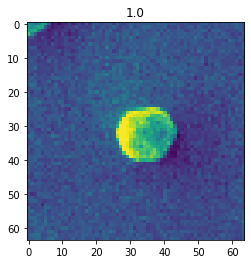

In [6]:
k = 1
plt.imshow(images[k])
plt.title(labels[k]);

Check number of instances of each class in the dataset:

In [7]:
for i in np.unique(labels):
    print("class {}, # of samples {}".format(i, len(images[labels==i])))

class 1.0, # of samples 304
class 2.0, # of samples 93
class 3.0, # of samples 49
class 4.0, # of samples 31
class 5.0, # of samples 10
class 6.0, # of samples 7
class 7.0, # of samples 3
class 8.0, # of samples 1
class 9.0, # of samples 1


Take *n* samples of each class with more than 30 samples (i.e., classes 1, 2, 3, 4) for supervised learning. The rest will be our unsupervised data. 

In [8]:
np.random.seed(42)
X_sup, y_sup = [], []
X_unsup, y_unsup = [], []
for i in range(1, 5):
    labels_i = labels[labels==i].copy()
    images_i = images[labels==i].copy()
    idx = np.random.randint(0, len(images_i), size=15) # this assumes that each class has at least 15 instances!!
    X_sup.append(images_i[idx])
    y_sup.extend([i]*len(images_i[idx]))
    X_unsup.append(np.delete(images_i, idx, 0))
    y_unsup.append(np.delete(labels_i, idx, 0))
X_sup = np.concatenate(X_sup)
y_sup = np.array(y_sup)
X_unsup = np.concatenate(X_unsup)
y_unsup = np.concatenate(y_unsup)

In [9]:
label_array = np.concatenate((y_sup, y_unsup))
print(label_array.shape, labels.shape)
labels2 = label_array

#labels2 = np.argmax(label_array, axis = 1)
#labels2.shape

(481,) (499,)


Preprocess images:

In [10]:
X_sup = torch.from_numpy(X_sup).flatten(start_dim=1).float()
X_unsup = torch.from_numpy(X_unsup).flatten(start_dim=1).float()
X_sup.shape, X_unsup.shape

(torch.Size([60, 4096]), torch.Size([421, 4096]))

Preprocess labels:

In [11]:
n = len(np.unique(y_sup))
y_sup = torch.from_numpy(y_sup - 1).long()
y_unsup = torch.from_numpy(y_unsup - 1).long()

# transform to one-hot representation
y_sup = pv.utils.to_onehot(y_sup, n)
y_unsup = pv.utils.to_onehot(y_unsup, n)
y_sup.shape, y_unsup.shape

(torch.Size([60, 4]), torch.Size([421, 4]))

Initialize dataloaders:

In [12]:
loader_unsup = pv.utils.init_dataloader(X_unsup, batch_size=16)
loader_sup = pv.utils.init_dataloader(X_sup, y_sup, sampler=True, batch_size=16)
loader_val = pv.utils.init_dataloader(X_unsup, y_unsup, batch_size=100)  # here we just use the known classes from the training set as our "validation" 

Train ss-rVAE model:

In [13]:
data_dim = (64, 64)
latent_dim = 2
num_classes = 4 
coord = 3  # coord=0: vanilla VAE, coord=1: rotations only, coord=2: translations only, coord=3: rotations+translations

# Initialize model
ssvae = pv.models.sstrVAE(
    data_dim, latent_dim, num_classes, coord)

# Initialize trainer
trainer = pv.trainers.auxSVItrainer(ssvae, lr=1e-4)

# We're going to ramp-up KL weight from 1 to 2 in the first 30 epochs
kl_scale = torch.linspace(1, 2, 30)
# Train model for n epochs
for e in range(1000):
    sc = kl_scale[e] if e < len(kl_scale) else kl_scale[-1]
    trainer.step(loader_unsup, loader_sup, loader_val,
                 aux_loss_multiplier=30, scale_factor=sc)
    trainer.print_statistics()

Epoch: 1 Training loss: 2833.1447, Test accuracy: 0.6888
Epoch: 2 Training loss: 2819.9277, Test accuracy: 0.5819
Epoch: 3 Training loss: 2785.3629, Test accuracy: 0.1995
Epoch: 4 Training loss: 2772.7008, Test accuracy: 0.1995
Epoch: 5 Training loss: 2771.6588, Test accuracy: 0.5321
Epoch: 6 Training loss: 2768.5656, Test accuracy: 0.2019
Epoch: 7 Training loss: 2766.6770, Test accuracy: 0.6271
Epoch: 8 Training loss: 2765.9205, Test accuracy: 0.1544
Epoch: 9 Training loss: 2764.7590, Test accuracy: 0.5867
Epoch: 10 Training loss: 2763.1849, Test accuracy: 0.0760
Epoch: 11 Training loss: 2764.4262, Test accuracy: 0.7720
Epoch: 12 Training loss: 2761.0527, Test accuracy: 0.7696
Epoch: 13 Training loss: 2762.0659, Test accuracy: 0.7031
Epoch: 14 Training loss: 2761.2543, Test accuracy: 0.8266
Epoch: 15 Training loss: 2761.3104, Test accuracy: 0.5226
Epoch: 16 Training loss: 2758.6600, Test accuracy: 0.5487
Epoch: 17 Training loss: 2759.7960, Test accuracy: 0.7696
Epoch: 18 Training loss

PLot the learned latent manifold:

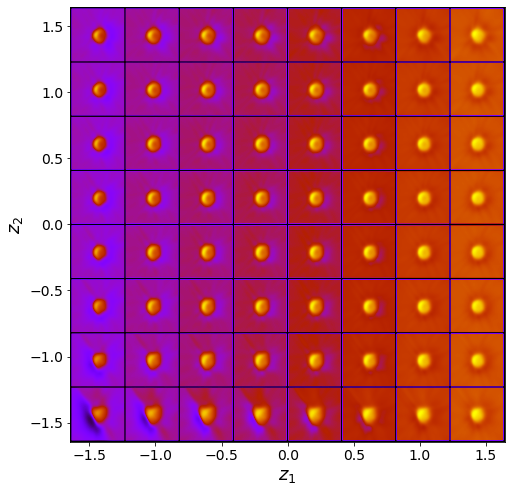

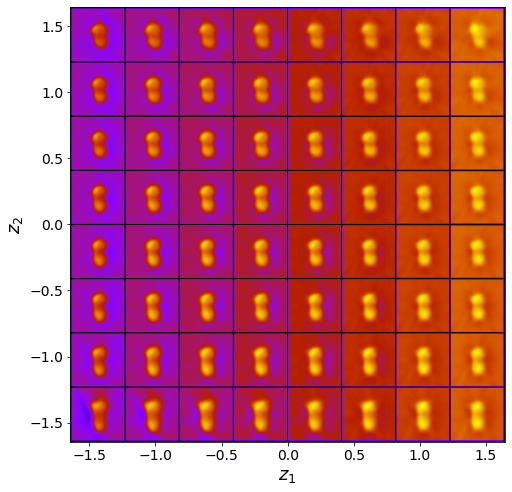

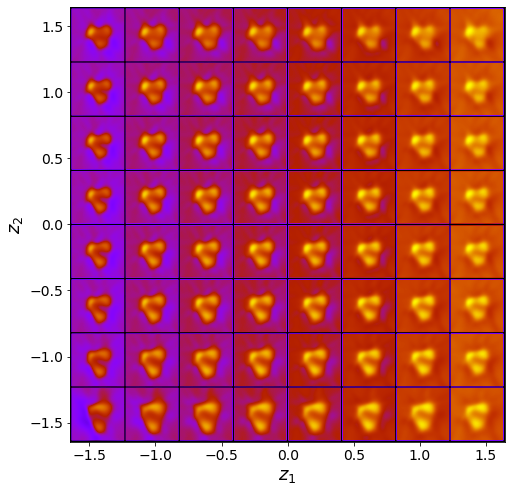

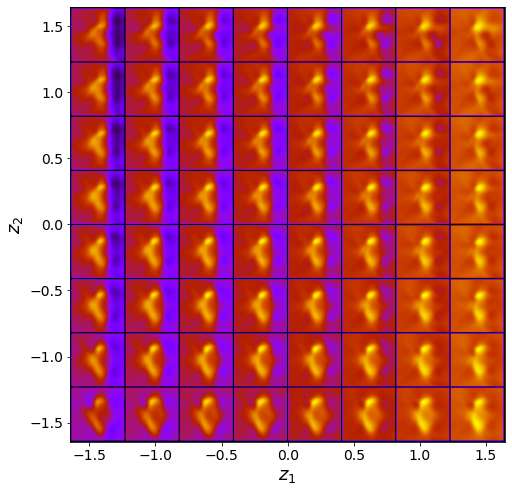

In [14]:
for i in range(4):
    ssvae.manifold2d(8, label=i);

Encode the X_unsup into the latent space:

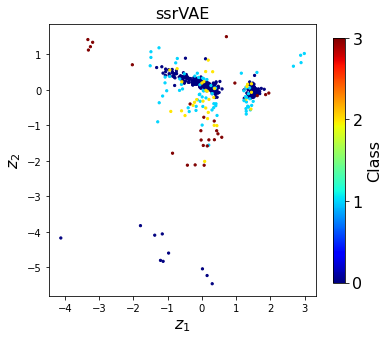

In [15]:
z_mu, _, c = ssvae.encode(X_sup) 

z_mean, z_sd, c = ssvae.encode(X_unsup)
fig, ax1 = plt.subplots( figsize =(6, 5))
im1 = ax1.scatter(z_mean[:,-1], z_mean[:,-2], c=c, s=5, cmap='jet')
ax1.set_xlabel("$z_1$", fontsize=16)
ax1.set_ylabel("$z_2$", fontsize=16)
ax1.set_title('ssrVAE', fontsize = 16)
cbar1 = fig.colorbar(im1, ax=ax1, ticks = [0, 1, 2, 3], shrink=.9)
cbar1.set_label("Class", fontsize=16)
cbar1.ax.tick_params( labelsize=16)

# Simple VAE and rVAE analysis

In [16]:
print(X_sup.shape, X_unsup.shape)
train_data = torch.cat((X_sup, X_unsup), 0)
train_data = torch.reshape(train_data, [-1, 64, 64])
train_data.shape

torch.Size([60, 4096]) torch.Size([421, 4096])


torch.Size([481, 64, 64])

In [17]:
train_loader = pv.utils.init_dataloader(train_data, batch_size=64)

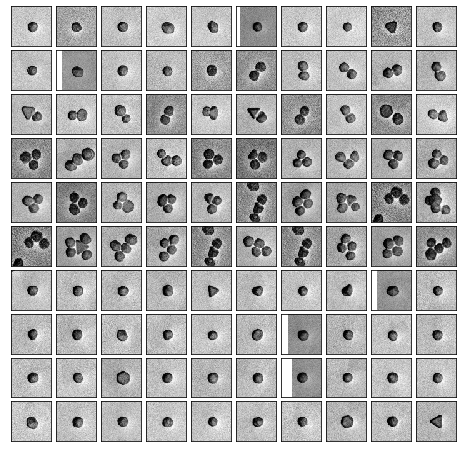

In [18]:
fig, axes = plt.subplots(10, 10, figsize=(8, 8),
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for ax, im in zip(axes.flat, train_data):
    ax.imshow(im.squeeze(), cmap='binary', interpolation='nearest')

Epoch: 1 Training loss: 1122.3021
Epoch: 2 Training loss: 1117.2938
Epoch: 3 Training loss: 1113.5186
Epoch: 4 Training loss: 1110.2607
Epoch: 5 Training loss: 1106.8690
Epoch: 6 Training loss: 1103.5320
Epoch: 7 Training loss: 1099.5950
Epoch: 8 Training loss: 1095.1933
Epoch: 9 Training loss: 1090.2440
Epoch: 10 Training loss: 1085.3082
Epoch: 11 Training loss: 1078.1985
Epoch: 12 Training loss: 1072.7372
Epoch: 13 Training loss: 1062.6249
Epoch: 14 Training loss: 1052.2707
Epoch: 15 Training loss: 1044.9965
Epoch: 16 Training loss: 1034.9001
Epoch: 17 Training loss: 1029.5166
Epoch: 18 Training loss: 1026.4181
Epoch: 19 Training loss: 1023.0232
Epoch: 20 Training loss: 1020.9841
Epoch: 21 Training loss: 1018.8595
Epoch: 22 Training loss: 1016.9914
Epoch: 23 Training loss: 1015.3152
Epoch: 24 Training loss: 1013.0276
Epoch: 25 Training loss: 1011.3881
Epoch: 26 Training loss: 1010.5004
Epoch: 27 Training loss: 1009.0757
Epoch: 28 Training loss: 1008.2959
Epoch: 29 Training loss: 1006

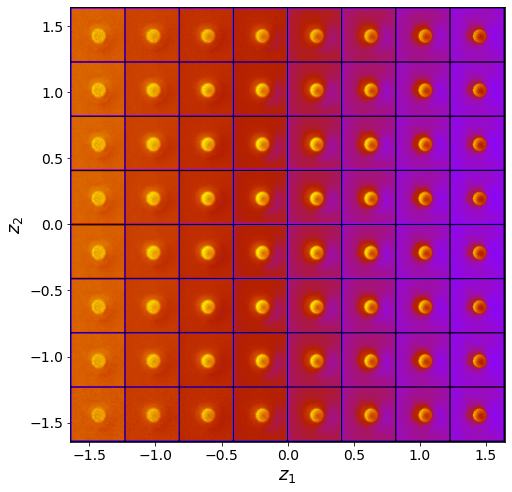

Epoch: 51 Training loss: 999.5194
Epoch: 52 Training loss: 999.3693
Epoch: 53 Training loss: 999.4090
Epoch: 54 Training loss: 999.3506
Epoch: 55 Training loss: 1000.5720
Epoch: 56 Training loss: 999.7826
Epoch: 57 Training loss: 999.3206
Epoch: 58 Training loss: 998.9866
Epoch: 59 Training loss: 998.8103
Epoch: 60 Training loss: 998.6099
Epoch: 61 Training loss: 998.7591
Epoch: 62 Training loss: 998.5384
Epoch: 63 Training loss: 998.5411
Epoch: 64 Training loss: 998.1398
Epoch: 65 Training loss: 998.5956
Epoch: 66 Training loss: 999.0764
Epoch: 67 Training loss: 998.1802
Epoch: 68 Training loss: 998.1885
Epoch: 69 Training loss: 997.9448
Epoch: 70 Training loss: 997.9065
Epoch: 71 Training loss: 998.0904
Epoch: 72 Training loss: 997.8733
Epoch: 73 Training loss: 997.7663
Epoch: 74 Training loss: 997.7626
Epoch: 75 Training loss: 997.6654
Epoch: 76 Training loss: 997.6824
Epoch: 77 Training loss: 997.5000
Epoch: 78 Training loss: 997.4710
Epoch: 79 Training loss: 997.5559
Epoch: 80 Tra

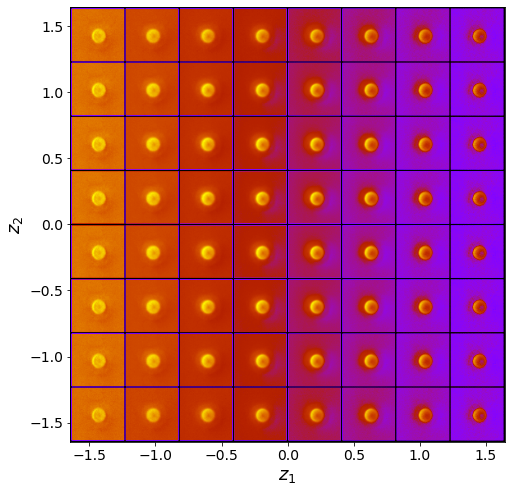

Epoch: 101 Training loss: 997.0584
Epoch: 102 Training loss: 997.4266
Epoch: 103 Training loss: 997.0412
Epoch: 104 Training loss: 996.7460
Epoch: 105 Training loss: 997.0236
Epoch: 106 Training loss: 997.5560
Epoch: 107 Training loss: 996.7927
Epoch: 108 Training loss: 996.6810
Epoch: 109 Training loss: 996.7321
Epoch: 110 Training loss: 997.1846
Epoch: 111 Training loss: 997.8703
Epoch: 112 Training loss: 997.8169
Epoch: 113 Training loss: 997.1795
Epoch: 114 Training loss: 996.9425
Epoch: 115 Training loss: 996.8609
Epoch: 116 Training loss: 997.3365
Epoch: 117 Training loss: 996.6917
Epoch: 118 Training loss: 996.6477
Epoch: 119 Training loss: 996.6685
Epoch: 120 Training loss: 996.6707
Epoch: 121 Training loss: 996.7299
Epoch: 122 Training loss: 996.8380
Epoch: 123 Training loss: 996.9941
Epoch: 124 Training loss: 997.2288
Epoch: 125 Training loss: 996.9885
Epoch: 126 Training loss: 996.5950
Epoch: 127 Training loss: 996.8008
Epoch: 128 Training loss: 996.5162
Epoch: 129 Training 

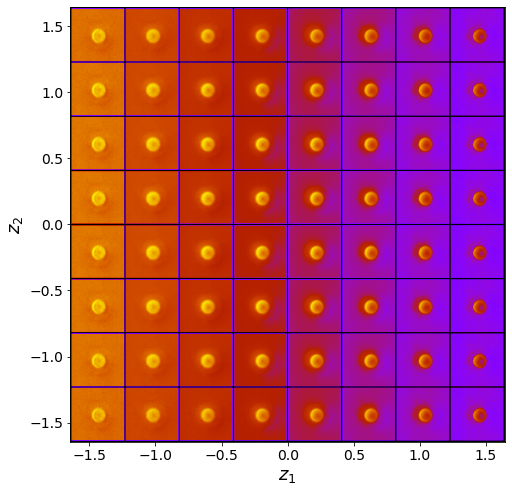

Epoch: 151 Training loss: 997.0256
Epoch: 152 Training loss: 996.3393
Epoch: 153 Training loss: 996.3786
Epoch: 154 Training loss: 996.4492
Epoch: 155 Training loss: 996.6904
Epoch: 156 Training loss: 996.7851
Epoch: 157 Training loss: 996.3203
Epoch: 158 Training loss: 996.2606
Epoch: 159 Training loss: 996.2948
Epoch: 160 Training loss: 996.3914
Epoch: 161 Training loss: 996.2947
Epoch: 162 Training loss: 996.2019
Epoch: 163 Training loss: 996.2902
Epoch: 164 Training loss: 996.2935
Epoch: 165 Training loss: 996.3356
Epoch: 166 Training loss: 996.7150
Epoch: 167 Training loss: 996.6846
Epoch: 168 Training loss: 996.1864
Epoch: 169 Training loss: 996.4905
Epoch: 170 Training loss: 996.5692
Epoch: 171 Training loss: 996.2389
Epoch: 172 Training loss: 996.4182
Epoch: 173 Training loss: 996.2086
Epoch: 174 Training loss: 996.3520
Epoch: 175 Training loss: 996.5357
Epoch: 176 Training loss: 996.5999
Epoch: 177 Training loss: 996.2738
Epoch: 178 Training loss: 996.0944
Epoch: 179 Training 

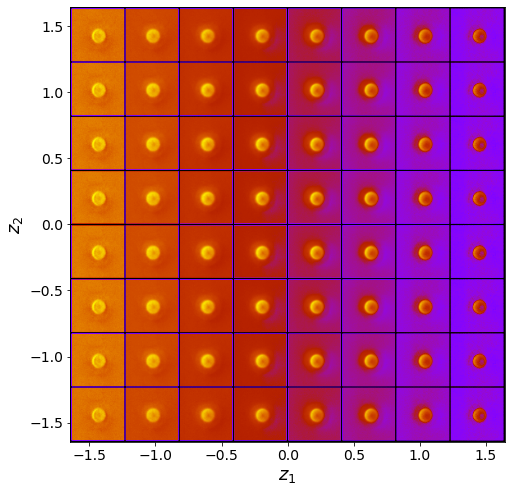

Epoch: 201 Training loss: 996.1131
Epoch: 202 Training loss: 996.2402
Epoch: 203 Training loss: 996.1451
Epoch: 204 Training loss: 996.1995
Epoch: 205 Training loss: 996.0847
Epoch: 206 Training loss: 996.2677
Epoch: 207 Training loss: 996.5961
Epoch: 208 Training loss: 996.3962
Epoch: 209 Training loss: 995.9406
Epoch: 210 Training loss: 995.9105
Epoch: 211 Training loss: 996.0870
Epoch: 212 Training loss: 996.1860
Epoch: 213 Training loss: 996.1290
Epoch: 214 Training loss: 995.8644
Epoch: 215 Training loss: 996.1862
Epoch: 216 Training loss: 996.1302
Epoch: 217 Training loss: 995.9777
Epoch: 218 Training loss: 995.8762
Epoch: 219 Training loss: 995.8264
Epoch: 220 Training loss: 995.8486
Epoch: 221 Training loss: 995.9052
Epoch: 222 Training loss: 996.1350
Epoch: 223 Training loss: 995.9022
Epoch: 224 Training loss: 995.6241
Epoch: 225 Training loss: 995.6214
Epoch: 226 Training loss: 995.6703
Epoch: 227 Training loss: 995.8642
Epoch: 228 Training loss: 995.9321
Epoch: 229 Training 

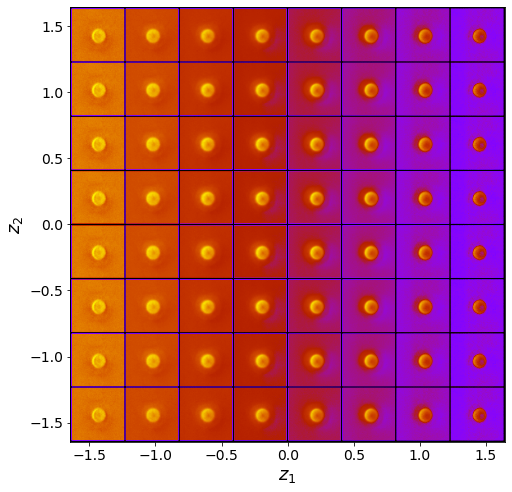

Epoch: 251 Training loss: 995.6517
Epoch: 252 Training loss: 995.4855
Epoch: 253 Training loss: 995.5234
Epoch: 254 Training loss: 995.5402
Epoch: 255 Training loss: 995.8348
Epoch: 256 Training loss: 996.0254
Epoch: 257 Training loss: 995.9320
Epoch: 258 Training loss: 995.5295
Epoch: 259 Training loss: 995.8251
Epoch: 260 Training loss: 995.8473
Epoch: 261 Training loss: 996.0951
Epoch: 262 Training loss: 995.9939
Epoch: 263 Training loss: 995.9433
Epoch: 264 Training loss: 995.5336
Epoch: 265 Training loss: 995.5868
Epoch: 266 Training loss: 995.5224
Epoch: 267 Training loss: 995.4263
Epoch: 268 Training loss: 995.5493
Epoch: 269 Training loss: 995.3861
Epoch: 270 Training loss: 995.4337
Epoch: 271 Training loss: 995.3893
Epoch: 272 Training loss: 995.5973
Epoch: 273 Training loss: 995.5501
Epoch: 274 Training loss: 995.4992
Epoch: 275 Training loss: 995.5529
Epoch: 276 Training loss: 995.5413
Epoch: 277 Training loss: 995.7908
Epoch: 278 Training loss: 995.7449
Epoch: 279 Training 

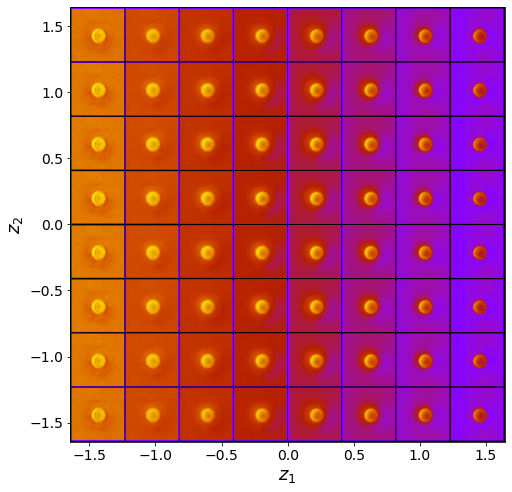

Epoch: 301 Training loss: 995.2403
Epoch: 302 Training loss: 995.1319
Epoch: 303 Training loss: 995.2611
Epoch: 304 Training loss: 995.2325
Epoch: 305 Training loss: 995.3151
Epoch: 306 Training loss: 995.0843
Epoch: 307 Training loss: 995.2354
Epoch: 308 Training loss: 995.5183
Epoch: 309 Training loss: 995.6868
Epoch: 310 Training loss: 995.3814
Epoch: 311 Training loss: 995.2955
Epoch: 312 Training loss: 995.1927
Epoch: 313 Training loss: 995.0565
Epoch: 314 Training loss: 995.1536
Epoch: 315 Training loss: 995.3110
Epoch: 316 Training loss: 995.1652
Epoch: 317 Training loss: 995.0859
Epoch: 318 Training loss: 996.0111
Epoch: 319 Training loss: 997.2236
Epoch: 320 Training loss: 995.9473
Epoch: 321 Training loss: 996.2563
Epoch: 322 Training loss: 995.5271
Epoch: 323 Training loss: 995.9309
Epoch: 324 Training loss: 995.2905
Epoch: 325 Training loss: 995.3697
Epoch: 326 Training loss: 995.2156
Epoch: 327 Training loss: 995.3050
Epoch: 328 Training loss: 995.3017
Epoch: 329 Training 

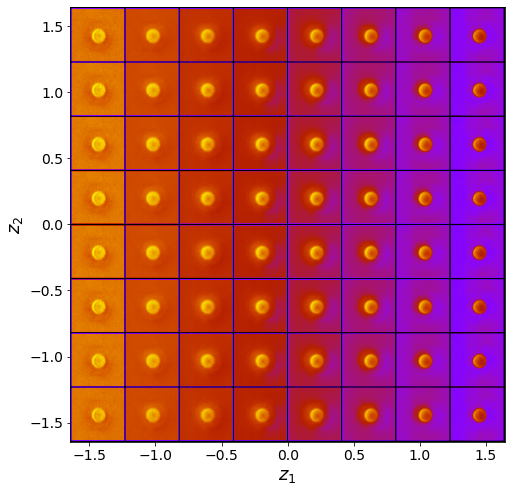

Epoch: 351 Training loss: 994.9018
Epoch: 352 Training loss: 994.9884
Epoch: 353 Training loss: 994.7858
Epoch: 354 Training loss: 995.3238
Epoch: 355 Training loss: 995.1791
Epoch: 356 Training loss: 994.9188
Epoch: 357 Training loss: 995.1735
Epoch: 358 Training loss: 995.6813
Epoch: 359 Training loss: 995.0027
Epoch: 360 Training loss: 994.7722
Epoch: 361 Training loss: 994.8043
Epoch: 362 Training loss: 995.3099
Epoch: 363 Training loss: 995.6666
Epoch: 364 Training loss: 995.4203
Epoch: 365 Training loss: 994.9005
Epoch: 366 Training loss: 994.7999
Epoch: 367 Training loss: 994.6742
Epoch: 368 Training loss: 994.9953
Epoch: 369 Training loss: 994.6784
Epoch: 370 Training loss: 994.7991
Epoch: 371 Training loss: 994.9141
Epoch: 372 Training loss: 994.7886
Epoch: 373 Training loss: 994.7921
Epoch: 374 Training loss: 994.7940
Epoch: 375 Training loss: 994.7263
Epoch: 376 Training loss: 994.6456
Epoch: 377 Training loss: 994.6146
Epoch: 378 Training loss: 994.6422
Epoch: 379 Training 

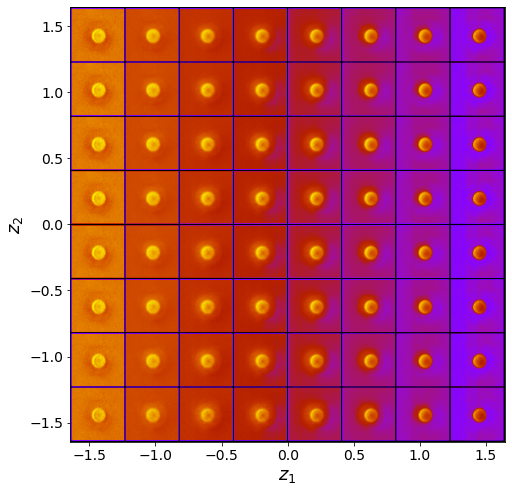

Epoch: 401 Training loss: 994.2257
Epoch: 402 Training loss: 994.1259
Epoch: 403 Training loss: 994.3111
Epoch: 404 Training loss: 994.2344
Epoch: 405 Training loss: 994.2645
Epoch: 406 Training loss: 994.5432
Epoch: 407 Training loss: 996.5015
Epoch: 408 Training loss: 997.7338
Epoch: 409 Training loss: 997.6559
Epoch: 410 Training loss: 994.8547
Epoch: 411 Training loss: 994.6817
Epoch: 412 Training loss: 994.4247
Epoch: 413 Training loss: 993.8092
Epoch: 414 Training loss: 993.7846
Epoch: 415 Training loss: 993.7182
Epoch: 416 Training loss: 993.4959
Epoch: 417 Training loss: 993.7576
Epoch: 418 Training loss: 993.5775
Epoch: 419 Training loss: 993.3913
Epoch: 420 Training loss: 993.7593
Epoch: 421 Training loss: 992.9942
Epoch: 422 Training loss: 992.7696
Epoch: 423 Training loss: 993.3174
Epoch: 424 Training loss: 992.9969
Epoch: 425 Training loss: 991.8424
Epoch: 426 Training loss: 991.4982
Epoch: 427 Training loss: 991.2009
Epoch: 428 Training loss: 990.6550
Epoch: 429 Training 

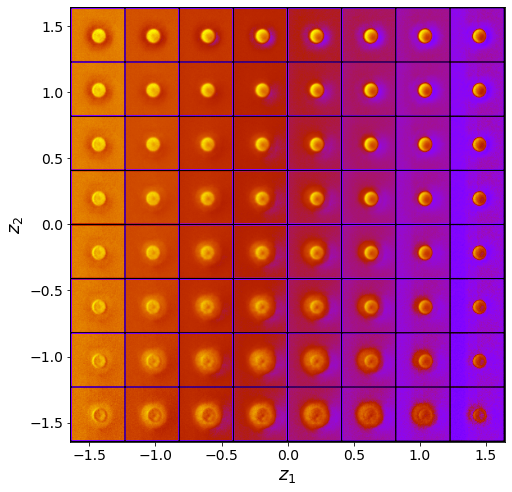

Epoch: 451 Training loss: 987.8669
Epoch: 452 Training loss: 987.8361
Epoch: 453 Training loss: 987.6211
Epoch: 454 Training loss: 987.8476
Epoch: 455 Training loss: 987.7554
Epoch: 456 Training loss: 987.5175
Epoch: 457 Training loss: 987.4546
Epoch: 458 Training loss: 987.4495
Epoch: 459 Training loss: 987.4375
Epoch: 460 Training loss: 987.7057
Epoch: 461 Training loss: 987.9624
Epoch: 462 Training loss: 987.8979
Epoch: 463 Training loss: 987.3743
Epoch: 464 Training loss: 987.2482
Epoch: 465 Training loss: 987.3264
Epoch: 466 Training loss: 987.3211
Epoch: 467 Training loss: 987.4479
Epoch: 468 Training loss: 987.3605
Epoch: 469 Training loss: 987.4758
Epoch: 470 Training loss: 987.3165
Epoch: 471 Training loss: 987.2507
Epoch: 472 Training loss: 987.3329
Epoch: 473 Training loss: 987.5348
Epoch: 474 Training loss: 987.5752
Epoch: 475 Training loss: 987.2679
Epoch: 476 Training loss: 987.2001
Epoch: 477 Training loss: 987.0721
Epoch: 478 Training loss: 987.2105
Epoch: 479 Training 

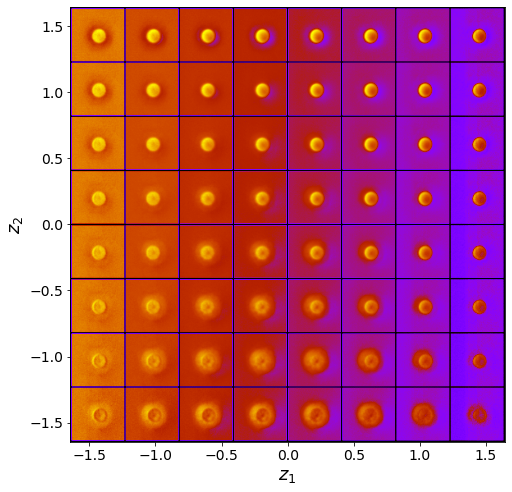

Epoch: 501 Training loss: 987.1523
Epoch: 502 Training loss: 987.6132
Epoch: 503 Training loss: 987.3121
Epoch: 504 Training loss: 986.9636
Epoch: 505 Training loss: 986.7982
Epoch: 506 Training loss: 986.9764
Epoch: 507 Training loss: 986.9309
Epoch: 508 Training loss: 987.2224
Epoch: 509 Training loss: 987.0936
Epoch: 510 Training loss: 987.0974
Epoch: 511 Training loss: 986.9764
Epoch: 512 Training loss: 986.9593
Epoch: 513 Training loss: 986.9634
Epoch: 514 Training loss: 986.9647
Epoch: 515 Training loss: 987.0297
Epoch: 516 Training loss: 987.1688
Epoch: 517 Training loss: 987.2951
Epoch: 518 Training loss: 987.5235
Epoch: 519 Training loss: 987.0921
Epoch: 520 Training loss: 987.2205
Epoch: 521 Training loss: 987.3871
Epoch: 522 Training loss: 986.7575
Epoch: 523 Training loss: 986.8235
Epoch: 524 Training loss: 986.9184
Epoch: 525 Training loss: 986.8709
Epoch: 526 Training loss: 987.0909
Epoch: 527 Training loss: 986.8793
Epoch: 528 Training loss: 986.8950
Epoch: 529 Training 

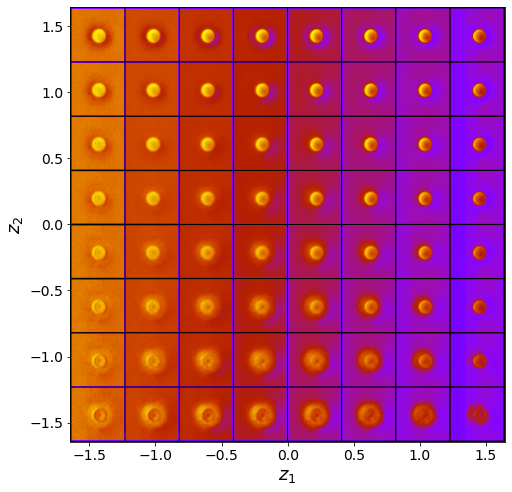

Epoch: 551 Training loss: 987.0670
Epoch: 552 Training loss: 986.7657
Epoch: 553 Training loss: 986.5620
Epoch: 554 Training loss: 986.6011
Epoch: 555 Training loss: 986.5494
Epoch: 556 Training loss: 986.5750
Epoch: 557 Training loss: 986.5493
Epoch: 558 Training loss: 986.6040
Epoch: 559 Training loss: 986.7238
Epoch: 560 Training loss: 986.8922
Epoch: 561 Training loss: 986.7195
Epoch: 562 Training loss: 986.5814
Epoch: 563 Training loss: 986.5267
Epoch: 564 Training loss: 986.5063
Epoch: 565 Training loss: 986.6101
Epoch: 566 Training loss: 986.8104
Epoch: 567 Training loss: 986.7220
Epoch: 568 Training loss: 987.1084
Epoch: 569 Training loss: 986.7374
Epoch: 570 Training loss: 986.8906
Epoch: 571 Training loss: 986.9275
Epoch: 572 Training loss: 986.4949
Epoch: 573 Training loss: 986.6158
Epoch: 574 Training loss: 986.5088
Epoch: 575 Training loss: 986.4591
Epoch: 576 Training loss: 986.5979
Epoch: 577 Training loss: 986.5456
Epoch: 578 Training loss: 986.5779
Epoch: 579 Training 

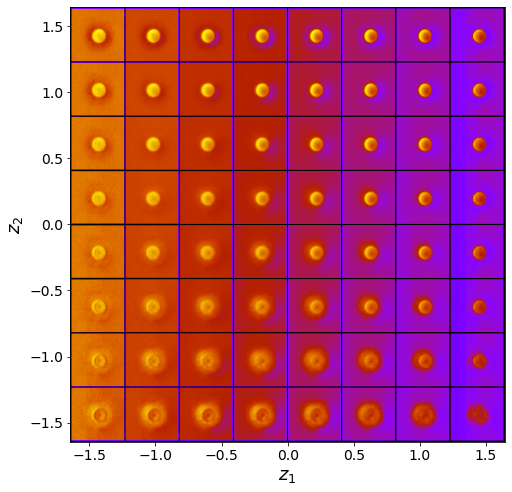

Epoch: 601 Training loss: 986.7766
Epoch: 602 Training loss: 986.7539
Epoch: 603 Training loss: 987.1357
Epoch: 604 Training loss: 986.9136
Epoch: 605 Training loss: 986.4238
Epoch: 606 Training loss: 986.3292
Epoch: 607 Training loss: 986.2981
Epoch: 608 Training loss: 986.2928
Epoch: 609 Training loss: 986.3541
Epoch: 610 Training loss: 986.7880
Epoch: 611 Training loss: 987.3260
Epoch: 612 Training loss: 987.1631
Epoch: 613 Training loss: 986.4829
Epoch: 614 Training loss: 986.6656
Epoch: 615 Training loss: 986.4685
Epoch: 616 Training loss: 986.6741
Epoch: 617 Training loss: 986.4485
Epoch: 618 Training loss: 986.5856
Epoch: 619 Training loss: 986.5399
Epoch: 620 Training loss: 986.5368
Epoch: 621 Training loss: 986.6496
Epoch: 622 Training loss: 986.5193
Epoch: 623 Training loss: 986.4810
Epoch: 624 Training loss: 986.3812
Epoch: 625 Training loss: 986.3276
Epoch: 626 Training loss: 986.2595
Epoch: 627 Training loss: 986.2250
Epoch: 628 Training loss: 986.3299
Epoch: 629 Training 

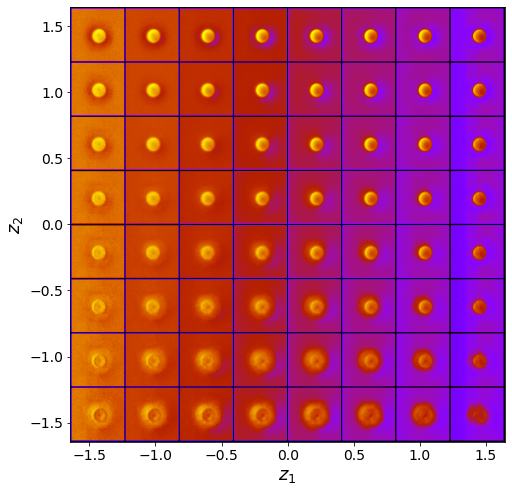

Epoch: 651 Training loss: 986.1173
Epoch: 652 Training loss: 986.2764
Epoch: 653 Training loss: 986.1163
Epoch: 654 Training loss: 986.0462
Epoch: 655 Training loss: 986.1670
Epoch: 656 Training loss: 986.1645
Epoch: 657 Training loss: 986.3018
Epoch: 658 Training loss: 985.9827
Epoch: 659 Training loss: 985.9835
Epoch: 660 Training loss: 986.0224
Epoch: 661 Training loss: 985.8646
Epoch: 662 Training loss: 986.0615
Epoch: 663 Training loss: 986.0381
Epoch: 664 Training loss: 986.1407
Epoch: 665 Training loss: 986.1859
Epoch: 666 Training loss: 985.9814
Epoch: 667 Training loss: 986.0044
Epoch: 668 Training loss: 985.9051
Epoch: 669 Training loss: 985.9004
Epoch: 670 Training loss: 985.9456
Epoch: 671 Training loss: 986.0280
Epoch: 672 Training loss: 985.9808
Epoch: 673 Training loss: 986.1193
Epoch: 674 Training loss: 986.0171
Epoch: 675 Training loss: 985.9920
Epoch: 676 Training loss: 985.8567
Epoch: 677 Training loss: 986.0448
Epoch: 678 Training loss: 985.9344
Epoch: 679 Training 

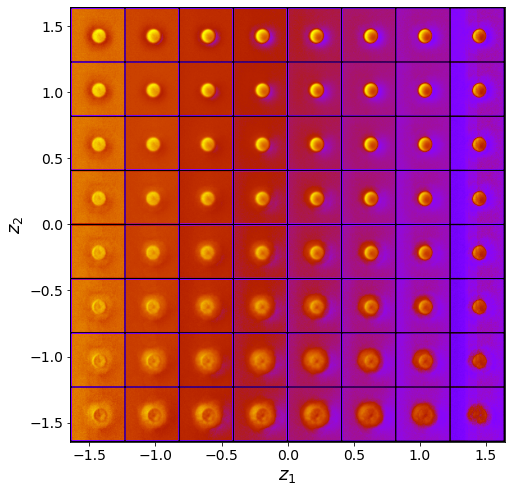

Epoch: 701 Training loss: 986.2676
Epoch: 702 Training loss: 986.2108
Epoch: 703 Training loss: 986.3405
Epoch: 704 Training loss: 985.8239
Epoch: 705 Training loss: 985.8094
Epoch: 706 Training loss: 985.8071
Epoch: 707 Training loss: 985.8705
Epoch: 708 Training loss: 985.7682
Epoch: 709 Training loss: 985.8960
Epoch: 710 Training loss: 986.0130
Epoch: 711 Training loss: 985.9071
Epoch: 712 Training loss: 985.8615
Epoch: 713 Training loss: 985.7367
Epoch: 714 Training loss: 985.7738
Epoch: 715 Training loss: 986.0400
Epoch: 716 Training loss: 985.9528
Epoch: 717 Training loss: 985.6833
Epoch: 718 Training loss: 985.6197
Epoch: 719 Training loss: 985.6624
Epoch: 720 Training loss: 985.6572
Epoch: 721 Training loss: 986.0080
Epoch: 722 Training loss: 985.8280
Epoch: 723 Training loss: 985.7286
Epoch: 724 Training loss: 985.6490
Epoch: 725 Training loss: 985.7168
Epoch: 726 Training loss: 985.7493
Epoch: 727 Training loss: 985.8783
Epoch: 728 Training loss: 985.5089
Epoch: 729 Training 

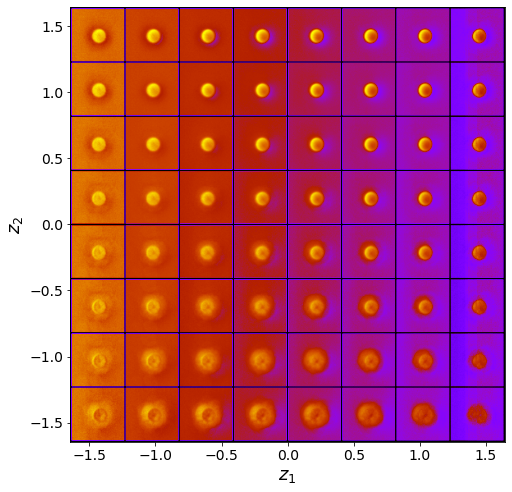

Epoch: 751 Training loss: 985.4801
Epoch: 752 Training loss: 985.3422
Epoch: 753 Training loss: 985.3267
Epoch: 754 Training loss: 985.6005
Epoch: 755 Training loss: 985.9754
Epoch: 756 Training loss: 986.0563
Epoch: 757 Training loss: 985.8891
Epoch: 758 Training loss: 985.9638
Epoch: 759 Training loss: 985.7930
Epoch: 760 Training loss: 985.6432
Epoch: 761 Training loss: 985.6383
Epoch: 762 Training loss: 985.5262
Epoch: 763 Training loss: 985.5145
Epoch: 764 Training loss: 985.7887
Epoch: 765 Training loss: 986.4148
Epoch: 766 Training loss: 987.0520
Epoch: 767 Training loss: 985.8875
Epoch: 768 Training loss: 985.3533
Epoch: 769 Training loss: 985.4289
Epoch: 770 Training loss: 985.3024
Epoch: 771 Training loss: 985.4028
Epoch: 772 Training loss: 985.6061
Epoch: 773 Training loss: 985.4751
Epoch: 774 Training loss: 985.4295
Epoch: 775 Training loss: 985.2251
Epoch: 776 Training loss: 985.3004
Epoch: 777 Training loss: 985.7001
Epoch: 778 Training loss: 985.4056
Epoch: 779 Training 

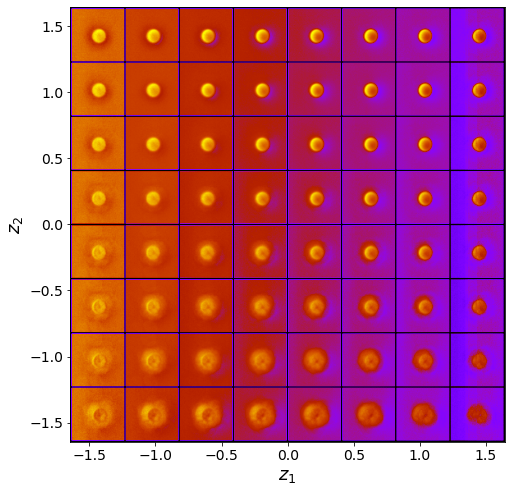

Epoch: 801 Training loss: 985.0945
Epoch: 802 Training loss: 985.1803
Epoch: 803 Training loss: 985.2736
Epoch: 804 Training loss: 985.1223
Epoch: 805 Training loss: 985.0645
Epoch: 806 Training loss: 985.0355
Epoch: 807 Training loss: 985.0111
Epoch: 808 Training loss: 984.9170
Epoch: 809 Training loss: 984.9539
Epoch: 810 Training loss: 984.9229
Epoch: 811 Training loss: 985.0089
Epoch: 812 Training loss: 984.9582
Epoch: 813 Training loss: 984.9995
Epoch: 814 Training loss: 985.0100
Epoch: 815 Training loss: 985.0192
Epoch: 816 Training loss: 984.9434
Epoch: 817 Training loss: 984.9969
Epoch: 818 Training loss: 984.8505
Epoch: 819 Training loss: 985.7218
Epoch: 820 Training loss: 987.3384
Epoch: 821 Training loss: 987.9136
Epoch: 822 Training loss: 985.2152
Epoch: 823 Training loss: 985.0105
Epoch: 824 Training loss: 984.9450
Epoch: 825 Training loss: 984.9734
Epoch: 826 Training loss: 984.9568
Epoch: 827 Training loss: 985.0869
Epoch: 828 Training loss: 985.0391
Epoch: 829 Training 

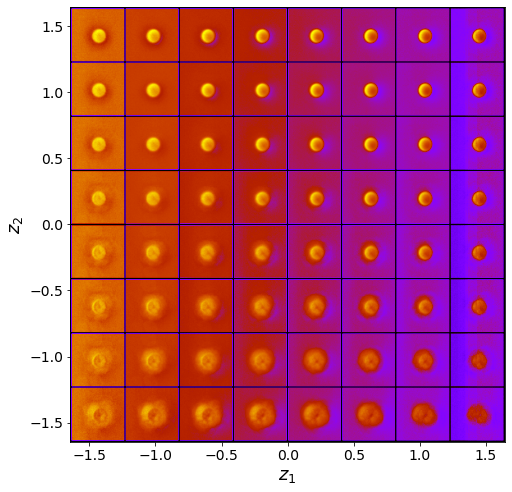

Epoch: 851 Training loss: 984.6434
Epoch: 852 Training loss: 984.7825
Epoch: 853 Training loss: 984.7558
Epoch: 854 Training loss: 984.9743
Epoch: 855 Training loss: 985.1295
Epoch: 856 Training loss: 984.7301
Epoch: 857 Training loss: 984.8327
Epoch: 858 Training loss: 984.6968
Epoch: 859 Training loss: 984.9095
Epoch: 860 Training loss: 984.5664
Epoch: 861 Training loss: 984.6977
Epoch: 862 Training loss: 984.6277
Epoch: 863 Training loss: 984.5520
Epoch: 864 Training loss: 984.6105
Epoch: 865 Training loss: 984.6406
Epoch: 866 Training loss: 984.9532
Epoch: 867 Training loss: 984.9989
Epoch: 868 Training loss: 984.5975
Epoch: 869 Training loss: 984.5864
Epoch: 870 Training loss: 984.6225
Epoch: 871 Training loss: 984.6727
Epoch: 872 Training loss: 985.0397
Epoch: 873 Training loss: 985.3043
Epoch: 874 Training loss: 985.1675
Epoch: 875 Training loss: 984.9805
Epoch: 876 Training loss: 984.7839
Epoch: 877 Training loss: 984.5494
Epoch: 878 Training loss: 984.5067
Epoch: 879 Training 

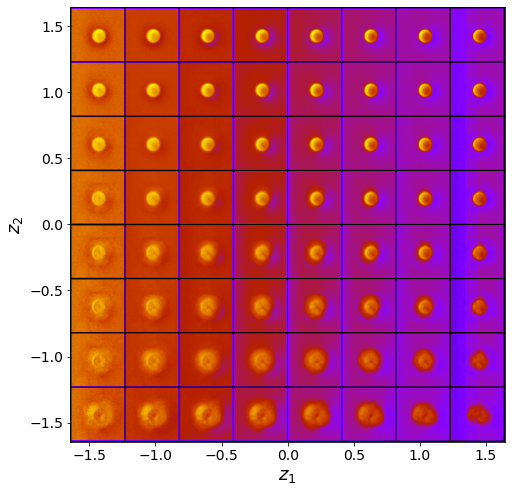

Epoch: 901 Training loss: 984.6425
Epoch: 902 Training loss: 984.6523
Epoch: 903 Training loss: 984.4204
Epoch: 904 Training loss: 984.3933
Epoch: 905 Training loss: 984.3465
Epoch: 906 Training loss: 984.4672
Epoch: 907 Training loss: 984.4642
Epoch: 908 Training loss: 984.3172
Epoch: 909 Training loss: 984.4359
Epoch: 910 Training loss: 984.4253
Epoch: 911 Training loss: 984.4380
Epoch: 912 Training loss: 984.6024
Epoch: 913 Training loss: 984.5237
Epoch: 914 Training loss: 984.4265
Epoch: 915 Training loss: 984.4265
Epoch: 916 Training loss: 985.1121
Epoch: 917 Training loss: 985.0884
Epoch: 918 Training loss: 984.4377
Epoch: 919 Training loss: 984.2089
Epoch: 920 Training loss: 984.3877
Epoch: 921 Training loss: 984.2377
Epoch: 922 Training loss: 984.4818
Epoch: 923 Training loss: 984.5324
Epoch: 924 Training loss: 984.6922
Epoch: 925 Training loss: 984.3363
Epoch: 926 Training loss: 984.1686
Epoch: 927 Training loss: 984.3755
Epoch: 928 Training loss: 984.4016
Epoch: 929 Training 

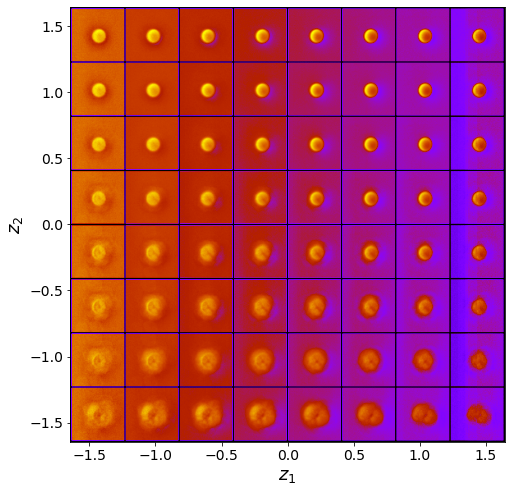

Epoch: 951 Training loss: 985.2448
Epoch: 952 Training loss: 984.3441
Epoch: 953 Training loss: 984.0797
Epoch: 954 Training loss: 983.9094
Epoch: 955 Training loss: 984.0381
Epoch: 956 Training loss: 984.0401
Epoch: 957 Training loss: 984.0542
Epoch: 958 Training loss: 983.9771
Epoch: 959 Training loss: 984.0550
Epoch: 960 Training loss: 984.0259
Epoch: 961 Training loss: 984.0367
Epoch: 962 Training loss: 984.0540
Epoch: 963 Training loss: 984.1828
Epoch: 964 Training loss: 983.9808
Epoch: 965 Training loss: 983.9785
Epoch: 966 Training loss: 983.9705
Epoch: 967 Training loss: 984.0391
Epoch: 968 Training loss: 984.5594
Epoch: 969 Training loss: 984.3060
Epoch: 970 Training loss: 983.9711
Epoch: 971 Training loss: 984.1173
Epoch: 972 Training loss: 984.1012
Epoch: 973 Training loss: 984.0022
Epoch: 974 Training loss: 983.9266
Epoch: 975 Training loss: 984.0087
Epoch: 976 Training loss: 983.9564
Epoch: 977 Training loss: 983.8960
Epoch: 978 Training loss: 983.8751
Epoch: 979 Training 

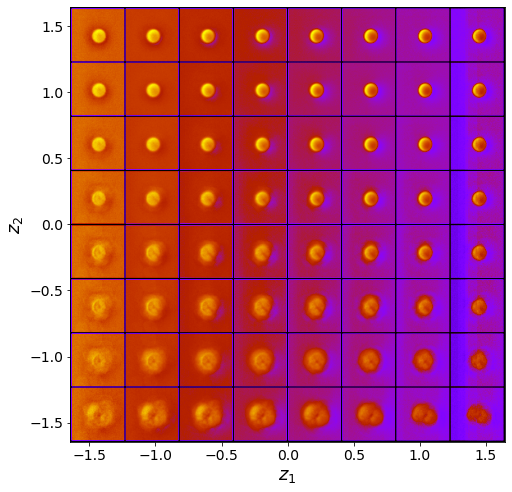

Epoch: 1001 Training loss: 983.7335
Epoch: 1002 Training loss: 983.6245
Epoch: 1003 Training loss: 983.7556
Epoch: 1004 Training loss: 983.7491
Epoch: 1005 Training loss: 983.7944
Epoch: 1006 Training loss: 983.8296
Epoch: 1007 Training loss: 983.7290
Epoch: 1008 Training loss: 983.8454
Epoch: 1009 Training loss: 983.6974
Epoch: 1010 Training loss: 983.8965
Epoch: 1011 Training loss: 984.5534
Epoch: 1012 Training loss: 985.3900
Epoch: 1013 Training loss: 984.4968
Epoch: 1014 Training loss: 983.9128
Epoch: 1015 Training loss: 983.8522
Epoch: 1016 Training loss: 983.6249
Epoch: 1017 Training loss: 983.8016
Epoch: 1018 Training loss: 983.7082
Epoch: 1019 Training loss: 983.5418
Epoch: 1020 Training loss: 983.5645
Epoch: 1021 Training loss: 983.6776
Epoch: 1022 Training loss: 983.5550
Epoch: 1023 Training loss: 983.6103
Epoch: 1024 Training loss: 983.6052
Epoch: 1025 Training loss: 983.8589
Epoch: 1026 Training loss: 984.0986
Epoch: 1027 Training loss: 983.4878
Epoch: 1028 Training loss: 9

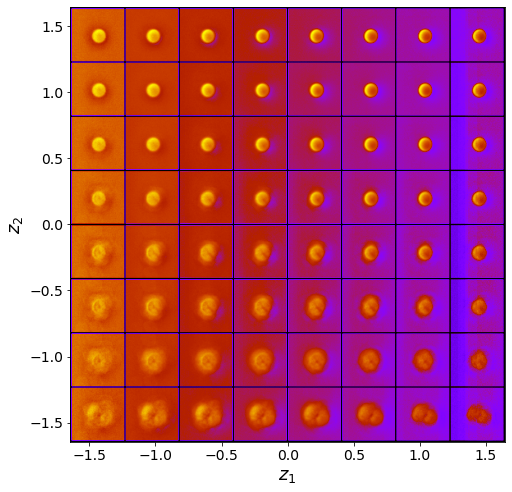

Epoch: 1051 Training loss: 983.4653
Epoch: 1052 Training loss: 983.3665
Epoch: 1053 Training loss: 983.3697
Epoch: 1054 Training loss: 983.4725
Epoch: 1055 Training loss: 983.6059
Epoch: 1056 Training loss: 983.9729
Epoch: 1057 Training loss: 983.6619
Epoch: 1058 Training loss: 983.4269
Epoch: 1059 Training loss: 983.5215
Epoch: 1060 Training loss: 983.5224
Epoch: 1061 Training loss: 983.5696
Epoch: 1062 Training loss: 983.2706
Epoch: 1063 Training loss: 983.5373
Epoch: 1064 Training loss: 983.9345
Epoch: 1065 Training loss: 983.6797
Epoch: 1066 Training loss: 983.7041
Epoch: 1067 Training loss: 983.7384
Epoch: 1068 Training loss: 983.4301
Epoch: 1069 Training loss: 983.3206
Epoch: 1070 Training loss: 983.4105
Epoch: 1071 Training loss: 983.5959
Epoch: 1072 Training loss: 983.5060
Epoch: 1073 Training loss: 983.3794
Epoch: 1074 Training loss: 983.2695
Epoch: 1075 Training loss: 983.2924
Epoch: 1076 Training loss: 983.4749
Epoch: 1077 Training loss: 983.8611
Epoch: 1078 Training loss: 9

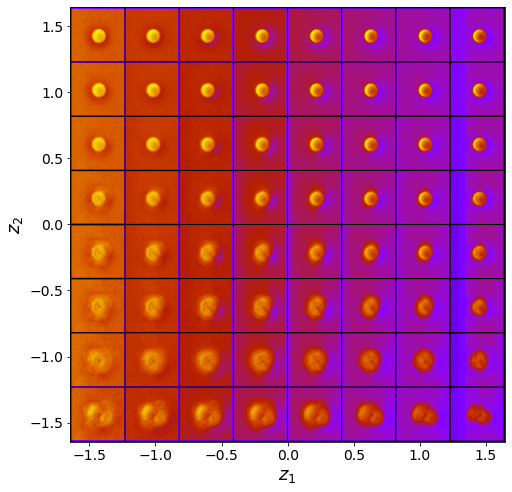

Epoch: 1101 Training loss: 983.1076
Epoch: 1102 Training loss: 983.0186
Epoch: 1103 Training loss: 983.2357
Epoch: 1104 Training loss: 983.1768
Epoch: 1105 Training loss: 983.2385
Epoch: 1106 Training loss: 983.6587
Epoch: 1107 Training loss: 983.1192
Epoch: 1108 Training loss: 983.1283
Epoch: 1109 Training loss: 983.1513
Epoch: 1110 Training loss: 983.1777
Epoch: 1111 Training loss: 983.0410
Epoch: 1112 Training loss: 983.1022
Epoch: 1113 Training loss: 983.3710
Epoch: 1114 Training loss: 983.0822
Epoch: 1115 Training loss: 983.1435
Epoch: 1116 Training loss: 983.3450
Epoch: 1117 Training loss: 983.1429
Epoch: 1118 Training loss: 983.1233
Epoch: 1119 Training loss: 983.0882
Epoch: 1120 Training loss: 983.1135
Epoch: 1121 Training loss: 983.1502
Epoch: 1122 Training loss: 983.0285
Epoch: 1123 Training loss: 983.1916
Epoch: 1124 Training loss: 983.4083
Epoch: 1125 Training loss: 983.3342
Epoch: 1126 Training loss: 983.4099
Epoch: 1127 Training loss: 983.2500
Epoch: 1128 Training loss: 9

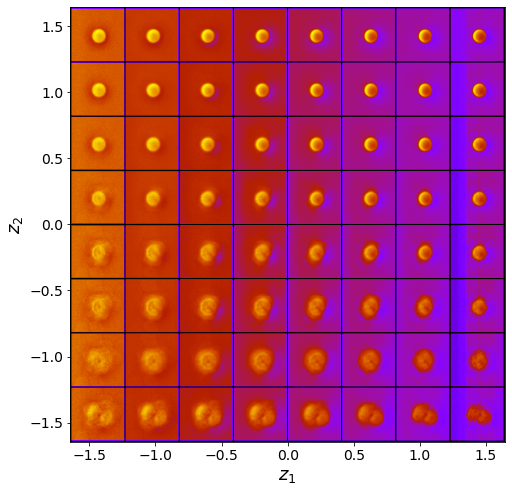

Epoch: 1151 Training loss: 982.8797
Epoch: 1152 Training loss: 983.2581
Epoch: 1153 Training loss: 983.4823
Epoch: 1154 Training loss: 983.8448
Epoch: 1155 Training loss: 983.0235
Epoch: 1156 Training loss: 982.8741
Epoch: 1157 Training loss: 982.8694
Epoch: 1158 Training loss: 982.7418
Epoch: 1159 Training loss: 982.9009
Epoch: 1160 Training loss: 982.7675
Epoch: 1161 Training loss: 982.9116
Epoch: 1162 Training loss: 982.7039
Epoch: 1163 Training loss: 982.7463
Epoch: 1164 Training loss: 982.8405
Epoch: 1165 Training loss: 982.7277
Epoch: 1166 Training loss: 982.8343
Epoch: 1167 Training loss: 983.1857
Epoch: 1168 Training loss: 982.9921
Epoch: 1169 Training loss: 982.8936
Epoch: 1170 Training loss: 982.9156
Epoch: 1171 Training loss: 982.8353
Epoch: 1172 Training loss: 982.6473
Epoch: 1173 Training loss: 982.7023
Epoch: 1174 Training loss: 982.7434
Epoch: 1175 Training loss: 982.8557
Epoch: 1176 Training loss: 982.9468
Epoch: 1177 Training loss: 982.9975
Epoch: 1178 Training loss: 9

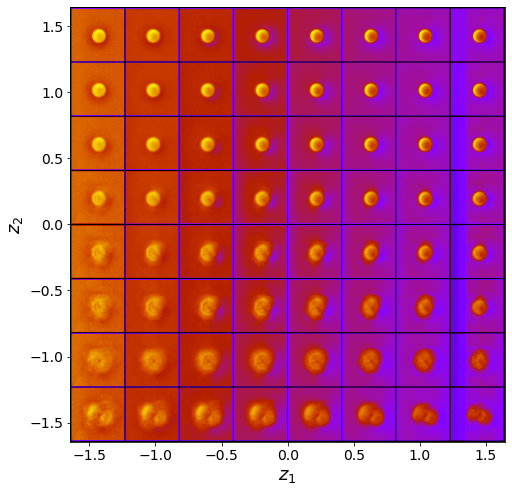

Epoch: 1201 Training loss: 982.7288
Epoch: 1202 Training loss: 982.5582
Epoch: 1203 Training loss: 982.5436
Epoch: 1204 Training loss: 982.7739
Epoch: 1205 Training loss: 982.6095
Epoch: 1206 Training loss: 982.7728
Epoch: 1207 Training loss: 982.6256
Epoch: 1208 Training loss: 982.4757
Epoch: 1209 Training loss: 982.5476
Epoch: 1210 Training loss: 982.7138
Epoch: 1211 Training loss: 982.6971
Epoch: 1212 Training loss: 982.5189
Epoch: 1213 Training loss: 982.6009
Epoch: 1214 Training loss: 983.0658
Epoch: 1215 Training loss: 983.1184
Epoch: 1216 Training loss: 982.6623
Epoch: 1217 Training loss: 982.5068
Epoch: 1218 Training loss: 982.4992
Epoch: 1219 Training loss: 982.5274
Epoch: 1220 Training loss: 982.8029
Epoch: 1221 Training loss: 982.9414
Epoch: 1222 Training loss: 983.1391
Epoch: 1223 Training loss: 982.9895
Epoch: 1224 Training loss: 982.6672
Epoch: 1225 Training loss: 982.5677
Epoch: 1226 Training loss: 982.3659
Epoch: 1227 Training loss: 982.6815
Epoch: 1228 Training loss: 9

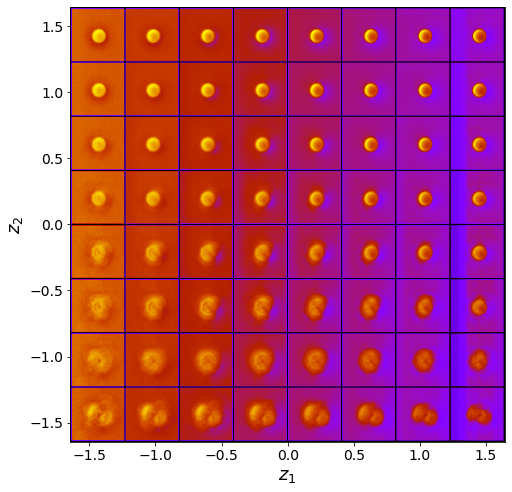

Epoch: 1251 Training loss: 982.5633
Epoch: 1252 Training loss: 982.5819
Epoch: 1253 Training loss: 982.4371
Epoch: 1254 Training loss: 982.5801
Epoch: 1255 Training loss: 982.6906
Epoch: 1256 Training loss: 982.5711
Epoch: 1257 Training loss: 982.4183
Epoch: 1258 Training loss: 982.3749
Epoch: 1259 Training loss: 982.4408
Epoch: 1260 Training loss: 982.1849
Epoch: 1261 Training loss: 982.1447
Epoch: 1262 Training loss: 982.1932
Epoch: 1263 Training loss: 982.1740
Epoch: 1264 Training loss: 982.1420
Epoch: 1265 Training loss: 982.1651
Epoch: 1266 Training loss: 982.2307
Epoch: 1267 Training loss: 982.2778
Epoch: 1268 Training loss: 982.1465
Epoch: 1269 Training loss: 982.2057
Epoch: 1270 Training loss: 982.3550
Epoch: 1271 Training loss: 982.2944
Epoch: 1272 Training loss: 982.2188
Epoch: 1273 Training loss: 982.2571
Epoch: 1274 Training loss: 982.2060
Epoch: 1275 Training loss: 982.1214
Epoch: 1276 Training loss: 982.2514
Epoch: 1277 Training loss: 982.4837
Epoch: 1278 Training loss: 9

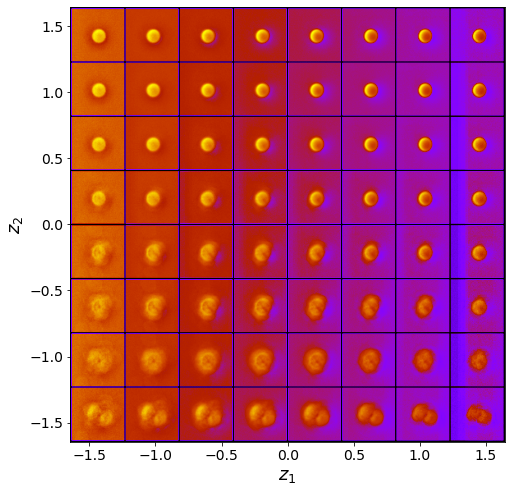

Epoch: 1301 Training loss: 982.1601
Epoch: 1302 Training loss: 982.0544
Epoch: 1303 Training loss: 982.0209
Epoch: 1304 Training loss: 982.3514
Epoch: 1305 Training loss: 982.4359
Epoch: 1306 Training loss: 983.5329
Epoch: 1307 Training loss: 982.5847
Epoch: 1308 Training loss: 982.7133
Epoch: 1309 Training loss: 982.7109
Epoch: 1310 Training loss: 982.0423
Epoch: 1311 Training loss: 981.8878
Epoch: 1312 Training loss: 982.0339
Epoch: 1313 Training loss: 982.0095
Epoch: 1314 Training loss: 982.2084
Epoch: 1315 Training loss: 982.8168
Epoch: 1316 Training loss: 982.4752
Epoch: 1317 Training loss: 982.2540
Epoch: 1318 Training loss: 981.9877
Epoch: 1319 Training loss: 982.2924
Epoch: 1320 Training loss: 981.9300
Epoch: 1321 Training loss: 981.8261
Epoch: 1322 Training loss: 981.8585
Epoch: 1323 Training loss: 982.0420
Epoch: 1324 Training loss: 981.8698
Epoch: 1325 Training loss: 982.0075
Epoch: 1326 Training loss: 982.0664
Epoch: 1327 Training loss: 982.0607
Epoch: 1328 Training loss: 9

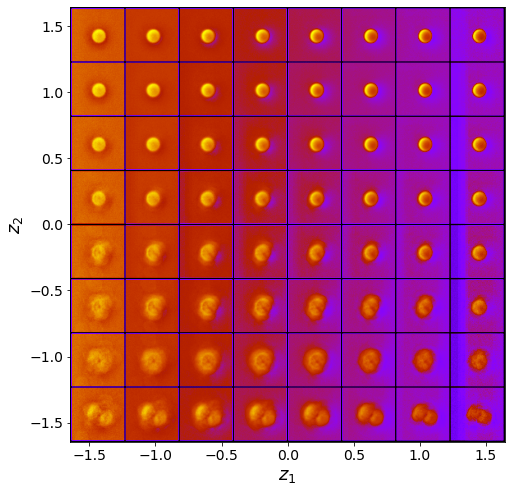

Epoch: 1351 Training loss: 981.6528
Epoch: 1352 Training loss: 981.7254
Epoch: 1353 Training loss: 981.7518
Epoch: 1354 Training loss: 981.7929
Epoch: 1355 Training loss: 981.6904
Epoch: 1356 Training loss: 981.7844
Epoch: 1357 Training loss: 981.7776
Epoch: 1358 Training loss: 981.7817
Epoch: 1359 Training loss: 981.9423
Epoch: 1360 Training loss: 981.6554
Epoch: 1361 Training loss: 981.7362
Epoch: 1362 Training loss: 982.1089
Epoch: 1363 Training loss: 981.7722
Epoch: 1364 Training loss: 981.7881
Epoch: 1365 Training loss: 981.6166
Epoch: 1366 Training loss: 981.6401
Epoch: 1367 Training loss: 981.6746
Epoch: 1368 Training loss: 981.8618
Epoch: 1369 Training loss: 981.9832
Epoch: 1370 Training loss: 982.2046
Epoch: 1371 Training loss: 982.2372
Epoch: 1372 Training loss: 982.0572
Epoch: 1373 Training loss: 981.7839
Epoch: 1374 Training loss: 981.7677
Epoch: 1375 Training loss: 981.7341
Epoch: 1376 Training loss: 981.7894
Epoch: 1377 Training loss: 981.5628
Epoch: 1378 Training loss: 9

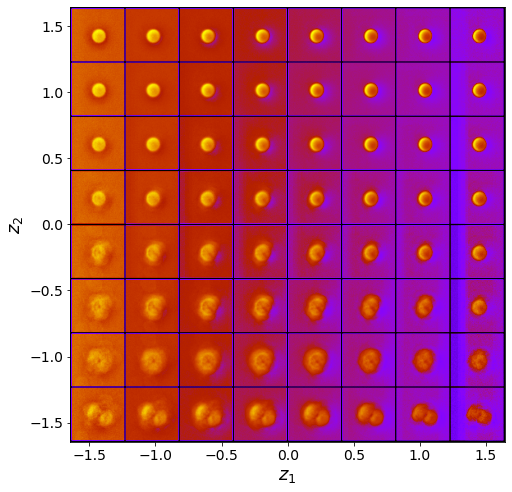

Epoch: 1401 Training loss: 981.4612
Epoch: 1402 Training loss: 981.6478
Epoch: 1403 Training loss: 981.5308
Epoch: 1404 Training loss: 981.2914
Epoch: 1405 Training loss: 981.5586
Epoch: 1406 Training loss: 981.4975
Epoch: 1407 Training loss: 981.6703
Epoch: 1408 Training loss: 981.5391
Epoch: 1409 Training loss: 981.5249
Epoch: 1410 Training loss: 981.4256
Epoch: 1411 Training loss: 981.4388
Epoch: 1412 Training loss: 981.3572
Epoch: 1413 Training loss: 981.7511
Epoch: 1414 Training loss: 982.2499
Epoch: 1415 Training loss: 981.7169
Epoch: 1416 Training loss: 982.0211
Epoch: 1417 Training loss: 981.5443
Epoch: 1418 Training loss: 981.4339
Epoch: 1419 Training loss: 981.4436
Epoch: 1420 Training loss: 981.5290
Epoch: 1421 Training loss: 981.3301
Epoch: 1422 Training loss: 981.3297
Epoch: 1423 Training loss: 981.1771
Epoch: 1424 Training loss: 981.2069
Epoch: 1425 Training loss: 981.3016
Epoch: 1426 Training loss: 981.4527
Epoch: 1427 Training loss: 981.8372
Epoch: 1428 Training loss: 9

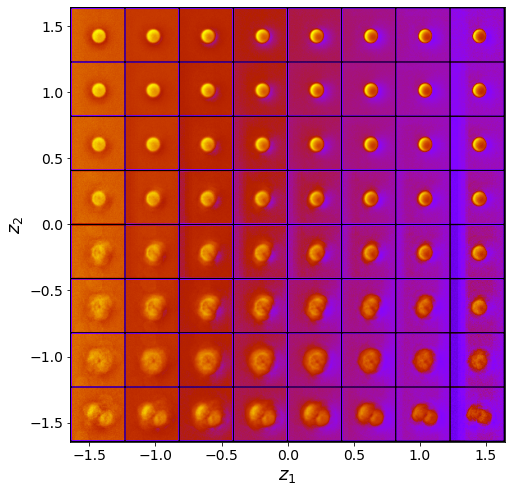

Epoch: 1451 Training loss: 981.2680
Epoch: 1452 Training loss: 981.4422
Epoch: 1453 Training loss: 981.3557
Epoch: 1454 Training loss: 981.3502
Epoch: 1455 Training loss: 981.2983
Epoch: 1456 Training loss: 981.2163
Epoch: 1457 Training loss: 981.2354
Epoch: 1458 Training loss: 981.2962
Epoch: 1459 Training loss: 981.4234
Epoch: 1460 Training loss: 982.0357
Epoch: 1461 Training loss: 981.6116
Epoch: 1462 Training loss: 981.2632
Epoch: 1463 Training loss: 981.3099
Epoch: 1464 Training loss: 981.3479
Epoch: 1465 Training loss: 981.0975
Epoch: 1466 Training loss: 981.0846
Epoch: 1467 Training loss: 981.5868
Epoch: 1468 Training loss: 981.5518
Epoch: 1469 Training loss: 981.5054
Epoch: 1470 Training loss: 981.0583
Epoch: 1471 Training loss: 981.0335
Epoch: 1472 Training loss: 981.0047
Epoch: 1473 Training loss: 981.2285
Epoch: 1474 Training loss: 981.1041
Epoch: 1475 Training loss: 980.9686
Epoch: 1476 Training loss: 981.0979
Epoch: 1477 Training loss: 980.9587
Epoch: 1478 Training loss: 9

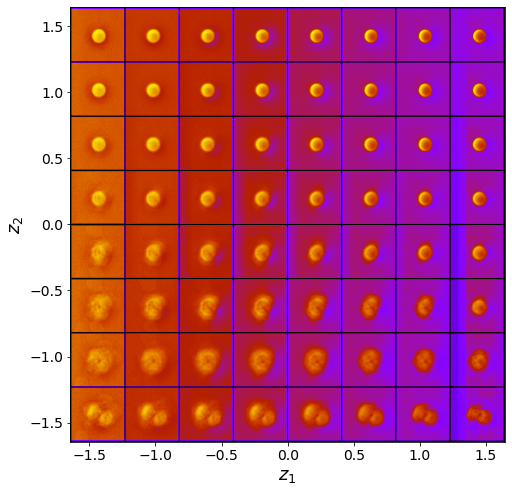

Epoch: 1501 Training loss: 980.8866
Epoch: 1502 Training loss: 980.8328
Epoch: 1503 Training loss: 980.9029
Epoch: 1504 Training loss: 980.8596
Epoch: 1505 Training loss: 980.8736
Epoch: 1506 Training loss: 981.0203
Epoch: 1507 Training loss: 981.0788
Epoch: 1508 Training loss: 980.7873
Epoch: 1509 Training loss: 981.0336
Epoch: 1510 Training loss: 980.9889
Epoch: 1511 Training loss: 981.0253
Epoch: 1512 Training loss: 981.2332
Epoch: 1513 Training loss: 981.5604
Epoch: 1514 Training loss: 981.3828
Epoch: 1515 Training loss: 981.7668
Epoch: 1516 Training loss: 980.9364
Epoch: 1517 Training loss: 981.3416
Epoch: 1518 Training loss: 981.1197
Epoch: 1519 Training loss: 980.9809
Epoch: 1520 Training loss: 980.8985
Epoch: 1521 Training loss: 980.7953
Epoch: 1522 Training loss: 980.7431
Epoch: 1523 Training loss: 980.8869
Epoch: 1524 Training loss: 980.7406
Epoch: 1525 Training loss: 980.7340
Epoch: 1526 Training loss: 980.9087
Epoch: 1527 Training loss: 980.7927
Epoch: 1528 Training loss: 9

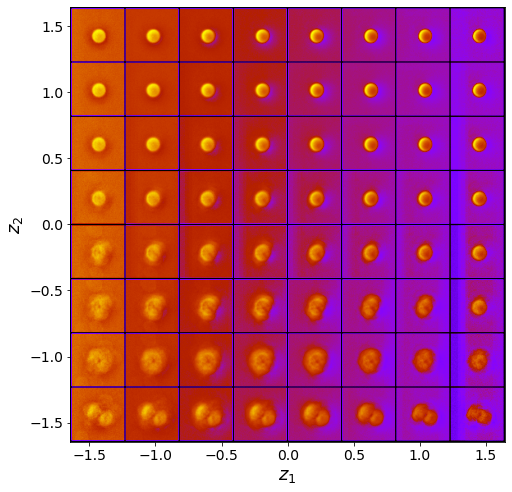

Epoch: 1551 Training loss: 980.9512
Epoch: 1552 Training loss: 980.8753
Epoch: 1553 Training loss: 980.5179
Epoch: 1554 Training loss: 980.6451
Epoch: 1555 Training loss: 980.6425
Epoch: 1556 Training loss: 980.8325
Epoch: 1557 Training loss: 980.7284
Epoch: 1558 Training loss: 980.7097
Epoch: 1559 Training loss: 980.7036
Epoch: 1560 Training loss: 980.6509
Epoch: 1561 Training loss: 980.6247
Epoch: 1562 Training loss: 980.5619
Epoch: 1563 Training loss: 980.4955
Epoch: 1564 Training loss: 980.8732
Epoch: 1565 Training loss: 980.7132
Epoch: 1566 Training loss: 980.5314
Epoch: 1567 Training loss: 980.6793
Epoch: 1568 Training loss: 980.6621
Epoch: 1569 Training loss: 980.6113
Epoch: 1570 Training loss: 980.6355
Epoch: 1571 Training loss: 980.5177
Epoch: 1572 Training loss: 980.7266
Epoch: 1573 Training loss: 980.5563
Epoch: 1574 Training loss: 980.4397
Epoch: 1575 Training loss: 980.5011
Epoch: 1576 Training loss: 980.3198
Epoch: 1577 Training loss: 980.5068
Epoch: 1578 Training loss: 9

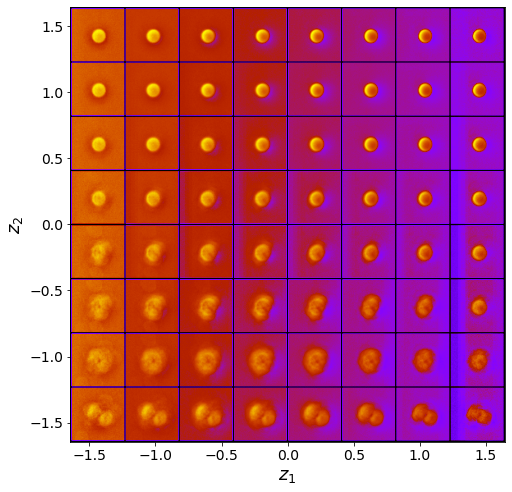

Epoch: 1601 Training loss: 980.4051
Epoch: 1602 Training loss: 980.4636
Epoch: 1603 Training loss: 980.4360
Epoch: 1604 Training loss: 980.4825
Epoch: 1605 Training loss: 980.4974
Epoch: 1606 Training loss: 980.8104
Epoch: 1607 Training loss: 980.4287
Epoch: 1608 Training loss: 980.7772
Epoch: 1609 Training loss: 980.5283
Epoch: 1610 Training loss: 980.4323
Epoch: 1611 Training loss: 980.3468
Epoch: 1612 Training loss: 980.3756
Epoch: 1613 Training loss: 980.5269
Epoch: 1614 Training loss: 980.4660
Epoch: 1615 Training loss: 980.3331
Epoch: 1616 Training loss: 980.5419
Epoch: 1617 Training loss: 981.1531
Epoch: 1618 Training loss: 980.7371
Epoch: 1619 Training loss: 980.5143
Epoch: 1620 Training loss: 980.6103
Epoch: 1621 Training loss: 980.5525
Epoch: 1622 Training loss: 980.6798
Epoch: 1623 Training loss: 980.6007
Epoch: 1624 Training loss: 980.4751
Epoch: 1625 Training loss: 980.4511
Epoch: 1626 Training loss: 980.3504
Epoch: 1627 Training loss: 980.3022
Epoch: 1628 Training loss: 9

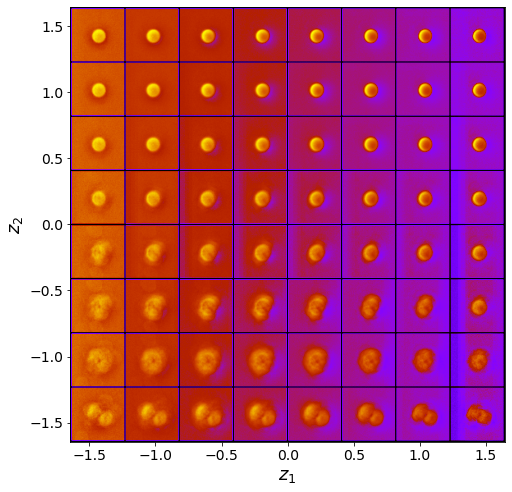

Epoch: 1651 Training loss: 980.0142
Epoch: 1652 Training loss: 980.1106
Epoch: 1653 Training loss: 980.1287
Epoch: 1654 Training loss: 980.1597
Epoch: 1655 Training loss: 980.0329
Epoch: 1656 Training loss: 980.1175
Epoch: 1657 Training loss: 980.1082
Epoch: 1658 Training loss: 980.3129
Epoch: 1659 Training loss: 980.3396
Epoch: 1660 Training loss: 980.9472
Epoch: 1661 Training loss: 980.2272
Epoch: 1662 Training loss: 980.0723
Epoch: 1663 Training loss: 980.1483
Epoch: 1664 Training loss: 980.2656
Epoch: 1665 Training loss: 981.0114
Epoch: 1666 Training loss: 980.7027
Epoch: 1667 Training loss: 980.5109
Epoch: 1668 Training loss: 980.6887
Epoch: 1669 Training loss: 980.1291
Epoch: 1670 Training loss: 980.2246
Epoch: 1671 Training loss: 980.0468
Epoch: 1672 Training loss: 980.0341
Epoch: 1673 Training loss: 980.4362
Epoch: 1674 Training loss: 980.8193
Epoch: 1675 Training loss: 979.9225
Epoch: 1676 Training loss: 979.9528
Epoch: 1677 Training loss: 979.9993
Epoch: 1678 Training loss: 9

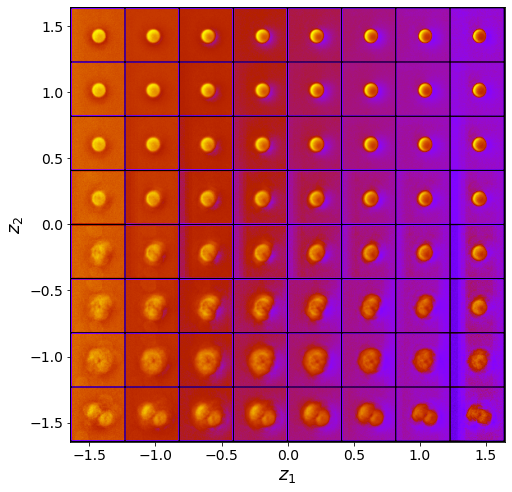

Epoch: 1701 Training loss: 979.9408
Epoch: 1702 Training loss: 979.9030
Epoch: 1703 Training loss: 979.8267
Epoch: 1704 Training loss: 979.7556
Epoch: 1705 Training loss: 979.7214
Epoch: 1706 Training loss: 979.8774
Epoch: 1707 Training loss: 979.8024
Epoch: 1708 Training loss: 979.7747
Epoch: 1709 Training loss: 980.1080
Epoch: 1710 Training loss: 980.3717
Epoch: 1711 Training loss: 980.3227
Epoch: 1712 Training loss: 979.6860
Epoch: 1713 Training loss: 979.8028
Epoch: 1714 Training loss: 979.7936
Epoch: 1715 Training loss: 979.8777
Epoch: 1716 Training loss: 979.7984
Epoch: 1717 Training loss: 979.7720
Epoch: 1718 Training loss: 979.9086
Epoch: 1719 Training loss: 980.0708
Epoch: 1720 Training loss: 979.9290
Epoch: 1721 Training loss: 979.8305
Epoch: 1722 Training loss: 979.7956
Epoch: 1723 Training loss: 979.9742
Epoch: 1724 Training loss: 979.8230
Epoch: 1725 Training loss: 979.8555
Epoch: 1726 Training loss: 979.7559
Epoch: 1727 Training loss: 979.6844
Epoch: 1728 Training loss: 9

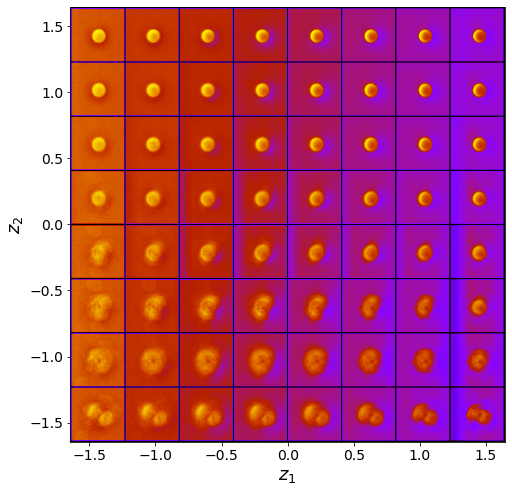

Epoch: 1751 Training loss: 980.3094
Epoch: 1752 Training loss: 979.9819
Epoch: 1753 Training loss: 980.1477
Epoch: 1754 Training loss: 979.8762
Epoch: 1755 Training loss: 979.9072
Epoch: 1756 Training loss: 980.5775
Epoch: 1757 Training loss: 980.5651
Epoch: 1758 Training loss: 980.0734
Epoch: 1759 Training loss: 979.6848
Epoch: 1760 Training loss: 979.8810
Epoch: 1761 Training loss: 979.7770
Epoch: 1762 Training loss: 979.6544
Epoch: 1763 Training loss: 979.5928
Epoch: 1764 Training loss: 979.5212
Epoch: 1765 Training loss: 979.6648
Epoch: 1766 Training loss: 979.7406
Epoch: 1767 Training loss: 979.9250
Epoch: 1768 Training loss: 980.2134
Epoch: 1769 Training loss: 979.6900
Epoch: 1770 Training loss: 979.5395
Epoch: 1771 Training loss: 979.5957
Epoch: 1772 Training loss: 979.4586
Epoch: 1773 Training loss: 979.6134
Epoch: 1774 Training loss: 979.5932
Epoch: 1775 Training loss: 979.7599
Epoch: 1776 Training loss: 979.6541
Epoch: 1777 Training loss: 979.5911
Epoch: 1778 Training loss: 9

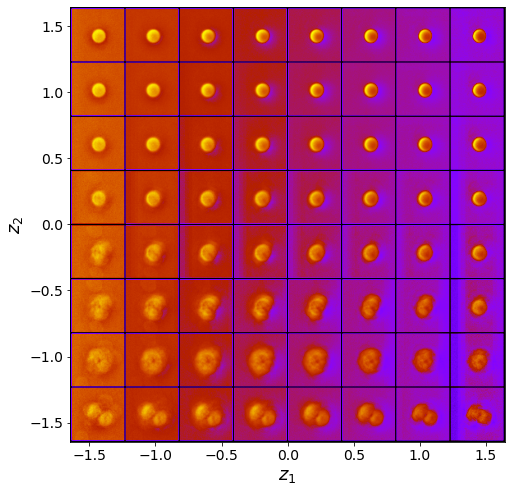

Epoch: 1801 Training loss: 979.8246
Epoch: 1802 Training loss: 979.6444
Epoch: 1803 Training loss: 979.5657
Epoch: 1804 Training loss: 979.6202
Epoch: 1805 Training loss: 979.3720
Epoch: 1806 Training loss: 979.4580
Epoch: 1807 Training loss: 979.4368
Epoch: 1808 Training loss: 979.4133
Epoch: 1809 Training loss: 979.4159
Epoch: 1810 Training loss: 979.6179
Epoch: 1811 Training loss: 979.3051
Epoch: 1812 Training loss: 979.4299
Epoch: 1813 Training loss: 979.3805
Epoch: 1814 Training loss: 979.2975
Epoch: 1815 Training loss: 979.5038
Epoch: 1816 Training loss: 979.4322
Epoch: 1817 Training loss: 979.7371
Epoch: 1818 Training loss: 979.7862
Epoch: 1819 Training loss: 979.6215
Epoch: 1820 Training loss: 979.3530
Epoch: 1821 Training loss: 979.2811
Epoch: 1822 Training loss: 979.4762
Epoch: 1823 Training loss: 979.1789
Epoch: 1824 Training loss: 979.3440
Epoch: 1825 Training loss: 979.2196
Epoch: 1826 Training loss: 979.4649
Epoch: 1827 Training loss: 979.7026
Epoch: 1828 Training loss: 9

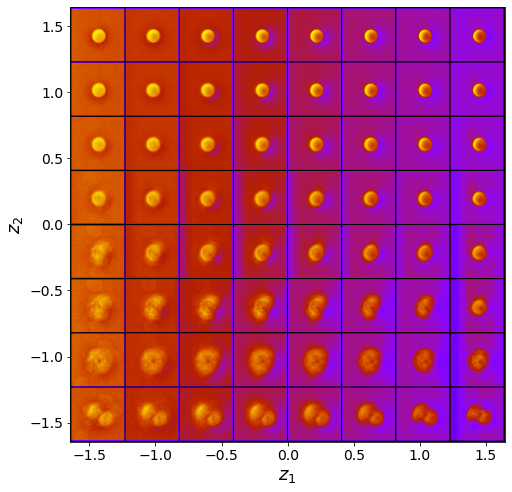

Epoch: 1851 Training loss: 979.1336
Epoch: 1852 Training loss: 979.2347
Epoch: 1853 Training loss: 979.2002
Epoch: 1854 Training loss: 979.0962
Epoch: 1855 Training loss: 979.0852
Epoch: 1856 Training loss: 979.5436
Epoch: 1857 Training loss: 979.9227
Epoch: 1858 Training loss: 979.8852
Epoch: 1859 Training loss: 979.6054
Epoch: 1860 Training loss: 979.7378
Epoch: 1861 Training loss: 979.1276
Epoch: 1862 Training loss: 978.9895
Epoch: 1863 Training loss: 979.2382
Epoch: 1864 Training loss: 979.1637
Epoch: 1865 Training loss: 979.5155
Epoch: 1866 Training loss: 979.2188
Epoch: 1867 Training loss: 979.2824
Epoch: 1868 Training loss: 979.4643
Epoch: 1869 Training loss: 979.3631
Epoch: 1870 Training loss: 979.1433
Epoch: 1871 Training loss: 979.1199
Epoch: 1872 Training loss: 979.2766
Epoch: 1873 Training loss: 979.5233
Epoch: 1874 Training loss: 979.0258
Epoch: 1875 Training loss: 979.0988
Epoch: 1876 Training loss: 979.0575
Epoch: 1877 Training loss: 979.0801
Epoch: 1878 Training loss: 9

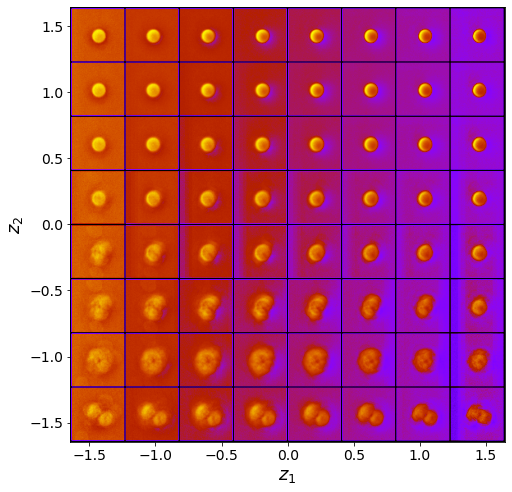

Epoch: 1901 Training loss: 979.3805
Epoch: 1902 Training loss: 978.9279
Epoch: 1903 Training loss: 978.8454
Epoch: 1904 Training loss: 978.9723
Epoch: 1905 Training loss: 979.1370
Epoch: 1906 Training loss: 979.1490
Epoch: 1907 Training loss: 978.9974
Epoch: 1908 Training loss: 978.8282
Epoch: 1909 Training loss: 978.7956
Epoch: 1910 Training loss: 978.8086
Epoch: 1911 Training loss: 978.8091
Epoch: 1912 Training loss: 978.7853
Epoch: 1913 Training loss: 978.9125
Epoch: 1914 Training loss: 978.8487
Epoch: 1915 Training loss: 978.8177
Epoch: 1916 Training loss: 979.0246
Epoch: 1917 Training loss: 979.3037
Epoch: 1918 Training loss: 979.4541
Epoch: 1919 Training loss: 979.4082
Epoch: 1920 Training loss: 979.0271
Epoch: 1921 Training loss: 979.6392
Epoch: 1922 Training loss: 979.9176
Epoch: 1923 Training loss: 979.5175
Epoch: 1924 Training loss: 979.2837
Epoch: 1925 Training loss: 979.3473
Epoch: 1926 Training loss: 979.5777
Epoch: 1927 Training loss: 979.1235
Epoch: 1928 Training loss: 9

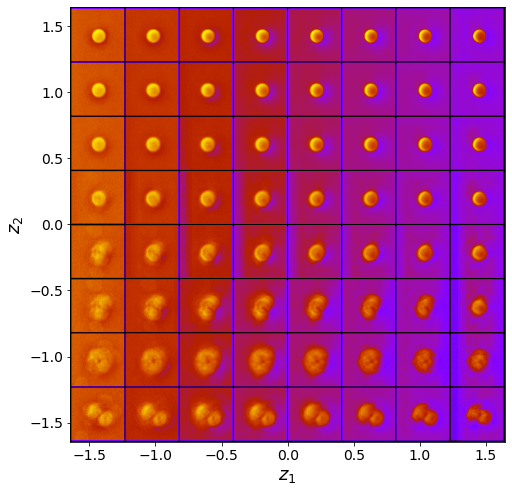

Epoch: 1951 Training loss: 978.9128
Epoch: 1952 Training loss: 978.6313
Epoch: 1953 Training loss: 978.7466
Epoch: 1954 Training loss: 978.6811
Epoch: 1955 Training loss: 978.8647
Epoch: 1956 Training loss: 978.7110
Epoch: 1957 Training loss: 978.8012
Epoch: 1958 Training loss: 978.9189
Epoch: 1959 Training loss: 979.0671
Epoch: 1960 Training loss: 978.8249
Epoch: 1961 Training loss: 979.1078
Epoch: 1962 Training loss: 978.7075
Epoch: 1963 Training loss: 978.6390
Epoch: 1964 Training loss: 978.6700
Epoch: 1965 Training loss: 978.6834
Epoch: 1966 Training loss: 978.7126
Epoch: 1967 Training loss: 978.6359
Epoch: 1968 Training loss: 978.6964
Epoch: 1969 Training loss: 978.5851
Epoch: 1970 Training loss: 978.6899
Epoch: 1971 Training loss: 978.6944
Epoch: 1972 Training loss: 978.8627
Epoch: 1973 Training loss: 978.7419
Epoch: 1974 Training loss: 978.6259
Epoch: 1975 Training loss: 978.4549
Epoch: 1976 Training loss: 978.5104
Epoch: 1977 Training loss: 978.7135
Epoch: 1978 Training loss: 9

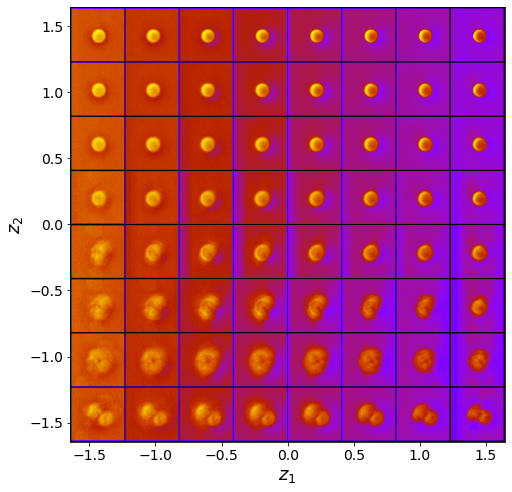

Epoch: 2001 Training loss: 978.6098
Epoch: 2002 Training loss: 978.5900
Epoch: 2003 Training loss: 978.5587
Epoch: 2004 Training loss: 978.5843
Epoch: 2005 Training loss: 978.5557
Epoch: 2006 Training loss: 978.7093
Epoch: 2007 Training loss: 978.6400
Epoch: 2008 Training loss: 978.4764
Epoch: 2009 Training loss: 978.3231
Epoch: 2010 Training loss: 978.5214
Epoch: 2011 Training loss: 978.6729
Epoch: 2012 Training loss: 978.7655
Epoch: 2013 Training loss: 978.5035
Epoch: 2014 Training loss: 978.3984
Epoch: 2015 Training loss: 978.4545
Epoch: 2016 Training loss: 978.5389
Epoch: 2017 Training loss: 978.3904
Epoch: 2018 Training loss: 978.4696
Epoch: 2019 Training loss: 978.5263
Epoch: 2020 Training loss: 978.5860
Epoch: 2021 Training loss: 978.7508
Epoch: 2022 Training loss: 979.0752
Epoch: 2023 Training loss: 978.6145
Epoch: 2024 Training loss: 978.3803
Epoch: 2025 Training loss: 978.2501
Epoch: 2026 Training loss: 978.3775
Epoch: 2027 Training loss: 978.3002
Epoch: 2028 Training loss: 9

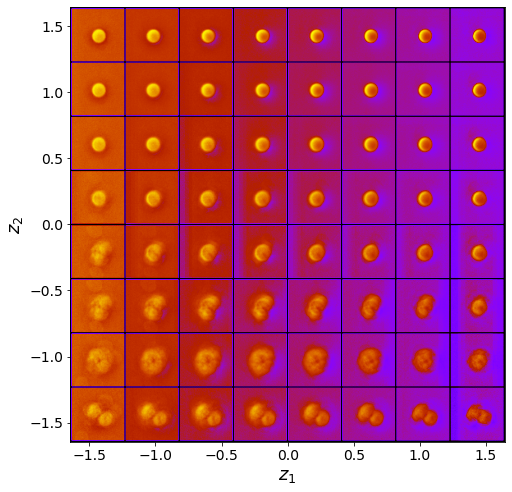

Epoch: 2051 Training loss: 978.4561
Epoch: 2052 Training loss: 978.5619
Epoch: 2053 Training loss: 979.0020
Epoch: 2054 Training loss: 978.3552
Epoch: 2055 Training loss: 978.2706
Epoch: 2056 Training loss: 978.2554
Epoch: 2057 Training loss: 978.8599
Epoch: 2058 Training loss: 978.4840
Epoch: 2059 Training loss: 978.3821
Epoch: 2060 Training loss: 978.2746
Epoch: 2061 Training loss: 978.2977
Epoch: 2062 Training loss: 978.2633
Epoch: 2063 Training loss: 978.3418
Epoch: 2064 Training loss: 978.2741
Epoch: 2065 Training loss: 978.3948
Epoch: 2066 Training loss: 978.1573
Epoch: 2067 Training loss: 978.1795
Epoch: 2068 Training loss: 978.1175
Epoch: 2069 Training loss: 978.3525
Epoch: 2070 Training loss: 978.3591
Epoch: 2071 Training loss: 978.2819
Epoch: 2072 Training loss: 978.2279
Epoch: 2073 Training loss: 978.2734
Epoch: 2074 Training loss: 978.1323
Epoch: 2075 Training loss: 978.5919
Epoch: 2076 Training loss: 978.5327
Epoch: 2077 Training loss: 979.6658
Epoch: 2078 Training loss: 9

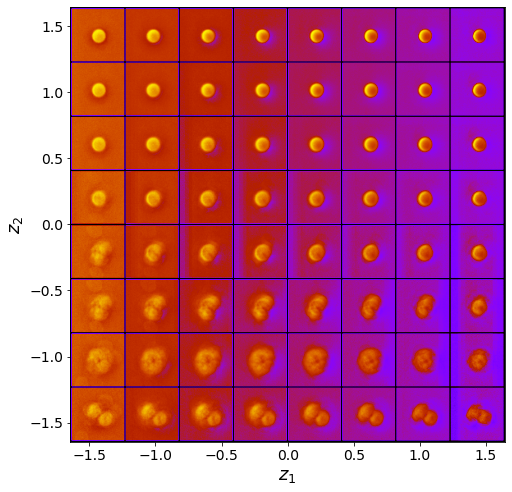

Epoch: 2101 Training loss: 978.5817
Epoch: 2102 Training loss: 978.3458
Epoch: 2103 Training loss: 978.0411
Epoch: 2104 Training loss: 978.0701
Epoch: 2105 Training loss: 977.9756
Epoch: 2106 Training loss: 977.9863
Epoch: 2107 Training loss: 977.9799
Epoch: 2108 Training loss: 978.2062
Epoch: 2109 Training loss: 978.2655
Epoch: 2110 Training loss: 978.4284
Epoch: 2111 Training loss: 977.9964
Epoch: 2112 Training loss: 978.3224
Epoch: 2113 Training loss: 978.0728
Epoch: 2114 Training loss: 977.8826
Epoch: 2115 Training loss: 977.9369
Epoch: 2116 Training loss: 977.9413
Epoch: 2117 Training loss: 977.8345
Epoch: 2118 Training loss: 977.9433
Epoch: 2119 Training loss: 977.8360
Epoch: 2120 Training loss: 977.7700
Epoch: 2121 Training loss: 977.8281
Epoch: 2122 Training loss: 977.9191
Epoch: 2123 Training loss: 978.1567
Epoch: 2124 Training loss: 978.6031
Epoch: 2125 Training loss: 978.4147
Epoch: 2126 Training loss: 978.1640
Epoch: 2127 Training loss: 978.1136
Epoch: 2128 Training loss: 9

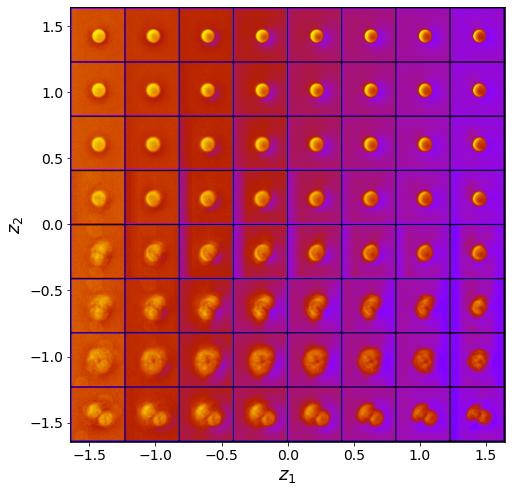

Epoch: 2151 Training loss: 977.9989
Epoch: 2152 Training loss: 977.9332
Epoch: 2153 Training loss: 978.0119
Epoch: 2154 Training loss: 977.7214
Epoch: 2155 Training loss: 977.6785
Epoch: 2156 Training loss: 977.8682
Epoch: 2157 Training loss: 977.9014
Epoch: 2158 Training loss: 977.7658
Epoch: 2159 Training loss: 977.6823
Epoch: 2160 Training loss: 977.6226
Epoch: 2161 Training loss: 977.9581
Epoch: 2162 Training loss: 977.9104
Epoch: 2163 Training loss: 978.0718
Epoch: 2164 Training loss: 978.0480
Epoch: 2165 Training loss: 977.8630
Epoch: 2166 Training loss: 977.5840
Epoch: 2167 Training loss: 977.6081
Epoch: 2168 Training loss: 978.0413
Epoch: 2169 Training loss: 977.8100
Epoch: 2170 Training loss: 977.6382
Epoch: 2171 Training loss: 977.6854
Epoch: 2172 Training loss: 977.5836
Epoch: 2173 Training loss: 977.5298
Epoch: 2174 Training loss: 977.6100
Epoch: 2175 Training loss: 977.6174
Epoch: 2176 Training loss: 977.5959
Epoch: 2177 Training loss: 977.8883
Epoch: 2178 Training loss: 9

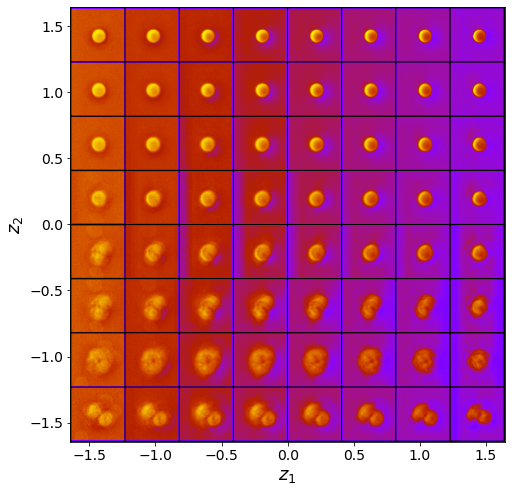

Epoch: 2201 Training loss: 978.4406
Epoch: 2202 Training loss: 977.8107
Epoch: 2203 Training loss: 978.2137
Epoch: 2204 Training loss: 978.7776
Epoch: 2205 Training loss: 978.6956
Epoch: 2206 Training loss: 977.7486
Epoch: 2207 Training loss: 977.4589
Epoch: 2208 Training loss: 977.5340
Epoch: 2209 Training loss: 977.5513
Epoch: 2210 Training loss: 977.8001
Epoch: 2211 Training loss: 977.8529
Epoch: 2212 Training loss: 977.9340
Epoch: 2213 Training loss: 977.7018
Epoch: 2214 Training loss: 977.9601
Epoch: 2215 Training loss: 977.9233
Epoch: 2216 Training loss: 977.6140
Epoch: 2217 Training loss: 977.7095
Epoch: 2218 Training loss: 977.8452
Epoch: 2219 Training loss: 977.3898
Epoch: 2220 Training loss: 977.4363
Epoch: 2221 Training loss: 977.4143
Epoch: 2222 Training loss: 977.5844
Epoch: 2223 Training loss: 977.4376
Epoch: 2224 Training loss: 977.7837
Epoch: 2225 Training loss: 977.3603
Epoch: 2226 Training loss: 977.4665
Epoch: 2227 Training loss: 977.4714
Epoch: 2228 Training loss: 9

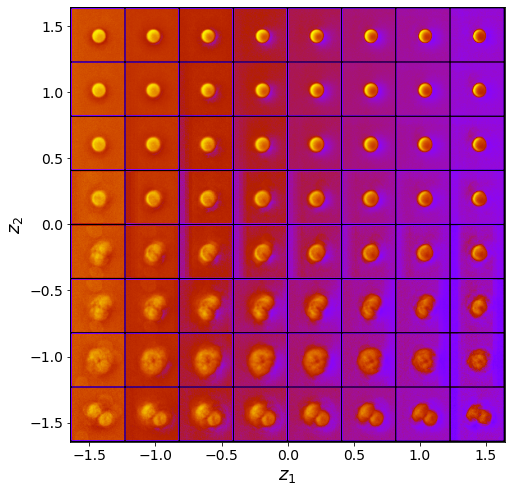

Epoch: 2251 Training loss: 977.8892
Epoch: 2252 Training loss: 977.4970
Epoch: 2253 Training loss: 977.4102
Epoch: 2254 Training loss: 977.2999
Epoch: 2255 Training loss: 977.3026
Epoch: 2256 Training loss: 977.4392
Epoch: 2257 Training loss: 977.3433
Epoch: 2258 Training loss: 977.3639
Epoch: 2259 Training loss: 977.5221
Epoch: 2260 Training loss: 977.8250
Epoch: 2261 Training loss: 977.2740
Epoch: 2262 Training loss: 977.4468
Epoch: 2263 Training loss: 977.2328
Epoch: 2264 Training loss: 977.1656
Epoch: 2265 Training loss: 977.2571
Epoch: 2266 Training loss: 977.2076
Epoch: 2267 Training loss: 977.4464
Epoch: 2268 Training loss: 977.3189
Epoch: 2269 Training loss: 977.1773
Epoch: 2270 Training loss: 977.3058
Epoch: 2271 Training loss: 977.4505
Epoch: 2272 Training loss: 977.2310
Epoch: 2273 Training loss: 977.3555
Epoch: 2274 Training loss: 977.2426
Epoch: 2275 Training loss: 977.7634
Epoch: 2276 Training loss: 977.1530
Epoch: 2277 Training loss: 977.1864
Epoch: 2278 Training loss: 9

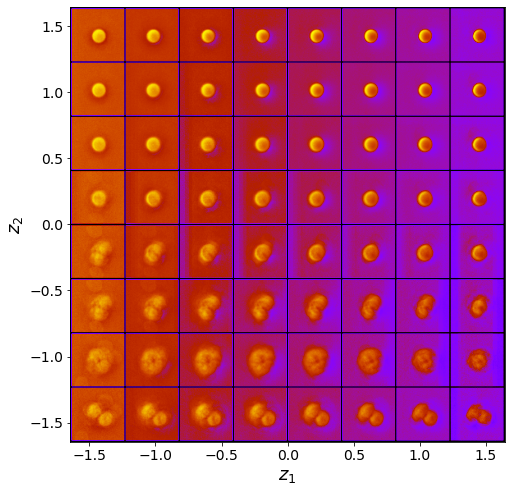

Epoch: 2301 Training loss: 977.0103
Epoch: 2302 Training loss: 976.9762
Epoch: 2303 Training loss: 976.9808
Epoch: 2304 Training loss: 977.1195
Epoch: 2305 Training loss: 977.3473
Epoch: 2306 Training loss: 977.3448
Epoch: 2307 Training loss: 977.0513
Epoch: 2308 Training loss: 976.9674
Epoch: 2309 Training loss: 977.3215
Epoch: 2310 Training loss: 977.3003
Epoch: 2311 Training loss: 977.7689
Epoch: 2312 Training loss: 977.3633
Epoch: 2313 Training loss: 977.1197
Epoch: 2314 Training loss: 977.0416
Epoch: 2315 Training loss: 976.9139
Epoch: 2316 Training loss: 977.1114
Epoch: 2317 Training loss: 977.3896
Epoch: 2318 Training loss: 977.7972
Epoch: 2319 Training loss: 977.0078
Epoch: 2320 Training loss: 976.9787
Epoch: 2321 Training loss: 977.1061
Epoch: 2322 Training loss: 976.9270
Epoch: 2323 Training loss: 976.8813
Epoch: 2324 Training loss: 977.1737
Epoch: 2325 Training loss: 976.9796
Epoch: 2326 Training loss: 976.7791
Epoch: 2327 Training loss: 976.8320
Epoch: 2328 Training loss: 9

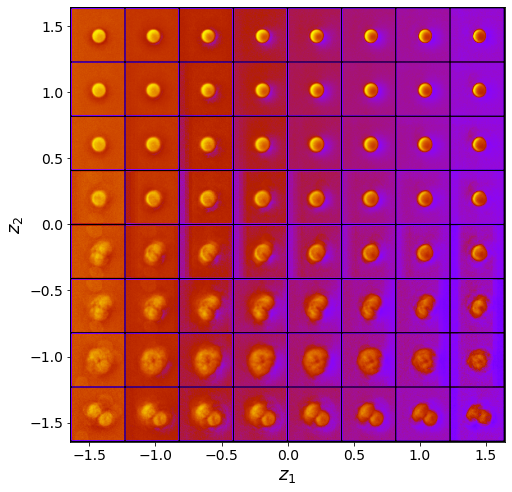

Epoch: 2351 Training loss: 977.4724
Epoch: 2352 Training loss: 977.5976
Epoch: 2353 Training loss: 977.3364
Epoch: 2354 Training loss: 978.1004
Epoch: 2355 Training loss: 977.0401
Epoch: 2356 Training loss: 977.0604
Epoch: 2357 Training loss: 977.6686
Epoch: 2358 Training loss: 977.2353
Epoch: 2359 Training loss: 976.8079
Epoch: 2360 Training loss: 976.7457
Epoch: 2361 Training loss: 976.9032
Epoch: 2362 Training loss: 976.9843
Epoch: 2363 Training loss: 976.9916
Epoch: 2364 Training loss: 976.6927
Epoch: 2365 Training loss: 976.6658
Epoch: 2366 Training loss: 976.7342
Epoch: 2367 Training loss: 976.7796
Epoch: 2368 Training loss: 976.9639
Epoch: 2369 Training loss: 976.8322
Epoch: 2370 Training loss: 976.7724
Epoch: 2371 Training loss: 976.6472
Epoch: 2372 Training loss: 976.7086
Epoch: 2373 Training loss: 976.6081
Epoch: 2374 Training loss: 976.6775
Epoch: 2375 Training loss: 976.6270
Epoch: 2376 Training loss: 976.8044
Epoch: 2377 Training loss: 976.6974
Epoch: 2378 Training loss: 9

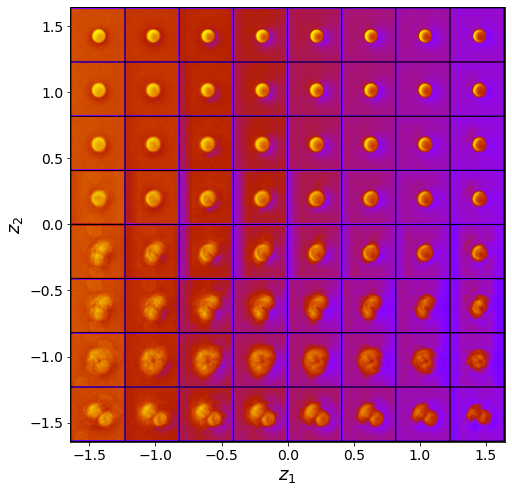

Epoch: 2401 Training loss: 976.6656
Epoch: 2402 Training loss: 976.6045
Epoch: 2403 Training loss: 976.6300
Epoch: 2404 Training loss: 976.6794
Epoch: 2405 Training loss: 977.4576
Epoch: 2406 Training loss: 977.4548
Epoch: 2407 Training loss: 977.7822
Epoch: 2408 Training loss: 976.9195
Epoch: 2409 Training loss: 976.7081
Epoch: 2410 Training loss: 976.6929
Epoch: 2411 Training loss: 976.8780
Epoch: 2412 Training loss: 976.5692
Epoch: 2413 Training loss: 976.7067
Epoch: 2414 Training loss: 976.7990
Epoch: 2415 Training loss: 976.9845
Epoch: 2416 Training loss: 976.5389
Epoch: 2417 Training loss: 976.9137
Epoch: 2418 Training loss: 976.8207
Epoch: 2419 Training loss: 976.7129
Epoch: 2420 Training loss: 977.2366
Epoch: 2421 Training loss: 976.7283
Epoch: 2422 Training loss: 976.8252
Epoch: 2423 Training loss: 976.6115
Epoch: 2424 Training loss: 976.6731
Epoch: 2425 Training loss: 976.6537
Epoch: 2426 Training loss: 976.5340
Epoch: 2427 Training loss: 976.5894
Epoch: 2428 Training loss: 9

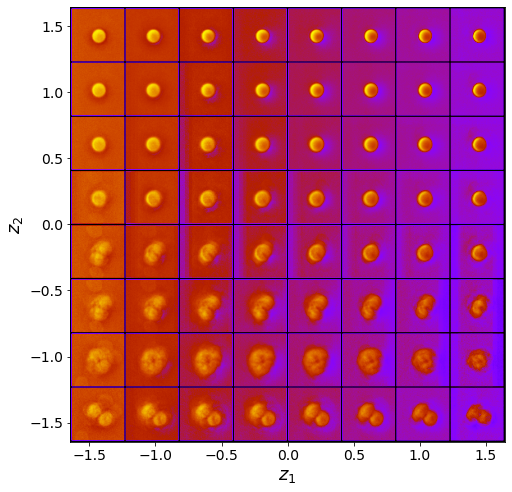

Epoch: 2451 Training loss: 976.5614
Epoch: 2452 Training loss: 976.5284
Epoch: 2453 Training loss: 976.6642
Epoch: 2454 Training loss: 976.4127
Epoch: 2455 Training loss: 976.3407
Epoch: 2456 Training loss: 976.5014
Epoch: 2457 Training loss: 976.5001
Epoch: 2458 Training loss: 976.4521
Epoch: 2459 Training loss: 976.3623
Epoch: 2460 Training loss: 976.1832
Epoch: 2461 Training loss: 976.2912
Epoch: 2462 Training loss: 976.2950
Epoch: 2463 Training loss: 976.7033
Epoch: 2464 Training loss: 976.5822
Epoch: 2465 Training loss: 976.3599
Epoch: 2466 Training loss: 976.2880
Epoch: 2467 Training loss: 976.3383
Epoch: 2468 Training loss: 976.3211
Epoch: 2469 Training loss: 976.1612
Epoch: 2470 Training loss: 976.1995
Epoch: 2471 Training loss: 976.3132
Epoch: 2472 Training loss: 976.4113
Epoch: 2473 Training loss: 976.2524
Epoch: 2474 Training loss: 976.5035
Epoch: 2475 Training loss: 976.2916
Epoch: 2476 Training loss: 976.2465
Epoch: 2477 Training loss: 976.1648
Epoch: 2478 Training loss: 9

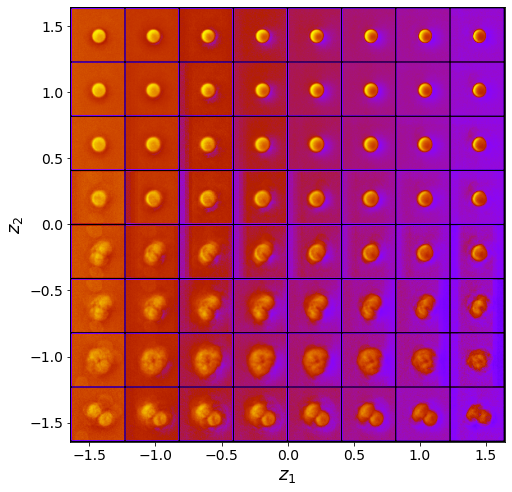

Epoch: 2501 Training loss: 976.4779
Epoch: 2502 Training loss: 976.3164
Epoch: 2503 Training loss: 976.1810
Epoch: 2504 Training loss: 976.0604
Epoch: 2505 Training loss: 976.2331
Epoch: 2506 Training loss: 976.6768
Epoch: 2507 Training loss: 976.5775
Epoch: 2508 Training loss: 976.3637
Epoch: 2509 Training loss: 977.0181
Epoch: 2510 Training loss: 976.5133
Epoch: 2511 Training loss: 976.1148
Epoch: 2512 Training loss: 976.0585
Epoch: 2513 Training loss: 976.2826
Epoch: 2514 Training loss: 976.6161
Epoch: 2515 Training loss: 976.1425
Epoch: 2516 Training loss: 976.0047
Epoch: 2517 Training loss: 976.0544
Epoch: 2518 Training loss: 976.0285
Epoch: 2519 Training loss: 976.3807
Epoch: 2520 Training loss: 976.4598
Epoch: 2521 Training loss: 976.3941
Epoch: 2522 Training loss: 976.5024
Epoch: 2523 Training loss: 976.2572
Epoch: 2524 Training loss: 976.0983
Epoch: 2525 Training loss: 976.4335
Epoch: 2526 Training loss: 976.0255
Epoch: 2527 Training loss: 975.9503
Epoch: 2528 Training loss: 9

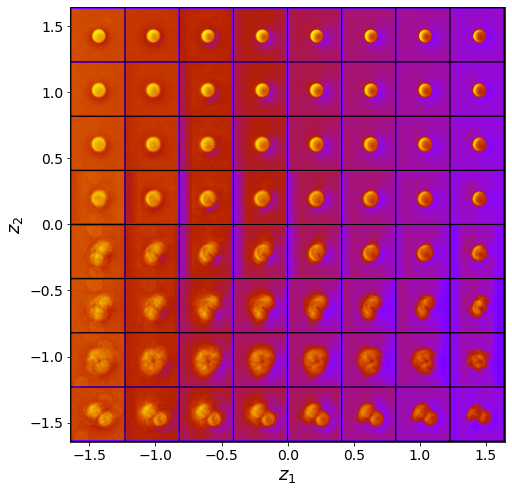

Epoch: 2551 Training loss: 976.0404
Epoch: 2552 Training loss: 976.5401
Epoch: 2553 Training loss: 976.6575
Epoch: 2554 Training loss: 976.5653
Epoch: 2555 Training loss: 976.3170
Epoch: 2556 Training loss: 976.1598
Epoch: 2557 Training loss: 975.9650
Epoch: 2558 Training loss: 975.9510
Epoch: 2559 Training loss: 976.3525
Epoch: 2560 Training loss: 976.9714
Epoch: 2561 Training loss: 976.1930
Epoch: 2562 Training loss: 975.9527
Epoch: 2563 Training loss: 976.2388
Epoch: 2564 Training loss: 976.3885
Epoch: 2565 Training loss: 976.1871
Epoch: 2566 Training loss: 976.3900
Epoch: 2567 Training loss: 975.9000
Epoch: 2568 Training loss: 976.0219
Epoch: 2569 Training loss: 975.9056
Epoch: 2570 Training loss: 976.0146
Epoch: 2571 Training loss: 975.9309
Epoch: 2572 Training loss: 975.8209
Epoch: 2573 Training loss: 975.8657
Epoch: 2574 Training loss: 976.1501
Epoch: 2575 Training loss: 976.0363
Epoch: 2576 Training loss: 975.7726
Epoch: 2577 Training loss: 976.2049
Epoch: 2578 Training loss: 9

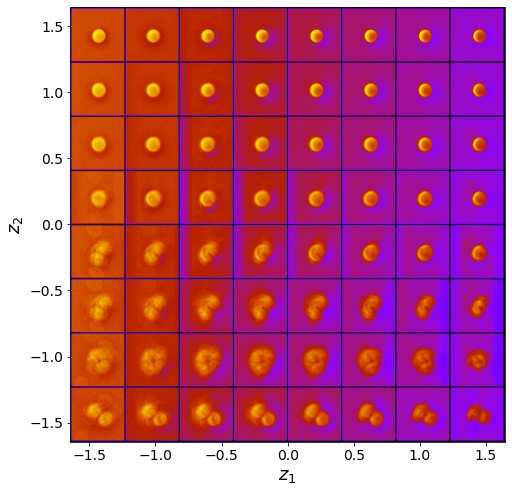

Epoch: 2601 Training loss: 975.9065
Epoch: 2602 Training loss: 976.4394
Epoch: 2603 Training loss: 976.1524
Epoch: 2604 Training loss: 975.9203
Epoch: 2605 Training loss: 975.8586
Epoch: 2606 Training loss: 975.9239
Epoch: 2607 Training loss: 976.1692
Epoch: 2608 Training loss: 975.7109
Epoch: 2609 Training loss: 975.8855
Epoch: 2610 Training loss: 975.7902
Epoch: 2611 Training loss: 975.7280
Epoch: 2612 Training loss: 975.6741
Epoch: 2613 Training loss: 975.5970
Epoch: 2614 Training loss: 975.9042
Epoch: 2615 Training loss: 976.6903
Epoch: 2616 Training loss: 975.8821
Epoch: 2617 Training loss: 975.8507
Epoch: 2618 Training loss: 976.0985
Epoch: 2619 Training loss: 975.6662
Epoch: 2620 Training loss: 975.5441
Epoch: 2621 Training loss: 975.7293
Epoch: 2622 Training loss: 976.0433
Epoch: 2623 Training loss: 975.5523
Epoch: 2624 Training loss: 975.5411
Epoch: 2625 Training loss: 975.6101
Epoch: 2626 Training loss: 975.5599
Epoch: 2627 Training loss: 976.1148
Epoch: 2628 Training loss: 9

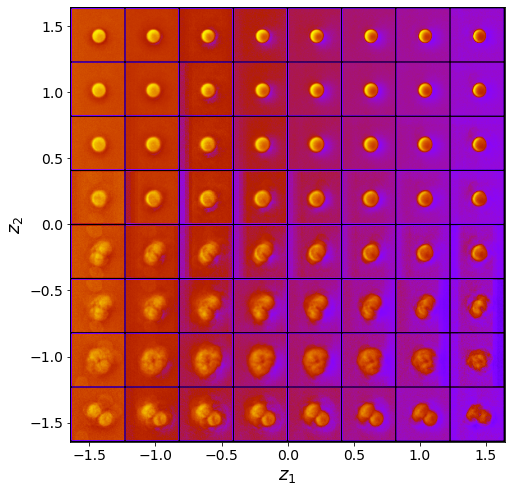

Epoch: 2651 Training loss: 975.6009
Epoch: 2652 Training loss: 975.7310
Epoch: 2653 Training loss: 975.7523
Epoch: 2654 Training loss: 975.5477
Epoch: 2655 Training loss: 975.6765
Epoch: 2656 Training loss: 975.6234
Epoch: 2657 Training loss: 975.5100
Epoch: 2658 Training loss: 975.6678
Epoch: 2659 Training loss: 975.8736
Epoch: 2660 Training loss: 976.0499
Epoch: 2661 Training loss: 976.1776
Epoch: 2662 Training loss: 976.2684
Epoch: 2663 Training loss: 975.9283
Epoch: 2664 Training loss: 975.7629
Epoch: 2665 Training loss: 975.6941
Epoch: 2666 Training loss: 975.6338
Epoch: 2667 Training loss: 975.5322
Epoch: 2668 Training loss: 976.3535
Epoch: 2669 Training loss: 976.2362
Epoch: 2670 Training loss: 975.8933
Epoch: 2671 Training loss: 975.6974
Epoch: 2672 Training loss: 975.4775
Epoch: 2673 Training loss: 975.5316
Epoch: 2674 Training loss: 975.5398
Epoch: 2675 Training loss: 975.7573
Epoch: 2676 Training loss: 975.4887
Epoch: 2677 Training loss: 975.9059
Epoch: 2678 Training loss: 9

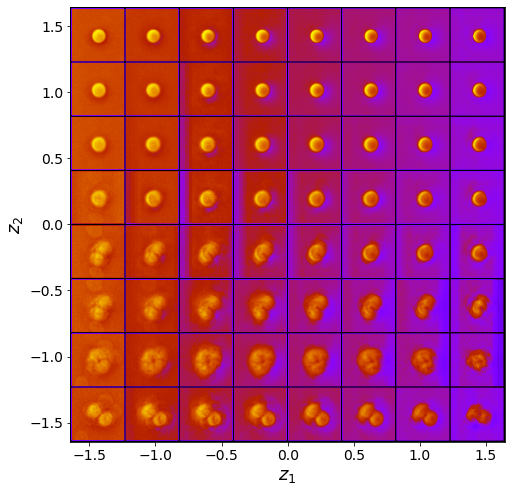

Epoch: 2701 Training loss: 975.3033
Epoch: 2702 Training loss: 975.3098
Epoch: 2703 Training loss: 975.2902
Epoch: 2704 Training loss: 975.2949
Epoch: 2705 Training loss: 975.4060
Epoch: 2706 Training loss: 975.1759
Epoch: 2707 Training loss: 975.3001
Epoch: 2708 Training loss: 975.3010
Epoch: 2709 Training loss: 975.2691
Epoch: 2710 Training loss: 975.7427
Epoch: 2711 Training loss: 975.7255
Epoch: 2712 Training loss: 975.3628
Epoch: 2713 Training loss: 975.3241
Epoch: 2714 Training loss: 975.3096
Epoch: 2715 Training loss: 975.9658
Epoch: 2716 Training loss: 975.3406
Epoch: 2717 Training loss: 975.2069
Epoch: 2718 Training loss: 975.2901
Epoch: 2719 Training loss: 975.5668
Epoch: 2720 Training loss: 975.7796
Epoch: 2721 Training loss: 975.3984
Epoch: 2722 Training loss: 976.0810
Epoch: 2723 Training loss: 975.8705
Epoch: 2724 Training loss: 975.2487
Epoch: 2725 Training loss: 975.2699
Epoch: 2726 Training loss: 975.1744
Epoch: 2727 Training loss: 975.3951
Epoch: 2728 Training loss: 9

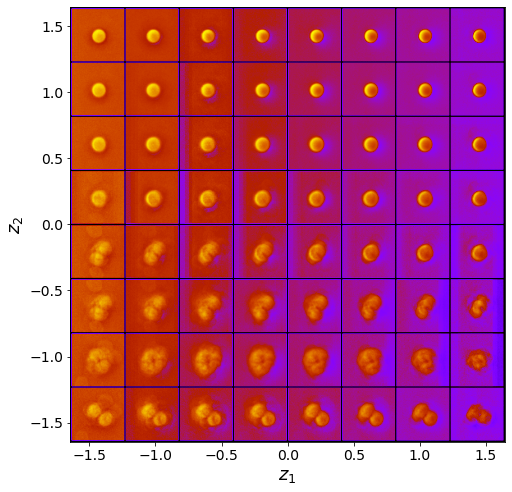

Epoch: 2751 Training loss: 975.3999
Epoch: 2752 Training loss: 975.3161
Epoch: 2753 Training loss: 975.5631
Epoch: 2754 Training loss: 975.0762
Epoch: 2755 Training loss: 975.0270
Epoch: 2756 Training loss: 975.1541
Epoch: 2757 Training loss: 975.1393
Epoch: 2758 Training loss: 975.1171
Epoch: 2759 Training loss: 975.1355
Epoch: 2760 Training loss: 975.3922
Epoch: 2761 Training loss: 975.2592
Epoch: 2762 Training loss: 975.3304
Epoch: 2763 Training loss: 975.5347
Epoch: 2764 Training loss: 975.3898
Epoch: 2765 Training loss: 975.3229
Epoch: 2766 Training loss: 975.1384
Epoch: 2767 Training loss: 975.0395
Epoch: 2768 Training loss: 975.0305
Epoch: 2769 Training loss: 975.2366
Epoch: 2770 Training loss: 975.3347
Epoch: 2771 Training loss: 975.1917
Epoch: 2772 Training loss: 975.2457
Epoch: 2773 Training loss: 974.9805
Epoch: 2774 Training loss: 975.0036
Epoch: 2775 Training loss: 974.9426
Epoch: 2776 Training loss: 975.0036
Epoch: 2777 Training loss: 974.9698
Epoch: 2778 Training loss: 9

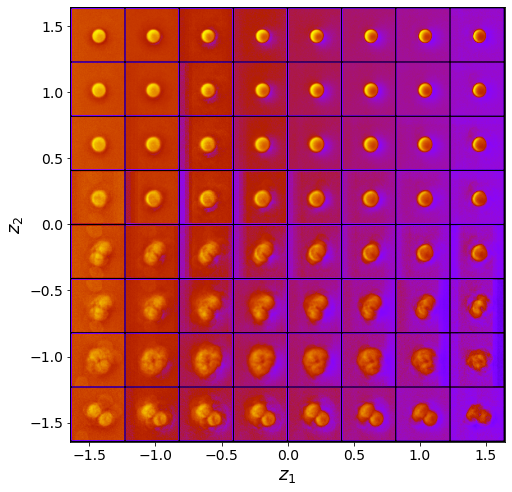

Epoch: 2801 Training loss: 974.8552
Epoch: 2802 Training loss: 975.3203
Epoch: 2803 Training loss: 975.2063
Epoch: 2804 Training loss: 975.3728
Epoch: 2805 Training loss: 974.9625
Epoch: 2806 Training loss: 974.9928
Epoch: 2807 Training loss: 975.0174
Epoch: 2808 Training loss: 975.1090
Epoch: 2809 Training loss: 975.0306
Epoch: 2810 Training loss: 975.3821
Epoch: 2811 Training loss: 975.5079
Epoch: 2812 Training loss: 974.8587
Epoch: 2813 Training loss: 974.7965
Epoch: 2814 Training loss: 975.0520
Epoch: 2815 Training loss: 974.9829
Epoch: 2816 Training loss: 975.2142
Epoch: 2817 Training loss: 974.9413
Epoch: 2818 Training loss: 975.0908
Epoch: 2819 Training loss: 975.0179
Epoch: 2820 Training loss: 974.8158
Epoch: 2821 Training loss: 974.7957
Epoch: 2822 Training loss: 974.7440
Epoch: 2823 Training loss: 974.7525
Epoch: 2824 Training loss: 974.7629
Epoch: 2825 Training loss: 974.9576
Epoch: 2826 Training loss: 974.9392
Epoch: 2827 Training loss: 974.8768
Epoch: 2828 Training loss: 9

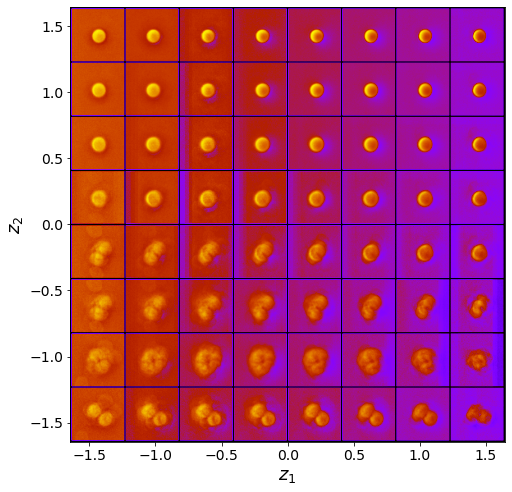

Epoch: 2851 Training loss: 974.6801
Epoch: 2852 Training loss: 974.5549
Epoch: 2853 Training loss: 974.6721
Epoch: 2854 Training loss: 974.6198
Epoch: 2855 Training loss: 974.7446
Epoch: 2856 Training loss: 975.0087
Epoch: 2857 Training loss: 974.9037
Epoch: 2858 Training loss: 974.6081
Epoch: 2859 Training loss: 974.6300
Epoch: 2860 Training loss: 974.6770
Epoch: 2861 Training loss: 974.6692
Epoch: 2862 Training loss: 974.6661
Epoch: 2863 Training loss: 974.6055
Epoch: 2864 Training loss: 974.6418
Epoch: 2865 Training loss: 974.5849
Epoch: 2866 Training loss: 974.6503
Epoch: 2867 Training loss: 974.5670
Epoch: 2868 Training loss: 974.7343
Epoch: 2869 Training loss: 974.6758
Epoch: 2870 Training loss: 974.6197
Epoch: 2871 Training loss: 974.8816
Epoch: 2872 Training loss: 975.3288
Epoch: 2873 Training loss: 975.1300
Epoch: 2874 Training loss: 974.8331
Epoch: 2875 Training loss: 974.7222
Epoch: 2876 Training loss: 974.7331
Epoch: 2877 Training loss: 974.5065
Epoch: 2878 Training loss: 9

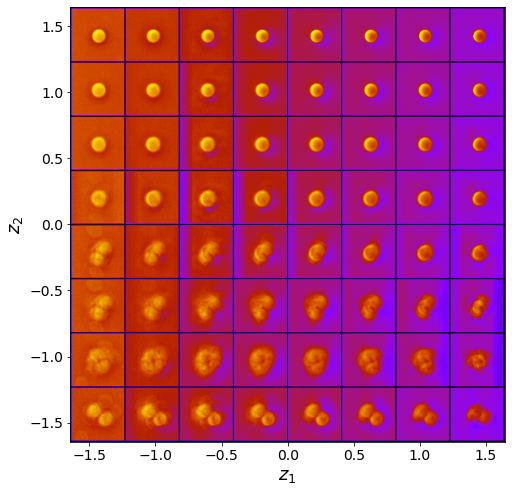

Epoch: 2901 Training loss: 975.1592
Epoch: 2902 Training loss: 974.5806
Epoch: 2903 Training loss: 974.4898
Epoch: 2904 Training loss: 974.5248
Epoch: 2905 Training loss: 974.5406
Epoch: 2906 Training loss: 975.3281
Epoch: 2907 Training loss: 974.8165
Epoch: 2908 Training loss: 974.5601
Epoch: 2909 Training loss: 974.6047
Epoch: 2910 Training loss: 974.4537
Epoch: 2911 Training loss: 974.4647
Epoch: 2912 Training loss: 974.5086
Epoch: 2913 Training loss: 974.5651
Epoch: 2914 Training loss: 974.9821
Epoch: 2915 Training loss: 974.6714
Epoch: 2916 Training loss: 974.8709
Epoch: 2917 Training loss: 974.4597
Epoch: 2918 Training loss: 974.7838
Epoch: 2919 Training loss: 974.8319
Epoch: 2920 Training loss: 974.7234
Epoch: 2921 Training loss: 974.3559
Epoch: 2922 Training loss: 975.0727
Epoch: 2923 Training loss: 975.1873
Epoch: 2924 Training loss: 974.9042
Epoch: 2925 Training loss: 974.8474
Epoch: 2926 Training loss: 974.5139
Epoch: 2927 Training loss: 974.6613
Epoch: 2928 Training loss: 9

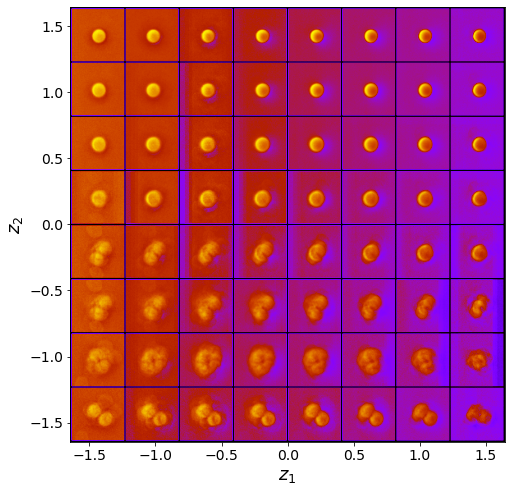

Epoch: 2951 Training loss: 974.6170
Epoch: 2952 Training loss: 974.3700
Epoch: 2953 Training loss: 974.4222
Epoch: 2954 Training loss: 974.3802
Epoch: 2955 Training loss: 974.5794
Epoch: 2956 Training loss: 974.6432
Epoch: 2957 Training loss: 974.9449
Epoch: 2958 Training loss: 974.4126
Epoch: 2959 Training loss: 974.3824
Epoch: 2960 Training loss: 974.5453
Epoch: 2961 Training loss: 974.4390
Epoch: 2962 Training loss: 974.7408
Epoch: 2963 Training loss: 974.5845
Epoch: 2964 Training loss: 974.2042
Epoch: 2965 Training loss: 974.2309
Epoch: 2966 Training loss: 974.3309
Epoch: 2967 Training loss: 974.6847
Epoch: 2968 Training loss: 974.5489
Epoch: 2969 Training loss: 974.8841
Epoch: 2970 Training loss: 975.0827
Epoch: 2971 Training loss: 975.0669
Epoch: 2972 Training loss: 974.8322
Epoch: 2973 Training loss: 974.4722
Epoch: 2974 Training loss: 974.4652
Epoch: 2975 Training loss: 974.2771
Epoch: 2976 Training loss: 974.3610
Epoch: 2977 Training loss: 974.2356
Epoch: 2978 Training loss: 9

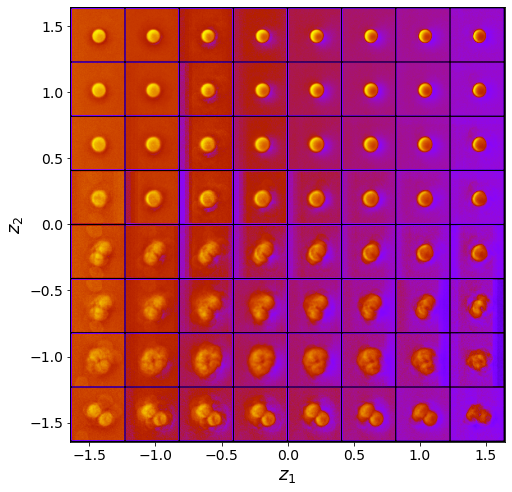

Epoch: 3001 Training loss: 974.4970
Epoch: 3002 Training loss: 974.0963
Epoch: 3003 Training loss: 974.0811
Epoch: 3004 Training loss: 974.1930
Epoch: 3005 Training loss: 974.4866
Epoch: 3006 Training loss: 974.5497
Epoch: 3007 Training loss: 974.4874
Epoch: 3008 Training loss: 974.3087
Epoch: 3009 Training loss: 974.2333
Epoch: 3010 Training loss: 974.1220
Epoch: 3011 Training loss: 974.1373
Epoch: 3012 Training loss: 974.5067
Epoch: 3013 Training loss: 975.0639
Epoch: 3014 Training loss: 974.7535
Epoch: 3015 Training loss: 974.2421
Epoch: 3016 Training loss: 974.1661
Epoch: 3017 Training loss: 974.2124
Epoch: 3018 Training loss: 974.1651
Epoch: 3019 Training loss: 974.2061
Epoch: 3020 Training loss: 974.2994
Epoch: 3021 Training loss: 974.1885
Epoch: 3022 Training loss: 974.3058
Epoch: 3023 Training loss: 974.2999
Epoch: 3024 Training loss: 974.3531
Epoch: 3025 Training loss: 974.4944
Epoch: 3026 Training loss: 974.1707
Epoch: 3027 Training loss: 974.3701
Epoch: 3028 Training loss: 9

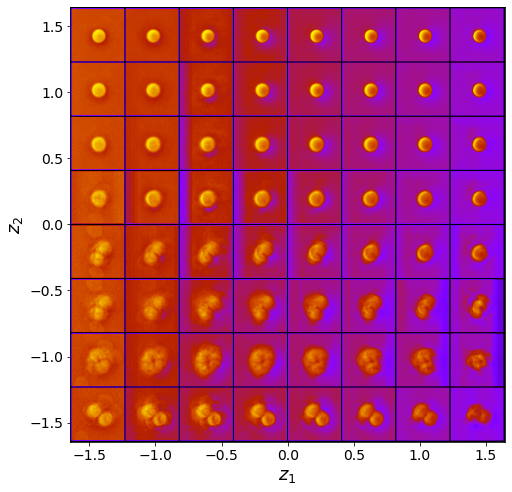

Epoch: 3051 Training loss: 974.0846
Epoch: 3052 Training loss: 973.9812
Epoch: 3053 Training loss: 973.9549
Epoch: 3054 Training loss: 973.9485
Epoch: 3055 Training loss: 973.9505
Epoch: 3056 Training loss: 973.9436
Epoch: 3057 Training loss: 974.0157
Epoch: 3058 Training loss: 973.9608
Epoch: 3059 Training loss: 974.4328
Epoch: 3060 Training loss: 974.1568
Epoch: 3061 Training loss: 973.9986
Epoch: 3062 Training loss: 973.9120
Epoch: 3063 Training loss: 973.8832
Epoch: 3064 Training loss: 973.9641
Epoch: 3065 Training loss: 973.8722
Epoch: 3066 Training loss: 974.0063
Epoch: 3067 Training loss: 974.0658
Epoch: 3068 Training loss: 974.2828
Epoch: 3069 Training loss: 973.8908
Epoch: 3070 Training loss: 974.0014
Epoch: 3071 Training loss: 973.9755
Epoch: 3072 Training loss: 973.8552
Epoch: 3073 Training loss: 973.9245
Epoch: 3074 Training loss: 974.2337
Epoch: 3075 Training loss: 974.4316
Epoch: 3076 Training loss: 974.0948
Epoch: 3077 Training loss: 974.0614
Epoch: 3078 Training loss: 9

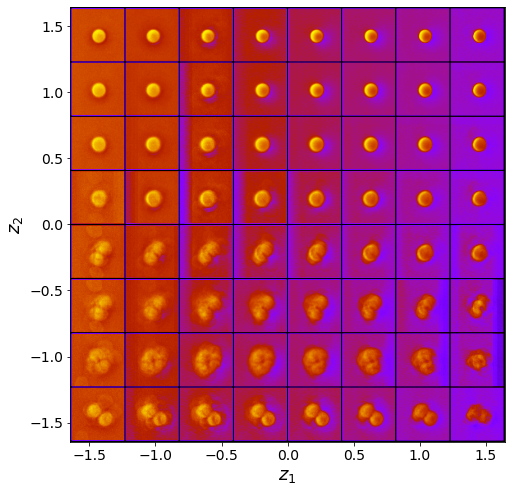

Epoch: 3101 Training loss: 974.0619
Epoch: 3102 Training loss: 973.8028
Epoch: 3103 Training loss: 974.0463
Epoch: 3104 Training loss: 973.8950
Epoch: 3105 Training loss: 973.8145
Epoch: 3106 Training loss: 973.7672
Epoch: 3107 Training loss: 973.7567
Epoch: 3108 Training loss: 973.9347
Epoch: 3109 Training loss: 973.9028
Epoch: 3110 Training loss: 974.0138
Epoch: 3111 Training loss: 974.2158
Epoch: 3112 Training loss: 973.9511
Epoch: 3113 Training loss: 973.8118
Epoch: 3114 Training loss: 973.7766
Epoch: 3115 Training loss: 974.2343
Epoch: 3116 Training loss: 974.0822
Epoch: 3117 Training loss: 974.4187
Epoch: 3118 Training loss: 973.7796
Epoch: 3119 Training loss: 974.0254
Epoch: 3120 Training loss: 973.8144
Epoch: 3121 Training loss: 973.8256
Epoch: 3122 Training loss: 974.1790
Epoch: 3123 Training loss: 973.8974
Epoch: 3124 Training loss: 973.6431
Epoch: 3125 Training loss: 973.6197
Epoch: 3126 Training loss: 973.9074
Epoch: 3127 Training loss: 973.6883
Epoch: 3128 Training loss: 9

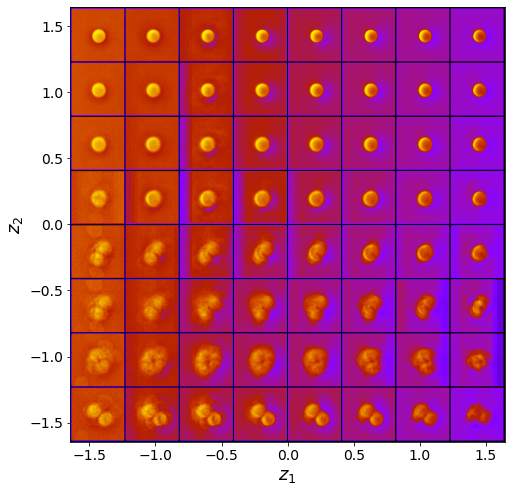

Epoch: 3151 Training loss: 973.9716
Epoch: 3152 Training loss: 973.8093
Epoch: 3153 Training loss: 973.8492
Epoch: 3154 Training loss: 973.9163
Epoch: 3155 Training loss: 973.8320
Epoch: 3156 Training loss: 973.6999
Epoch: 3157 Training loss: 973.8178
Epoch: 3158 Training loss: 973.7795
Epoch: 3159 Training loss: 975.1119
Epoch: 3160 Training loss: 974.2069
Epoch: 3161 Training loss: 974.0728
Epoch: 3162 Training loss: 974.1301
Epoch: 3163 Training loss: 973.9570
Epoch: 3164 Training loss: 973.6322
Epoch: 3165 Training loss: 973.5665
Epoch: 3166 Training loss: 973.5590
Epoch: 3167 Training loss: 973.7048
Epoch: 3168 Training loss: 973.8908
Epoch: 3169 Training loss: 973.6124
Epoch: 3170 Training loss: 973.5825
Epoch: 3171 Training loss: 973.6406
Epoch: 3172 Training loss: 973.9085
Epoch: 3173 Training loss: 973.9100
Epoch: 3174 Training loss: 973.8989
Epoch: 3175 Training loss: 974.2455
Epoch: 3176 Training loss: 973.9099
Epoch: 3177 Training loss: 974.0976
Epoch: 3178 Training loss: 9

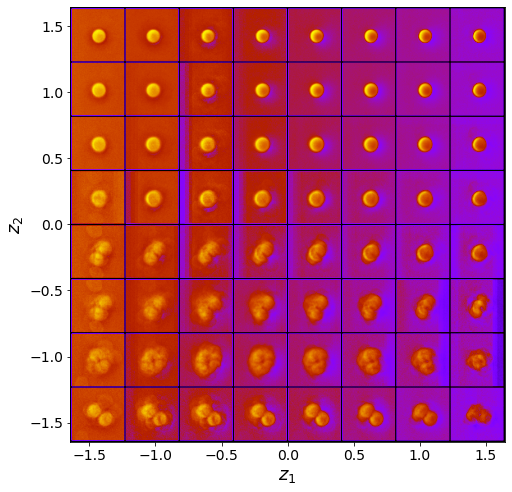

Epoch: 3201 Training loss: 974.1075
Epoch: 3202 Training loss: 973.6645
Epoch: 3203 Training loss: 973.7893
Epoch: 3204 Training loss: 973.4842
Epoch: 3205 Training loss: 973.4526
Epoch: 3206 Training loss: 973.3968
Epoch: 3207 Training loss: 973.4695
Epoch: 3208 Training loss: 973.4337
Epoch: 3209 Training loss: 973.3872
Epoch: 3210 Training loss: 973.4063
Epoch: 3211 Training loss: 973.3722
Epoch: 3212 Training loss: 973.7108
Epoch: 3213 Training loss: 973.5071
Epoch: 3214 Training loss: 973.8822
Epoch: 3215 Training loss: 973.8250
Epoch: 3216 Training loss: 973.4172
Epoch: 3217 Training loss: 973.5104
Epoch: 3218 Training loss: 973.6844
Epoch: 3219 Training loss: 973.3010
Epoch: 3220 Training loss: 973.3186
Epoch: 3221 Training loss: 973.4342
Epoch: 3222 Training loss: 973.3096
Epoch: 3223 Training loss: 973.3395
Epoch: 3224 Training loss: 973.4689
Epoch: 3225 Training loss: 973.7378
Epoch: 3226 Training loss: 973.3828
Epoch: 3227 Training loss: 973.6473
Epoch: 3228 Training loss: 9

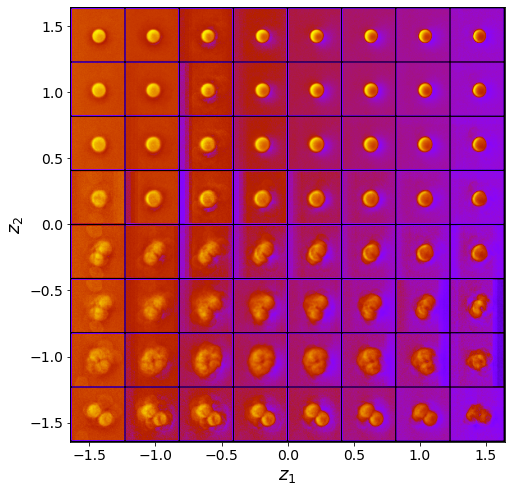

Epoch: 3251 Training loss: 974.1070
Epoch: 3252 Training loss: 973.9169
Epoch: 3253 Training loss: 973.6617
Epoch: 3254 Training loss: 973.2360
Epoch: 3255 Training loss: 973.2718
Epoch: 3256 Training loss: 973.8002
Epoch: 3257 Training loss: 973.7134
Epoch: 3258 Training loss: 973.6048
Epoch: 3259 Training loss: 974.1340
Epoch: 3260 Training loss: 973.9460
Epoch: 3261 Training loss: 974.9381
Epoch: 3262 Training loss: 973.4265
Epoch: 3263 Training loss: 973.4774
Epoch: 3264 Training loss: 973.3334
Epoch: 3265 Training loss: 973.4159
Epoch: 3266 Training loss: 973.3725
Epoch: 3267 Training loss: 973.6509
Epoch: 3268 Training loss: 973.4298
Epoch: 3269 Training loss: 973.4655
Epoch: 3270 Training loss: 973.2978
Epoch: 3271 Training loss: 973.3239
Epoch: 3272 Training loss: 973.1544
Epoch: 3273 Training loss: 973.1453
Epoch: 3274 Training loss: 973.8871
Epoch: 3275 Training loss: 973.7757
Epoch: 3276 Training loss: 973.6391
Epoch: 3277 Training loss: 973.3665
Epoch: 3278 Training loss: 9

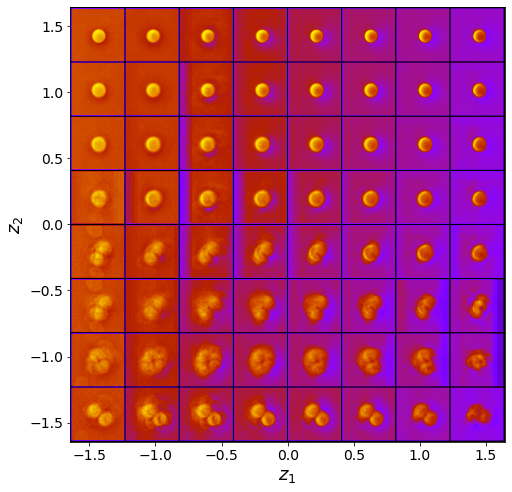

Epoch: 3301 Training loss: 972.9932
Epoch: 3302 Training loss: 973.1147
Epoch: 3303 Training loss: 973.2601
Epoch: 3304 Training loss: 973.0509
Epoch: 3305 Training loss: 973.0644
Epoch: 3306 Training loss: 973.2293
Epoch: 3307 Training loss: 973.2378
Epoch: 3308 Training loss: 973.2201
Epoch: 3309 Training loss: 973.1196
Epoch: 3310 Training loss: 973.6510
Epoch: 3311 Training loss: 973.3216
Epoch: 3312 Training loss: 974.1328
Epoch: 3313 Training loss: 973.7418
Epoch: 3314 Training loss: 973.7016
Epoch: 3315 Training loss: 973.2538
Epoch: 3316 Training loss: 973.2022
Epoch: 3317 Training loss: 973.2494
Epoch: 3318 Training loss: 973.1766
Epoch: 3319 Training loss: 973.0250
Epoch: 3320 Training loss: 973.0814
Epoch: 3321 Training loss: 973.4868
Epoch: 3322 Training loss: 973.2021
Epoch: 3323 Training loss: 972.9912
Epoch: 3324 Training loss: 973.0733
Epoch: 3325 Training loss: 973.2569
Epoch: 3326 Training loss: 973.0366
Epoch: 3327 Training loss: 973.1222
Epoch: 3328 Training loss: 9

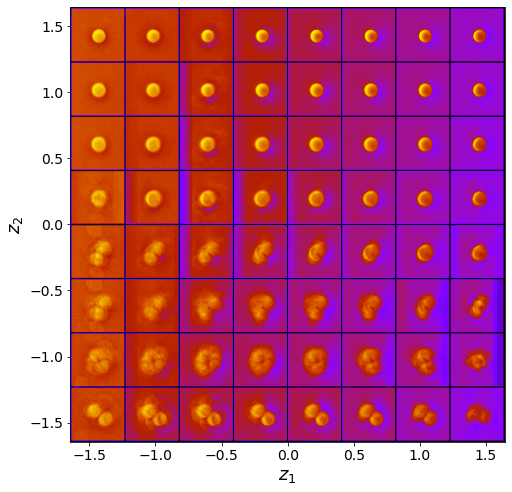

Epoch: 3351 Training loss: 973.0611
Epoch: 3352 Training loss: 972.8955
Epoch: 3353 Training loss: 972.8618
Epoch: 3354 Training loss: 972.9144
Epoch: 3355 Training loss: 973.0867
Epoch: 3356 Training loss: 972.9272
Epoch: 3357 Training loss: 972.9882
Epoch: 3358 Training loss: 972.9260
Epoch: 3359 Training loss: 973.0250
Epoch: 3360 Training loss: 972.9290
Epoch: 3361 Training loss: 973.1642
Epoch: 3362 Training loss: 973.1389
Epoch: 3363 Training loss: 973.3817
Epoch: 3364 Training loss: 973.0347
Epoch: 3365 Training loss: 972.9085
Epoch: 3366 Training loss: 973.0193
Epoch: 3367 Training loss: 972.8613
Epoch: 3368 Training loss: 973.4442
Epoch: 3369 Training loss: 973.1251
Epoch: 3370 Training loss: 973.1898
Epoch: 3371 Training loss: 973.1314
Epoch: 3372 Training loss: 973.7602
Epoch: 3373 Training loss: 973.1987
Epoch: 3374 Training loss: 972.9299
Epoch: 3375 Training loss: 972.7927
Epoch: 3376 Training loss: 972.9623
Epoch: 3377 Training loss: 972.8363
Epoch: 3378 Training loss: 9

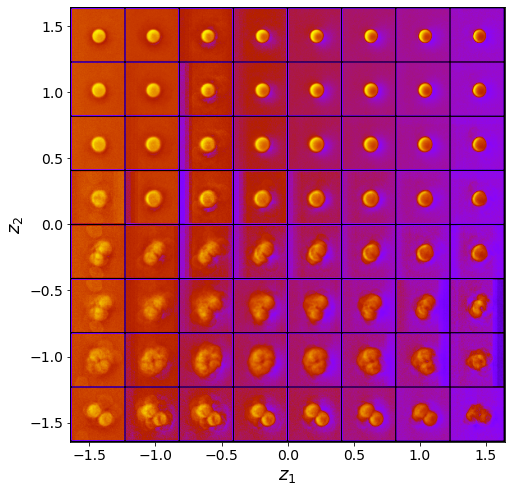

Epoch: 3401 Training loss: 972.8775
Epoch: 3402 Training loss: 972.8089
Epoch: 3403 Training loss: 972.9256
Epoch: 3404 Training loss: 972.8739
Epoch: 3405 Training loss: 972.8205
Epoch: 3406 Training loss: 972.9639
Epoch: 3407 Training loss: 973.0513
Epoch: 3408 Training loss: 973.0380
Epoch: 3409 Training loss: 973.6448
Epoch: 3410 Training loss: 977.1637
Epoch: 3411 Training loss: 974.6902
Epoch: 3412 Training loss: 974.4553
Epoch: 3413 Training loss: 974.2085
Epoch: 3414 Training loss: 974.6856
Epoch: 3415 Training loss: 976.8575
Epoch: 3416 Training loss: 974.8442
Epoch: 3417 Training loss: 974.1705
Epoch: 3418 Training loss: 973.5881
Epoch: 3419 Training loss: 973.3251
Epoch: 3420 Training loss: 973.0209
Epoch: 3421 Training loss: 973.2192
Epoch: 3422 Training loss: 973.1959
Epoch: 3423 Training loss: 972.7094
Epoch: 3424 Training loss: 972.6795
Epoch: 3425 Training loss: 972.6985
Epoch: 3426 Training loss: 972.7521
Epoch: 3427 Training loss: 972.8684
Epoch: 3428 Training loss: 9

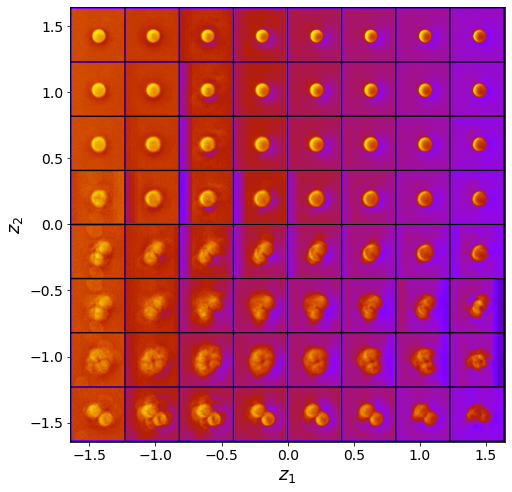

Epoch: 3451 Training loss: 973.0469
Epoch: 3452 Training loss: 972.7717
Epoch: 3453 Training loss: 972.7682
Epoch: 3454 Training loss: 972.9074
Epoch: 3455 Training loss: 973.0864
Epoch: 3456 Training loss: 972.8012
Epoch: 3457 Training loss: 972.8802
Epoch: 3458 Training loss: 973.1635
Epoch: 3459 Training loss: 972.9815
Epoch: 3460 Training loss: 973.0149
Epoch: 3461 Training loss: 972.6240
Epoch: 3462 Training loss: 972.5655
Epoch: 3463 Training loss: 972.7251
Epoch: 3464 Training loss: 972.6543
Epoch: 3465 Training loss: 972.6914
Epoch: 3466 Training loss: 972.7598
Epoch: 3467 Training loss: 972.7625
Epoch: 3468 Training loss: 972.9155
Epoch: 3469 Training loss: 972.7246
Epoch: 3470 Training loss: 972.8604
Epoch: 3471 Training loss: 973.1402
Epoch: 3472 Training loss: 973.3957
Epoch: 3473 Training loss: 973.2148
Epoch: 3474 Training loss: 973.2270
Epoch: 3475 Training loss: 973.2914
Epoch: 3476 Training loss: 973.6492
Epoch: 3477 Training loss: 973.8406
Epoch: 3478 Training loss: 9

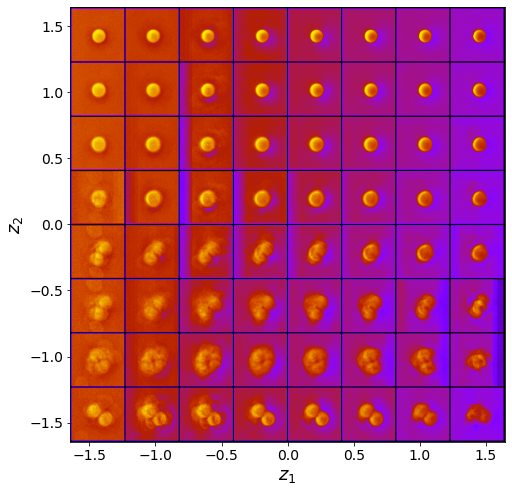

Epoch: 3501 Training loss: 972.6252
Epoch: 3502 Training loss: 972.5368
Epoch: 3503 Training loss: 972.4900
Epoch: 3504 Training loss: 972.6271
Epoch: 3505 Training loss: 972.7628
Epoch: 3506 Training loss: 972.7411
Epoch: 3507 Training loss: 972.6158
Epoch: 3508 Training loss: 972.4919
Epoch: 3509 Training loss: 972.6150
Epoch: 3510 Training loss: 972.3453
Epoch: 3511 Training loss: 972.4045
Epoch: 3512 Training loss: 972.5406
Epoch: 3513 Training loss: 972.3184
Epoch: 3514 Training loss: 972.5171
Epoch: 3515 Training loss: 972.7473
Epoch: 3516 Training loss: 972.7853
Epoch: 3517 Training loss: 972.4370
Epoch: 3518 Training loss: 972.5708
Epoch: 3519 Training loss: 972.5303
Epoch: 3520 Training loss: 972.8298
Epoch: 3521 Training loss: 972.8407
Epoch: 3522 Training loss: 972.8969
Epoch: 3523 Training loss: 972.6470
Epoch: 3524 Training loss: 972.4225
Epoch: 3525 Training loss: 972.4301
Epoch: 3526 Training loss: 972.6515
Epoch: 3527 Training loss: 972.7068
Epoch: 3528 Training loss: 9

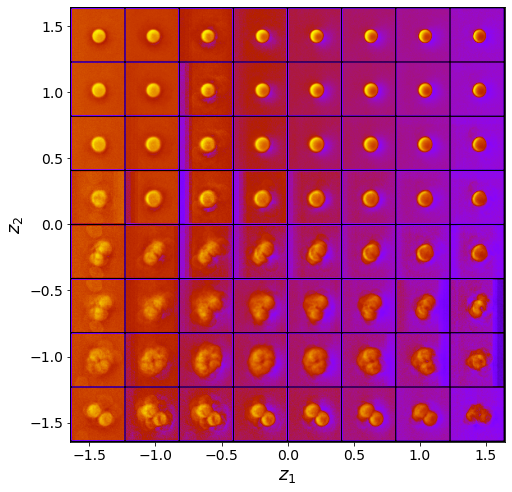

Epoch: 3551 Training loss: 972.3378
Epoch: 3552 Training loss: 972.4739
Epoch: 3553 Training loss: 972.7715
Epoch: 3554 Training loss: 972.5090
Epoch: 3555 Training loss: 972.3794
Epoch: 3556 Training loss: 972.5699
Epoch: 3557 Training loss: 972.3848
Epoch: 3558 Training loss: 972.4203
Epoch: 3559 Training loss: 972.4040
Epoch: 3560 Training loss: 972.6607
Epoch: 3561 Training loss: 972.3839
Epoch: 3562 Training loss: 972.3453
Epoch: 3563 Training loss: 972.5291
Epoch: 3564 Training loss: 973.1549
Epoch: 3565 Training loss: 973.3863
Epoch: 3566 Training loss: 972.6882
Epoch: 3567 Training loss: 972.5313
Epoch: 3568 Training loss: 972.6185
Epoch: 3569 Training loss: 972.4981
Epoch: 3570 Training loss: 972.7889
Epoch: 3571 Training loss: 972.6490
Epoch: 3572 Training loss: 972.4126
Epoch: 3573 Training loss: 972.7704
Epoch: 3574 Training loss: 972.9294
Epoch: 3575 Training loss: 972.6020
Epoch: 3576 Training loss: 973.2135
Epoch: 3577 Training loss: 972.8958
Epoch: 3578 Training loss: 9

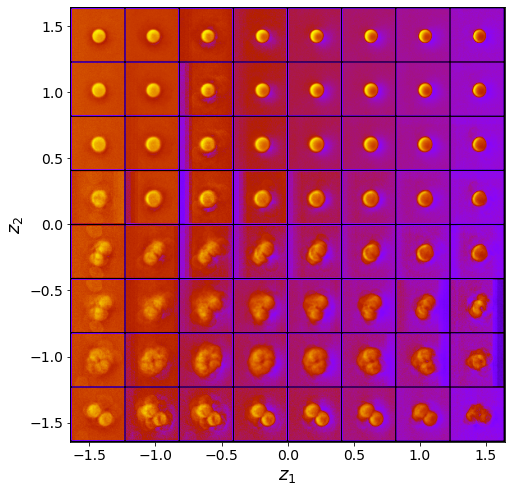

Epoch: 3601 Training loss: 972.5650
Epoch: 3602 Training loss: 972.5484
Epoch: 3603 Training loss: 972.2940
Epoch: 3604 Training loss: 972.2415
Epoch: 3605 Training loss: 972.1759
Epoch: 3606 Training loss: 972.1064
Epoch: 3607 Training loss: 972.2960
Epoch: 3608 Training loss: 972.1593
Epoch: 3609 Training loss: 972.1143
Epoch: 3610 Training loss: 972.1288
Epoch: 3611 Training loss: 972.1793
Epoch: 3612 Training loss: 972.4007
Epoch: 3613 Training loss: 972.3952
Epoch: 3614 Training loss: 972.3044
Epoch: 3615 Training loss: 972.2635
Epoch: 3616 Training loss: 972.5210
Epoch: 3617 Training loss: 972.2849
Epoch: 3618 Training loss: 972.2410
Epoch: 3619 Training loss: 972.2503
Epoch: 3620 Training loss: 972.4535
Epoch: 3621 Training loss: 972.3550
Epoch: 3622 Training loss: 972.1101
Epoch: 3623 Training loss: 972.0227
Epoch: 3624 Training loss: 972.1911
Epoch: 3625 Training loss: 972.2385
Epoch: 3626 Training loss: 972.0646
Epoch: 3627 Training loss: 972.4148
Epoch: 3628 Training loss: 9

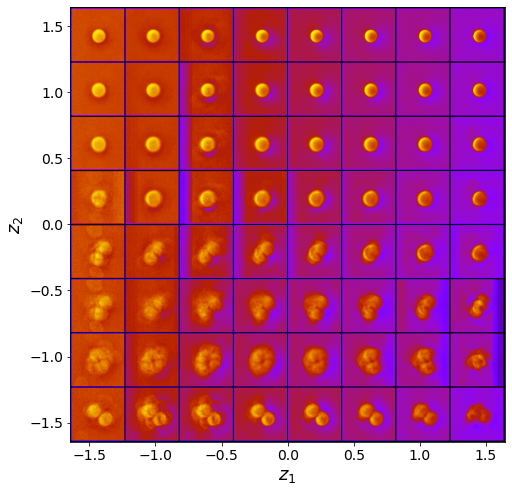

Epoch: 3651 Training loss: 972.0065
Epoch: 3652 Training loss: 971.9792
Epoch: 3653 Training loss: 972.1628
Epoch: 3654 Training loss: 972.5530
Epoch: 3655 Training loss: 972.3288
Epoch: 3656 Training loss: 972.5225
Epoch: 3657 Training loss: 972.4580
Epoch: 3658 Training loss: 972.7837
Epoch: 3659 Training loss: 972.6735
Epoch: 3660 Training loss: 972.5330
Epoch: 3661 Training loss: 972.5567
Epoch: 3662 Training loss: 972.2641
Epoch: 3663 Training loss: 972.4493
Epoch: 3664 Training loss: 972.2259
Epoch: 3665 Training loss: 971.9923
Epoch: 3666 Training loss: 972.1188
Epoch: 3667 Training loss: 972.0156
Epoch: 3668 Training loss: 972.2405
Epoch: 3669 Training loss: 971.9515
Epoch: 3670 Training loss: 972.0428
Epoch: 3671 Training loss: 972.0674
Epoch: 3672 Training loss: 972.1971
Epoch: 3673 Training loss: 972.0163
Epoch: 3674 Training loss: 971.9346
Epoch: 3675 Training loss: 972.3247
Epoch: 3676 Training loss: 972.0774
Epoch: 3677 Training loss: 972.0623
Epoch: 3678 Training loss: 9

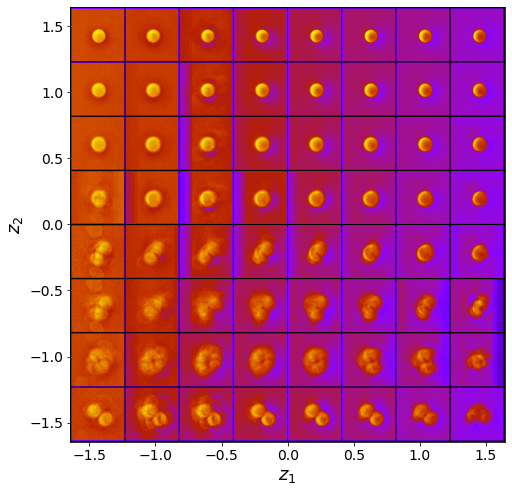

Epoch: 3701 Training loss: 971.9836
Epoch: 3702 Training loss: 972.0220
Epoch: 3703 Training loss: 972.2116
Epoch: 3704 Training loss: 972.7016
Epoch: 3705 Training loss: 973.6245
Epoch: 3706 Training loss: 973.1116
Epoch: 3707 Training loss: 972.6638
Epoch: 3708 Training loss: 972.4286
Epoch: 3709 Training loss: 972.8730
Epoch: 3710 Training loss: 972.4481
Epoch: 3711 Training loss: 971.9647
Epoch: 3712 Training loss: 971.8950
Epoch: 3713 Training loss: 971.9775
Epoch: 3714 Training loss: 972.0161
Epoch: 3715 Training loss: 971.8432
Epoch: 3716 Training loss: 971.9103
Epoch: 3717 Training loss: 971.8864
Epoch: 3718 Training loss: 971.7977
Epoch: 3719 Training loss: 971.7845
Epoch: 3720 Training loss: 971.7266
Epoch: 3721 Training loss: 971.8906
Epoch: 3722 Training loss: 971.8466
Epoch: 3723 Training loss: 971.7826
Epoch: 3724 Training loss: 971.7847
Epoch: 3725 Training loss: 972.0431
Epoch: 3726 Training loss: 971.9200
Epoch: 3727 Training loss: 972.2653
Epoch: 3728 Training loss: 9

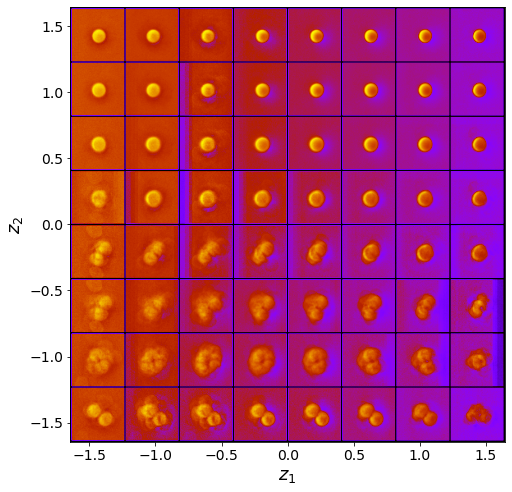

Epoch: 3751 Training loss: 971.6859
Epoch: 3752 Training loss: 971.7305
Epoch: 3753 Training loss: 971.7944
Epoch: 3754 Training loss: 971.9456
Epoch: 3755 Training loss: 971.7705
Epoch: 3756 Training loss: 972.0894
Epoch: 3757 Training loss: 972.0660
Epoch: 3758 Training loss: 971.9289
Epoch: 3759 Training loss: 971.9823
Epoch: 3760 Training loss: 971.8160
Epoch: 3761 Training loss: 972.1773
Epoch: 3762 Training loss: 972.2654
Epoch: 3763 Training loss: 972.1121
Epoch: 3764 Training loss: 972.3316
Epoch: 3765 Training loss: 972.3491
Epoch: 3766 Training loss: 971.8726
Epoch: 3767 Training loss: 971.7867
Epoch: 3768 Training loss: 972.0611
Epoch: 3769 Training loss: 971.8986
Epoch: 3770 Training loss: 972.3358
Epoch: 3771 Training loss: 972.6040
Epoch: 3772 Training loss: 972.5576
Epoch: 3773 Training loss: 972.2258
Epoch: 3774 Training loss: 972.0337
Epoch: 3775 Training loss: 972.0877
Epoch: 3776 Training loss: 972.0316
Epoch: 3777 Training loss: 971.9177
Epoch: 3778 Training loss: 9

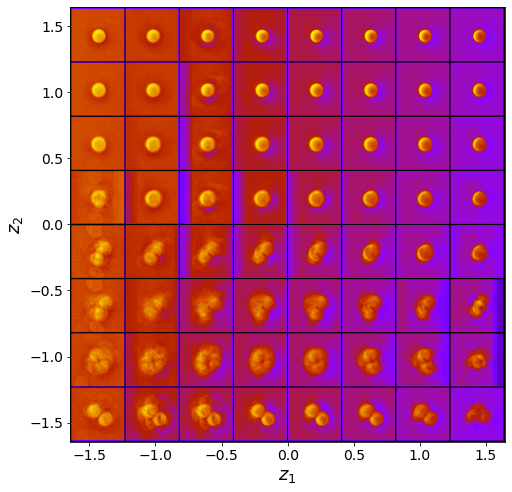

Epoch: 3801 Training loss: 972.4433
Epoch: 3802 Training loss: 971.9141
Epoch: 3803 Training loss: 971.6186
Epoch: 3804 Training loss: 971.6806
Epoch: 3805 Training loss: 971.8144
Epoch: 3806 Training loss: 971.6992
Epoch: 3807 Training loss: 971.8363
Epoch: 3808 Training loss: 971.9080
Epoch: 3809 Training loss: 971.7427
Epoch: 3810 Training loss: 971.6800
Epoch: 3811 Training loss: 971.5930
Epoch: 3812 Training loss: 971.7676
Epoch: 3813 Training loss: 971.7004
Epoch: 3814 Training loss: 972.0011
Epoch: 3815 Training loss: 971.7697
Epoch: 3816 Training loss: 971.6700
Epoch: 3817 Training loss: 971.5872
Epoch: 3818 Training loss: 971.7155
Epoch: 3819 Training loss: 972.1350
Epoch: 3820 Training loss: 972.3064
Epoch: 3821 Training loss: 971.9967
Epoch: 3822 Training loss: 971.6511
Epoch: 3823 Training loss: 971.6470
Epoch: 3824 Training loss: 971.4703
Epoch: 3825 Training loss: 971.8990
Epoch: 3826 Training loss: 972.0505
Epoch: 3827 Training loss: 971.9138
Epoch: 3828 Training loss: 9

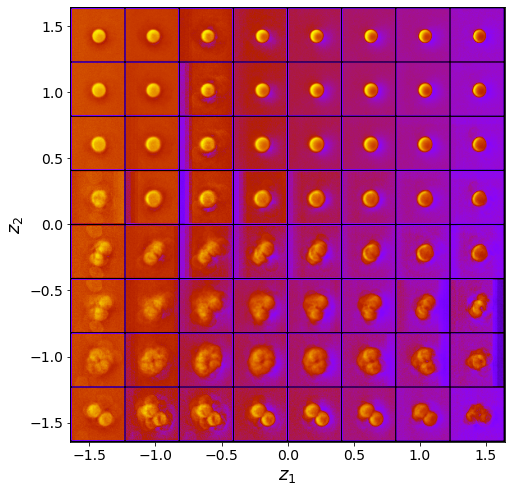

Epoch: 3851 Training loss: 971.4260
Epoch: 3852 Training loss: 971.3745
Epoch: 3853 Training loss: 971.4291
Epoch: 3854 Training loss: 971.3193
Epoch: 3855 Training loss: 971.4797
Epoch: 3856 Training loss: 971.4439
Epoch: 3857 Training loss: 971.6678
Epoch: 3858 Training loss: 971.6347
Epoch: 3859 Training loss: 971.6060
Epoch: 3860 Training loss: 971.7299
Epoch: 3861 Training loss: 971.9499
Epoch: 3862 Training loss: 972.1925
Epoch: 3863 Training loss: 972.1686
Epoch: 3864 Training loss: 971.7136
Epoch: 3865 Training loss: 971.5216
Epoch: 3866 Training loss: 971.4475
Epoch: 3867 Training loss: 971.6369
Epoch: 3868 Training loss: 971.4350
Epoch: 3869 Training loss: 972.1575
Epoch: 3870 Training loss: 972.0415
Epoch: 3871 Training loss: 972.0465
Epoch: 3872 Training loss: 971.9374
Epoch: 3873 Training loss: 971.6118
Epoch: 3874 Training loss: 971.3178
Epoch: 3875 Training loss: 971.4916
Epoch: 3876 Training loss: 971.4828
Epoch: 3877 Training loss: 971.5994
Epoch: 3878 Training loss: 9

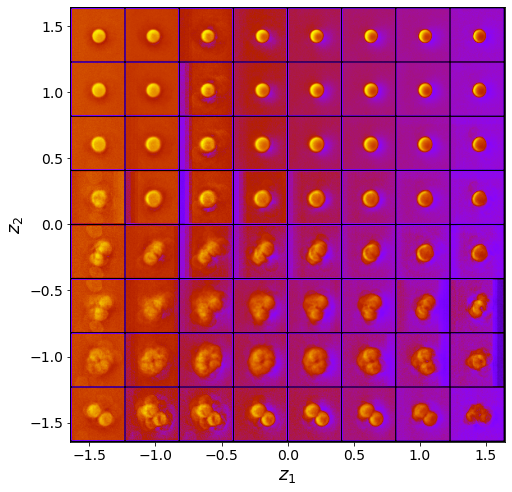

Epoch: 3901 Training loss: 971.3498
Epoch: 3902 Training loss: 971.6641
Epoch: 3903 Training loss: 971.4343
Epoch: 3904 Training loss: 971.5141
Epoch: 3905 Training loss: 971.4206
Epoch: 3906 Training loss: 971.4537
Epoch: 3907 Training loss: 971.4852
Epoch: 3908 Training loss: 971.7467
Epoch: 3909 Training loss: 971.5129
Epoch: 3910 Training loss: 971.4490
Epoch: 3911 Training loss: 971.4251
Epoch: 3912 Training loss: 971.8223
Epoch: 3913 Training loss: 971.4253
Epoch: 3914 Training loss: 971.5019
Epoch: 3915 Training loss: 971.6490
Epoch: 3916 Training loss: 971.8695
Epoch: 3917 Training loss: 972.0785
Epoch: 3918 Training loss: 971.9850
Epoch: 3919 Training loss: 971.4330
Epoch: 3920 Training loss: 971.8373
Epoch: 3921 Training loss: 971.6231
Epoch: 3922 Training loss: 971.6909
Epoch: 3923 Training loss: 971.6951
Epoch: 3924 Training loss: 971.6356
Epoch: 3925 Training loss: 971.4121
Epoch: 3926 Training loss: 972.1573
Epoch: 3927 Training loss: 972.5114
Epoch: 3928 Training loss: 9

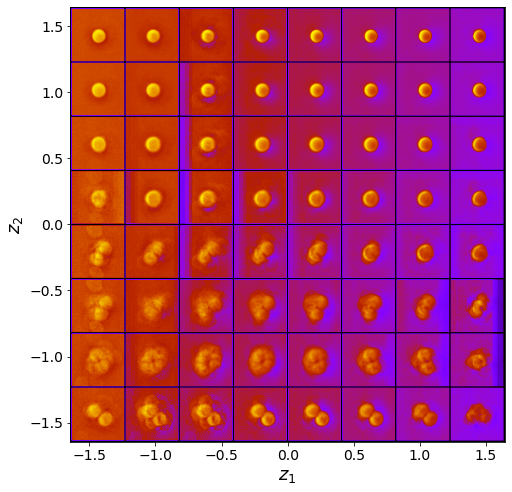

Epoch: 3951 Training loss: 971.2483
Epoch: 3952 Training loss: 971.4333
Epoch: 3953 Training loss: 971.4561
Epoch: 3954 Training loss: 971.2977
Epoch: 3955 Training loss: 971.4837
Epoch: 3956 Training loss: 971.6663
Epoch: 3957 Training loss: 971.9046
Epoch: 3958 Training loss: 971.9593
Epoch: 3959 Training loss: 973.4070
Epoch: 3960 Training loss: 974.2681
Epoch: 3961 Training loss: 974.6857
Epoch: 3962 Training loss: 975.4489
Epoch: 3963 Training loss: 973.8477
Epoch: 3964 Training loss: 972.0188
Epoch: 3965 Training loss: 972.6017
Epoch: 3966 Training loss: 972.3125
Epoch: 3967 Training loss: 971.9906
Epoch: 3968 Training loss: 971.7148
Epoch: 3969 Training loss: 971.2875
Epoch: 3970 Training loss: 971.3519
Epoch: 3971 Training loss: 971.1274
Epoch: 3972 Training loss: 971.3176
Epoch: 3973 Training loss: 971.2082
Epoch: 3974 Training loss: 971.2171
Epoch: 3975 Training loss: 971.2228
Epoch: 3976 Training loss: 971.1735
Epoch: 3977 Training loss: 971.0526
Epoch: 3978 Training loss: 9

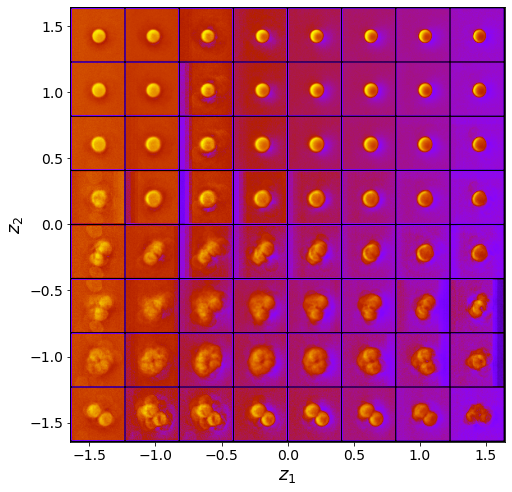

Epoch: 4001 Training loss: 971.2083
Epoch: 4002 Training loss: 970.9539
Epoch: 4003 Training loss: 971.0152
Epoch: 4004 Training loss: 971.0795
Epoch: 4005 Training loss: 971.0500
Epoch: 4006 Training loss: 970.9496
Epoch: 4007 Training loss: 971.0586
Epoch: 4008 Training loss: 971.0952
Epoch: 4009 Training loss: 971.0710
Epoch: 4010 Training loss: 971.0293
Epoch: 4011 Training loss: 971.4958
Epoch: 4012 Training loss: 971.2812
Epoch: 4013 Training loss: 971.2721
Epoch: 4014 Training loss: 970.9485
Epoch: 4015 Training loss: 970.9584
Epoch: 4016 Training loss: 971.0135
Epoch: 4017 Training loss: 970.9078
Epoch: 4018 Training loss: 970.9908
Epoch: 4019 Training loss: 970.9401
Epoch: 4020 Training loss: 971.1397
Epoch: 4021 Training loss: 971.0717
Epoch: 4022 Training loss: 971.3001
Epoch: 4023 Training loss: 971.0729
Epoch: 4024 Training loss: 971.0887
Epoch: 4025 Training loss: 970.9833
Epoch: 4026 Training loss: 970.8837
Epoch: 4027 Training loss: 971.0990
Epoch: 4028 Training loss: 9

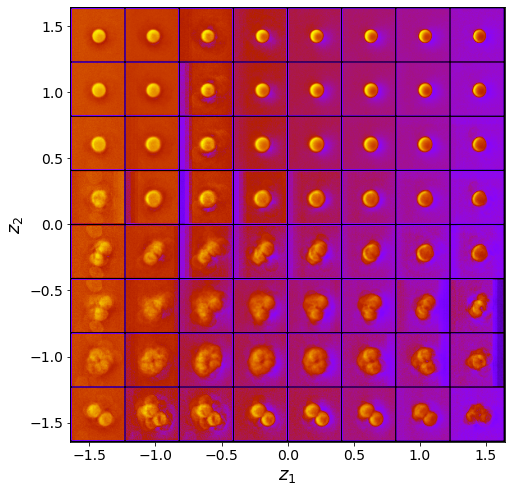

Epoch: 4051 Training loss: 971.0650
Epoch: 4052 Training loss: 971.0262
Epoch: 4053 Training loss: 970.9845
Epoch: 4054 Training loss: 971.0286
Epoch: 4055 Training loss: 971.5870
Epoch: 4056 Training loss: 971.5193
Epoch: 4057 Training loss: 971.0403
Epoch: 4058 Training loss: 971.5292
Epoch: 4059 Training loss: 971.4315
Epoch: 4060 Training loss: 971.1394
Epoch: 4061 Training loss: 970.9743
Epoch: 4062 Training loss: 970.8971
Epoch: 4063 Training loss: 970.7261
Epoch: 4064 Training loss: 970.7548
Epoch: 4065 Training loss: 970.8189
Epoch: 4066 Training loss: 970.7966
Epoch: 4067 Training loss: 970.8722
Epoch: 4068 Training loss: 970.9968
Epoch: 4069 Training loss: 970.9853
Epoch: 4070 Training loss: 970.9726
Epoch: 4071 Training loss: 970.8471
Epoch: 4072 Training loss: 970.8665
Epoch: 4073 Training loss: 971.0443
Epoch: 4074 Training loss: 970.7467
Epoch: 4075 Training loss: 970.7223
Epoch: 4076 Training loss: 970.7702
Epoch: 4077 Training loss: 970.9878
Epoch: 4078 Training loss: 9

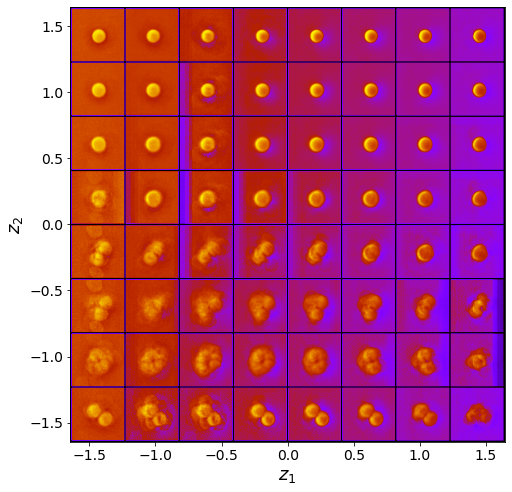

Epoch: 4101 Training loss: 971.3711
Epoch: 4102 Training loss: 971.4934
Epoch: 4103 Training loss: 971.7503
Epoch: 4104 Training loss: 973.2516
Epoch: 4105 Training loss: 971.1840
Epoch: 4106 Training loss: 970.9650
Epoch: 4107 Training loss: 970.8381
Epoch: 4108 Training loss: 970.9252
Epoch: 4109 Training loss: 970.7315
Epoch: 4110 Training loss: 970.9378
Epoch: 4111 Training loss: 970.9490
Epoch: 4112 Training loss: 970.9734
Epoch: 4113 Training loss: 970.6880
Epoch: 4114 Training loss: 970.6743
Epoch: 4115 Training loss: 970.9453
Epoch: 4116 Training loss: 970.8950
Epoch: 4117 Training loss: 970.7125
Epoch: 4118 Training loss: 970.6906
Epoch: 4119 Training loss: 970.6751
Epoch: 4120 Training loss: 970.6032
Epoch: 4121 Training loss: 970.5771
Epoch: 4122 Training loss: 970.6852
Epoch: 4123 Training loss: 970.7450
Epoch: 4124 Training loss: 970.8463
Epoch: 4125 Training loss: 970.7287
Epoch: 4126 Training loss: 970.7955
Epoch: 4127 Training loss: 971.1130
Epoch: 4128 Training loss: 9

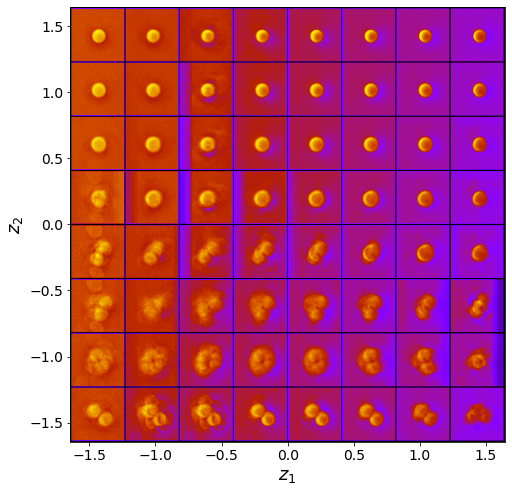

Epoch: 4151 Training loss: 970.9238
Epoch: 4152 Training loss: 970.7128
Epoch: 4153 Training loss: 970.5810
Epoch: 4154 Training loss: 970.5072
Epoch: 4155 Training loss: 970.6254
Epoch: 4156 Training loss: 970.6136
Epoch: 4157 Training loss: 970.7157
Epoch: 4158 Training loss: 970.7297
Epoch: 4159 Training loss: 970.6977
Epoch: 4160 Training loss: 970.7571
Epoch: 4161 Training loss: 971.2740
Epoch: 4162 Training loss: 971.8314
Epoch: 4163 Training loss: 971.5107
Epoch: 4164 Training loss: 972.4218
Epoch: 4165 Training loss: 971.9502
Epoch: 4166 Training loss: 973.3004
Epoch: 4167 Training loss: 973.9123
Epoch: 4168 Training loss: 972.7960
Epoch: 4169 Training loss: 972.7462
Epoch: 4170 Training loss: 971.2943
Epoch: 4171 Training loss: 970.8793
Epoch: 4172 Training loss: 970.7477
Epoch: 4173 Training loss: 970.5517
Epoch: 4174 Training loss: 970.6012
Epoch: 4175 Training loss: 970.7308
Epoch: 4176 Training loss: 970.9532
Epoch: 4177 Training loss: 970.9111
Epoch: 4178 Training loss: 9

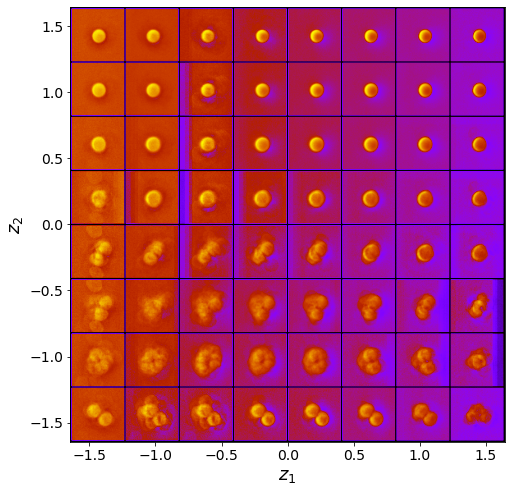

Epoch: 4201 Training loss: 971.1564
Epoch: 4202 Training loss: 971.0149
Epoch: 4203 Training loss: 971.1138
Epoch: 4204 Training loss: 971.1436
Epoch: 4205 Training loss: 971.2185
Epoch: 4206 Training loss: 971.1322
Epoch: 4207 Training loss: 971.0290
Epoch: 4208 Training loss: 971.1082
Epoch: 4209 Training loss: 970.9043
Epoch: 4210 Training loss: 970.9131
Epoch: 4211 Training loss: 970.9569
Epoch: 4212 Training loss: 971.1292
Epoch: 4213 Training loss: 971.3227
Epoch: 4214 Training loss: 970.8771
Epoch: 4215 Training loss: 970.8196
Epoch: 4216 Training loss: 970.8565
Epoch: 4217 Training loss: 970.5079
Epoch: 4218 Training loss: 970.4483
Epoch: 4219 Training loss: 970.5204
Epoch: 4220 Training loss: 971.1811
Epoch: 4221 Training loss: 971.9859
Epoch: 4222 Training loss: 970.9808
Epoch: 4223 Training loss: 970.6476
Epoch: 4224 Training loss: 970.9122
Epoch: 4225 Training loss: 970.8604
Epoch: 4226 Training loss: 970.8596
Epoch: 4227 Training loss: 970.7333
Epoch: 4228 Training loss: 9

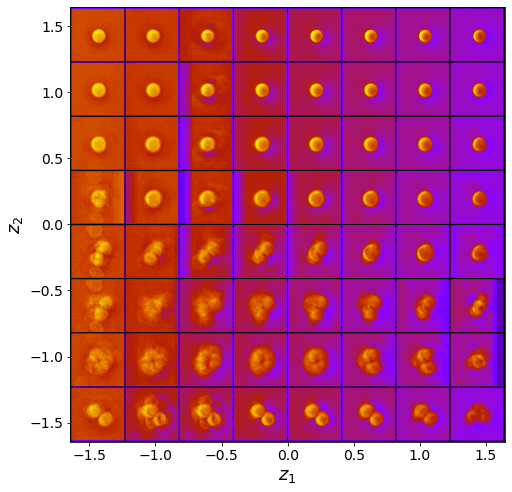

Epoch: 4251 Training loss: 970.3102
Epoch: 4252 Training loss: 970.3241
Epoch: 4253 Training loss: 970.4965
Epoch: 4254 Training loss: 970.6759
Epoch: 4255 Training loss: 970.5945
Epoch: 4256 Training loss: 970.4554
Epoch: 4257 Training loss: 970.2843
Epoch: 4258 Training loss: 970.2561
Epoch: 4259 Training loss: 970.4120
Epoch: 4260 Training loss: 970.6066
Epoch: 4261 Training loss: 971.2523
Epoch: 4262 Training loss: 970.6127
Epoch: 4263 Training loss: 970.3637
Epoch: 4264 Training loss: 971.0829
Epoch: 4265 Training loss: 970.4340
Epoch: 4266 Training loss: 970.3584
Epoch: 4267 Training loss: 970.2910
Epoch: 4268 Training loss: 970.2560
Epoch: 4269 Training loss: 970.4065
Epoch: 4270 Training loss: 970.5400
Epoch: 4271 Training loss: 971.3635
Epoch: 4272 Training loss: 972.6787
Epoch: 4273 Training loss: 972.3572
Epoch: 4274 Training loss: 972.2680
Epoch: 4275 Training loss: 971.0091
Epoch: 4276 Training loss: 970.7137
Epoch: 4277 Training loss: 970.4127
Epoch: 4278 Training loss: 9

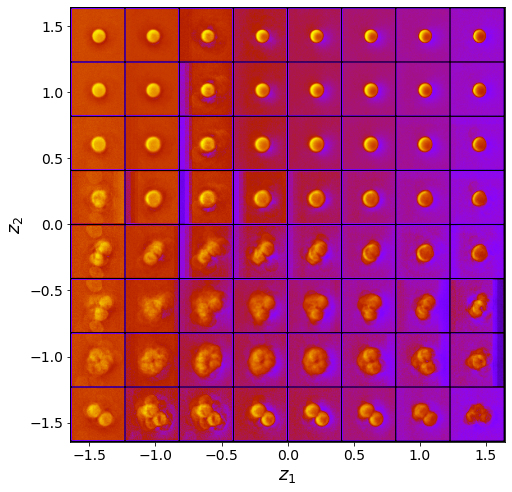

Epoch: 4301 Training loss: 970.4314
Epoch: 4302 Training loss: 970.3913
Epoch: 4303 Training loss: 970.6161
Epoch: 4304 Training loss: 970.9551
Epoch: 4305 Training loss: 971.0966
Epoch: 4306 Training loss: 970.6787
Epoch: 4307 Training loss: 970.6592
Epoch: 4308 Training loss: 970.6167
Epoch: 4309 Training loss: 970.4494
Epoch: 4310 Training loss: 970.6092
Epoch: 4311 Training loss: 970.3396
Epoch: 4312 Training loss: 970.1980
Epoch: 4313 Training loss: 970.2405
Epoch: 4314 Training loss: 970.1700
Epoch: 4315 Training loss: 970.3422
Epoch: 4316 Training loss: 970.2684
Epoch: 4317 Training loss: 970.1518
Epoch: 4318 Training loss: 970.1299
Epoch: 4319 Training loss: 970.1382
Epoch: 4320 Training loss: 970.4092
Epoch: 4321 Training loss: 970.8330
Epoch: 4322 Training loss: 970.9978
Epoch: 4323 Training loss: 970.8578
Epoch: 4324 Training loss: 970.8897
Epoch: 4325 Training loss: 971.2351
Epoch: 4326 Training loss: 970.3866
Epoch: 4327 Training loss: 970.3533
Epoch: 4328 Training loss: 9

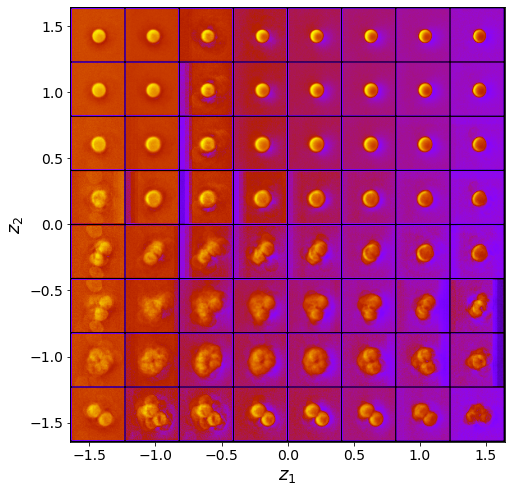

Epoch: 4351 Training loss: 971.6484
Epoch: 4352 Training loss: 971.3015
Epoch: 4353 Training loss: 970.4413
Epoch: 4354 Training loss: 970.3133
Epoch: 4355 Training loss: 970.3482
Epoch: 4356 Training loss: 970.4057
Epoch: 4357 Training loss: 970.2760
Epoch: 4358 Training loss: 970.5038
Epoch: 4359 Training loss: 970.7380
Epoch: 4360 Training loss: 970.7261
Epoch: 4361 Training loss: 970.3939
Epoch: 4362 Training loss: 970.5078
Epoch: 4363 Training loss: 970.1437
Epoch: 4364 Training loss: 970.0786
Epoch: 4365 Training loss: 970.3799
Epoch: 4366 Training loss: 970.6674
Epoch: 4367 Training loss: 970.5246
Epoch: 4368 Training loss: 970.4428
Epoch: 4369 Training loss: 970.2080
Epoch: 4370 Training loss: 970.1442
Epoch: 4371 Training loss: 970.0308
Epoch: 4372 Training loss: 970.1480
Epoch: 4373 Training loss: 970.1255
Epoch: 4374 Training loss: 970.0611
Epoch: 4375 Training loss: 970.3313
Epoch: 4376 Training loss: 970.1818
Epoch: 4377 Training loss: 970.0896
Epoch: 4378 Training loss: 9

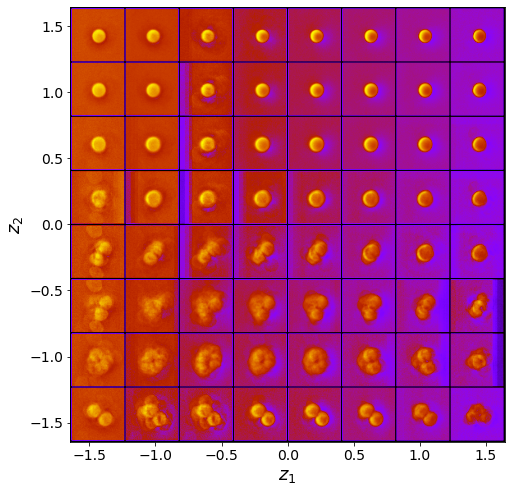

Epoch: 4401 Training loss: 970.3522
Epoch: 4402 Training loss: 970.2067
Epoch: 4403 Training loss: 969.9206
Epoch: 4404 Training loss: 969.8729
Epoch: 4405 Training loss: 969.9803
Epoch: 4406 Training loss: 970.3009
Epoch: 4407 Training loss: 970.1511
Epoch: 4408 Training loss: 969.9349
Epoch: 4409 Training loss: 970.1624
Epoch: 4410 Training loss: 970.0802
Epoch: 4411 Training loss: 969.9169
Epoch: 4412 Training loss: 969.8691
Epoch: 4413 Training loss: 969.8570
Epoch: 4414 Training loss: 969.9467
Epoch: 4415 Training loss: 969.8002
Epoch: 4416 Training loss: 970.0896
Epoch: 4417 Training loss: 970.7852
Epoch: 4418 Training loss: 970.1848
Epoch: 4419 Training loss: 969.9054
Epoch: 4420 Training loss: 970.0324
Epoch: 4421 Training loss: 969.9971
Epoch: 4422 Training loss: 969.9020
Epoch: 4423 Training loss: 969.9143
Epoch: 4424 Training loss: 969.8679
Epoch: 4425 Training loss: 970.0117
Epoch: 4426 Training loss: 970.0991
Epoch: 4427 Training loss: 969.9059
Epoch: 4428 Training loss: 9

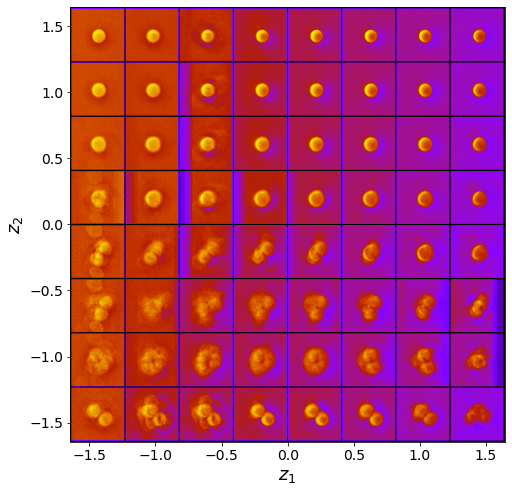

Epoch: 4451 Training loss: 969.8830
Epoch: 4452 Training loss: 969.7849
Epoch: 4453 Training loss: 969.8715
Epoch: 4454 Training loss: 970.0727
Epoch: 4455 Training loss: 969.8166
Epoch: 4456 Training loss: 969.8196
Epoch: 4457 Training loss: 969.8691
Epoch: 4458 Training loss: 970.0692
Epoch: 4459 Training loss: 969.8731
Epoch: 4460 Training loss: 970.1131
Epoch: 4461 Training loss: 970.5396
Epoch: 4462 Training loss: 970.9006
Epoch: 4463 Training loss: 973.6138
Epoch: 4464 Training loss: 972.7541
Epoch: 4465 Training loss: 971.8847
Epoch: 4466 Training loss: 970.6898
Epoch: 4467 Training loss: 970.1282
Epoch: 4468 Training loss: 970.2379
Epoch: 4469 Training loss: 970.0877
Epoch: 4470 Training loss: 970.5812
Epoch: 4471 Training loss: 970.4703
Epoch: 4472 Training loss: 970.1885
Epoch: 4473 Training loss: 969.9467
Epoch: 4474 Training loss: 969.8642
Epoch: 4475 Training loss: 969.7938
Epoch: 4476 Training loss: 969.7356
Epoch: 4477 Training loss: 969.8053
Epoch: 4478 Training loss: 9

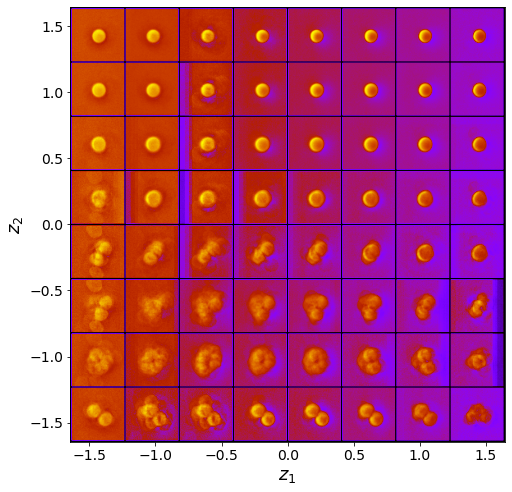

Epoch: 4501 Training loss: 970.2231
Epoch: 4502 Training loss: 969.9693
Epoch: 4503 Training loss: 969.9867
Epoch: 4504 Training loss: 969.9238
Epoch: 4505 Training loss: 970.2480
Epoch: 4506 Training loss: 970.0074
Epoch: 4507 Training loss: 969.8143
Epoch: 4508 Training loss: 969.7992
Epoch: 4509 Training loss: 970.0712
Epoch: 4510 Training loss: 970.3101
Epoch: 4511 Training loss: 970.2129
Epoch: 4512 Training loss: 969.8166
Epoch: 4513 Training loss: 969.9276
Epoch: 4514 Training loss: 969.6439
Epoch: 4515 Training loss: 969.7828
Epoch: 4516 Training loss: 970.0494
Epoch: 4517 Training loss: 970.4432
Epoch: 4518 Training loss: 969.8355
Epoch: 4519 Training loss: 969.9994
Epoch: 4520 Training loss: 970.0652
Epoch: 4521 Training loss: 969.8427
Epoch: 4522 Training loss: 969.8962
Epoch: 4523 Training loss: 969.7654
Epoch: 4524 Training loss: 969.7784
Epoch: 4525 Training loss: 969.7893
Epoch: 4526 Training loss: 969.8798
Epoch: 4527 Training loss: 969.6424
Epoch: 4528 Training loss: 9

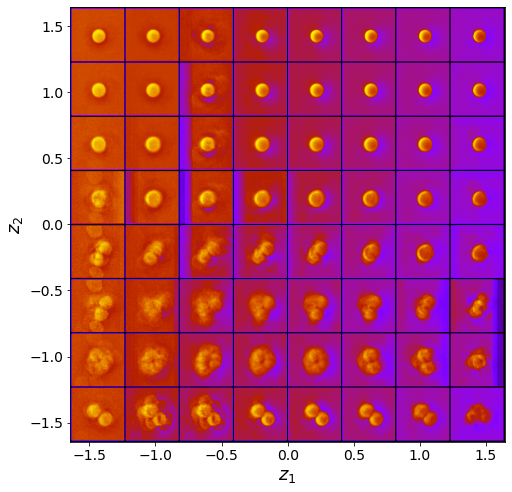

Epoch: 4551 Training loss: 969.7252
Epoch: 4552 Training loss: 969.6999
Epoch: 4553 Training loss: 969.6549
Epoch: 4554 Training loss: 969.6845
Epoch: 4555 Training loss: 969.7087
Epoch: 4556 Training loss: 969.6909
Epoch: 4557 Training loss: 969.6900
Epoch: 4558 Training loss: 969.8009
Epoch: 4559 Training loss: 969.7100
Epoch: 4560 Training loss: 969.9710
Epoch: 4561 Training loss: 970.8192
Epoch: 4562 Training loss: 969.9444
Epoch: 4563 Training loss: 969.6670
Epoch: 4564 Training loss: 969.6184
Epoch: 4565 Training loss: 969.6828
Epoch: 4566 Training loss: 969.8666
Epoch: 4567 Training loss: 969.8252
Epoch: 4568 Training loss: 969.8704
Epoch: 4569 Training loss: 969.8805
Epoch: 4570 Training loss: 969.5191
Epoch: 4571 Training loss: 969.5832
Epoch: 4572 Training loss: 969.6192
Epoch: 4573 Training loss: 969.6269
Epoch: 4574 Training loss: 969.8915
Epoch: 4575 Training loss: 970.1426
Epoch: 4576 Training loss: 970.1929
Epoch: 4577 Training loss: 969.7257
Epoch: 4578 Training loss: 9

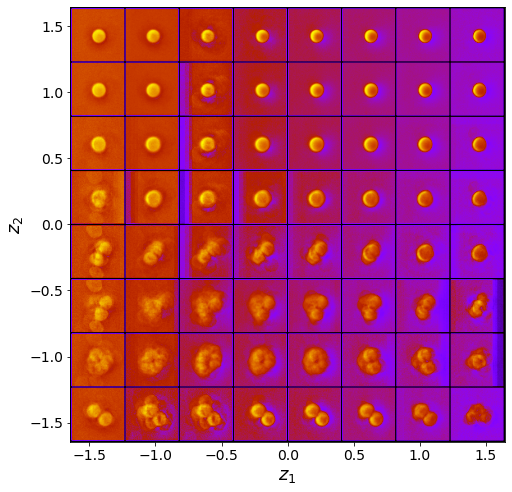

Epoch: 4601 Training loss: 970.3368
Epoch: 4602 Training loss: 970.2019
Epoch: 4603 Training loss: 969.7415
Epoch: 4604 Training loss: 969.8290
Epoch: 4605 Training loss: 969.6744
Epoch: 4606 Training loss: 969.7878
Epoch: 4607 Training loss: 969.7307
Epoch: 4608 Training loss: 969.7880
Epoch: 4609 Training loss: 969.9666
Epoch: 4610 Training loss: 969.9452
Epoch: 4611 Training loss: 969.5904
Epoch: 4612 Training loss: 969.7795
Epoch: 4613 Training loss: 969.8130
Epoch: 4614 Training loss: 969.6354
Epoch: 4615 Training loss: 969.6965
Epoch: 4616 Training loss: 969.5339
Epoch: 4617 Training loss: 969.5674
Epoch: 4618 Training loss: 969.6207
Epoch: 4619 Training loss: 969.4491
Epoch: 4620 Training loss: 969.5873
Epoch: 4621 Training loss: 969.5550
Epoch: 4622 Training loss: 969.5308
Epoch: 4623 Training loss: 969.6195
Epoch: 4624 Training loss: 969.8351
Epoch: 4625 Training loss: 969.5654
Epoch: 4626 Training loss: 969.5044
Epoch: 4627 Training loss: 969.4882
Epoch: 4628 Training loss: 9

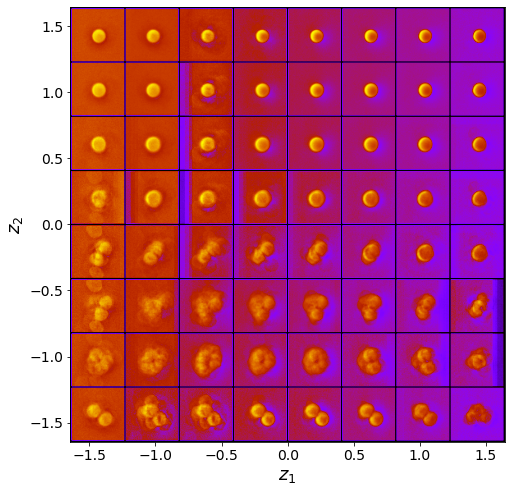

Epoch: 4651 Training loss: 969.7990
Epoch: 4652 Training loss: 969.5167
Epoch: 4653 Training loss: 969.3326
Epoch: 4654 Training loss: 969.5088
Epoch: 4655 Training loss: 969.8875
Epoch: 4656 Training loss: 970.4954
Epoch: 4657 Training loss: 970.0801
Epoch: 4658 Training loss: 970.1735
Epoch: 4659 Training loss: 970.1812
Epoch: 4660 Training loss: 970.1912
Epoch: 4661 Training loss: 969.6016
Epoch: 4662 Training loss: 969.6617
Epoch: 4663 Training loss: 969.6943
Epoch: 4664 Training loss: 969.5745
Epoch: 4665 Training loss: 969.3440
Epoch: 4666 Training loss: 969.3396
Epoch: 4667 Training loss: 969.3622
Epoch: 4668 Training loss: 969.8959
Epoch: 4669 Training loss: 969.9154
Epoch: 4670 Training loss: 969.5606
Epoch: 4671 Training loss: 969.4098
Epoch: 4672 Training loss: 969.3845
Epoch: 4673 Training loss: 969.3037
Epoch: 4674 Training loss: 969.5369
Epoch: 4675 Training loss: 969.6932
Epoch: 4676 Training loss: 969.2944
Epoch: 4677 Training loss: 969.2170
Epoch: 4678 Training loss: 9

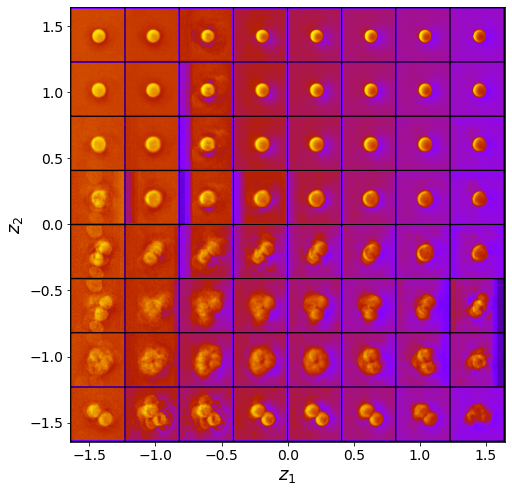

Epoch: 4701 Training loss: 969.3632
Epoch: 4702 Training loss: 969.3990
Epoch: 4703 Training loss: 969.2822
Epoch: 4704 Training loss: 969.1334
Epoch: 4705 Training loss: 969.1794
Epoch: 4706 Training loss: 969.2420
Epoch: 4707 Training loss: 969.3341
Epoch: 4708 Training loss: 969.3208
Epoch: 4709 Training loss: 969.2374
Epoch: 4710 Training loss: 969.4161
Epoch: 4711 Training loss: 969.4380
Epoch: 4712 Training loss: 969.3824
Epoch: 4713 Training loss: 969.2867
Epoch: 4714 Training loss: 969.3580
Epoch: 4715 Training loss: 969.2116
Epoch: 4716 Training loss: 969.3803
Epoch: 4717 Training loss: 969.2281
Epoch: 4718 Training loss: 969.6223
Epoch: 4719 Training loss: 969.4099
Epoch: 4720 Training loss: 969.5354
Epoch: 4721 Training loss: 969.6155
Epoch: 4722 Training loss: 969.5598
Epoch: 4723 Training loss: 969.3012
Epoch: 4724 Training loss: 969.3490
Epoch: 4725 Training loss: 969.1967
Epoch: 4726 Training loss: 969.1547
Epoch: 4727 Training loss: 969.0486
Epoch: 4728 Training loss: 9

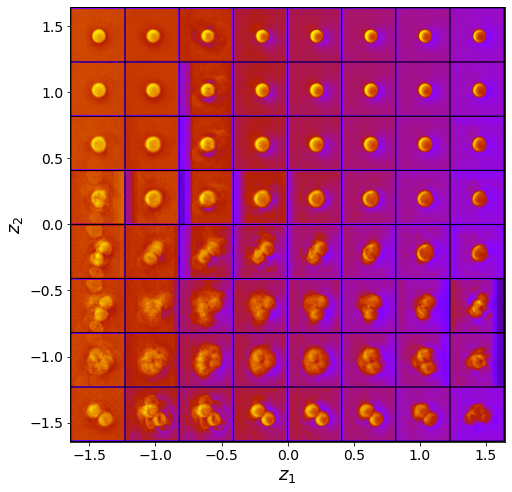

Epoch: 4751 Training loss: 970.2015
Epoch: 4752 Training loss: 969.4259
Epoch: 4753 Training loss: 969.4273
Epoch: 4754 Training loss: 969.1626
Epoch: 4755 Training loss: 969.1835
Epoch: 4756 Training loss: 969.4321
Epoch: 4757 Training loss: 969.9684
Epoch: 4758 Training loss: 970.5628
Epoch: 4759 Training loss: 970.2721
Epoch: 4760 Training loss: 969.3082
Epoch: 4761 Training loss: 969.4075
Epoch: 4762 Training loss: 969.7340
Epoch: 4763 Training loss: 969.3744
Epoch: 4764 Training loss: 969.2309
Epoch: 4765 Training loss: 969.1974
Epoch: 4766 Training loss: 969.2693
Epoch: 4767 Training loss: 969.2377
Epoch: 4768 Training loss: 969.6999
Epoch: 4769 Training loss: 969.5119
Epoch: 4770 Training loss: 969.3812
Epoch: 4771 Training loss: 969.1904
Epoch: 4772 Training loss: 969.0794
Epoch: 4773 Training loss: 969.0922
Epoch: 4774 Training loss: 969.1535
Epoch: 4775 Training loss: 969.5195
Epoch: 4776 Training loss: 969.2620
Epoch: 4777 Training loss: 969.1391
Epoch: 4778 Training loss: 9

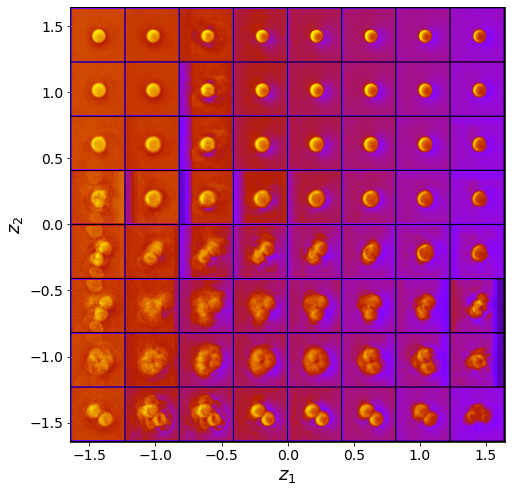

Epoch: 4801 Training loss: 969.4420
Epoch: 4802 Training loss: 969.3762
Epoch: 4803 Training loss: 969.2769
Epoch: 4804 Training loss: 969.2518
Epoch: 4805 Training loss: 969.4562
Epoch: 4806 Training loss: 969.5602
Epoch: 4807 Training loss: 969.2810
Epoch: 4808 Training loss: 969.2271
Epoch: 4809 Training loss: 969.1650
Epoch: 4810 Training loss: 969.1186
Epoch: 4811 Training loss: 969.3253
Epoch: 4812 Training loss: 969.2175
Epoch: 4813 Training loss: 969.3180
Epoch: 4814 Training loss: 969.3023
Epoch: 4815 Training loss: 969.0726
Epoch: 4816 Training loss: 968.8778
Epoch: 4817 Training loss: 969.3346
Epoch: 4818 Training loss: 969.2371
Epoch: 4819 Training loss: 969.2298
Epoch: 4820 Training loss: 969.1145
Epoch: 4821 Training loss: 969.1565
Epoch: 4822 Training loss: 968.9193
Epoch: 4823 Training loss: 969.2020
Epoch: 4824 Training loss: 969.2068
Epoch: 4825 Training loss: 970.0216
Epoch: 4826 Training loss: 969.8385
Epoch: 4827 Training loss: 969.9108
Epoch: 4828 Training loss: 9

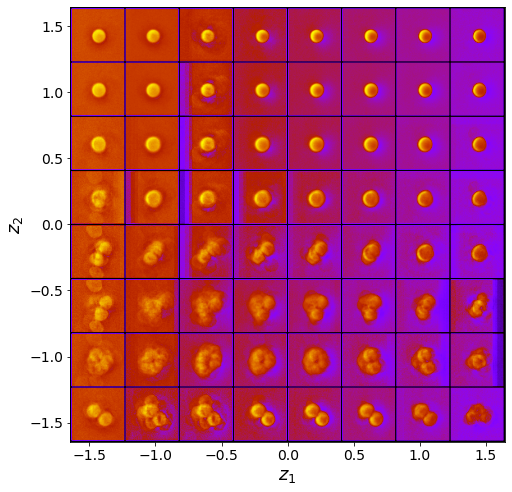

Epoch: 4851 Training loss: 969.2064
Epoch: 4852 Training loss: 969.4091
Epoch: 4853 Training loss: 969.3038
Epoch: 4854 Training loss: 969.3052
Epoch: 4855 Training loss: 969.2279
Epoch: 4856 Training loss: 969.2964
Epoch: 4857 Training loss: 969.5284
Epoch: 4858 Training loss: 969.0383
Epoch: 4859 Training loss: 968.8958
Epoch: 4860 Training loss: 969.0416
Epoch: 4861 Training loss: 969.4343
Epoch: 4862 Training loss: 970.1014
Epoch: 4863 Training loss: 970.8314
Epoch: 4864 Training loss: 971.9656
Epoch: 4865 Training loss: 971.8551
Epoch: 4866 Training loss: 969.5909
Epoch: 4867 Training loss: 969.1855
Epoch: 4868 Training loss: 969.1145
Epoch: 4869 Training loss: 969.2945
Epoch: 4870 Training loss: 969.0382
Epoch: 4871 Training loss: 969.0845
Epoch: 4872 Training loss: 968.9801
Epoch: 4873 Training loss: 968.9287
Epoch: 4874 Training loss: 969.0745
Epoch: 4875 Training loss: 969.1929
Epoch: 4876 Training loss: 968.9730
Epoch: 4877 Training loss: 968.9018
Epoch: 4878 Training loss: 9

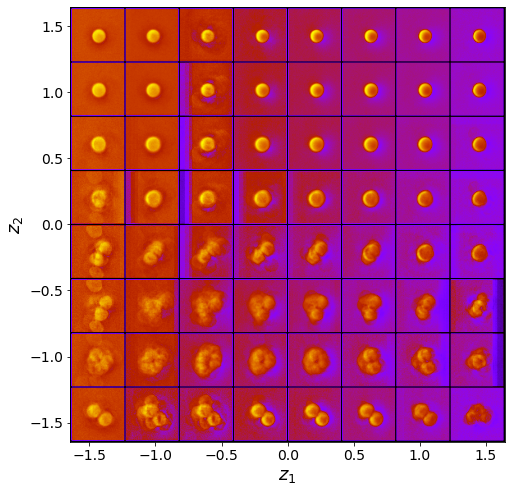

Epoch: 4901 Training loss: 969.0290
Epoch: 4902 Training loss: 969.3728
Epoch: 4903 Training loss: 969.3694
Epoch: 4904 Training loss: 969.2359
Epoch: 4905 Training loss: 969.2799
Epoch: 4906 Training loss: 969.7855
Epoch: 4907 Training loss: 969.3642
Epoch: 4908 Training loss: 969.1437
Epoch: 4909 Training loss: 968.9516
Epoch: 4910 Training loss: 968.8235
Epoch: 4911 Training loss: 968.9903
Epoch: 4912 Training loss: 968.8090
Epoch: 4913 Training loss: 969.3529
Epoch: 4914 Training loss: 969.3753
Epoch: 4915 Training loss: 968.9939
Epoch: 4916 Training loss: 969.0037
Epoch: 4917 Training loss: 969.3422
Epoch: 4918 Training loss: 969.3287
Epoch: 4919 Training loss: 969.5703
Epoch: 4920 Training loss: 969.0214
Epoch: 4921 Training loss: 968.8674
Epoch: 4922 Training loss: 969.0113
Epoch: 4923 Training loss: 968.7250
Epoch: 4924 Training loss: 968.7040
Epoch: 4925 Training loss: 968.7284
Epoch: 4926 Training loss: 968.8222
Epoch: 4927 Training loss: 969.1437
Epoch: 4928 Training loss: 9

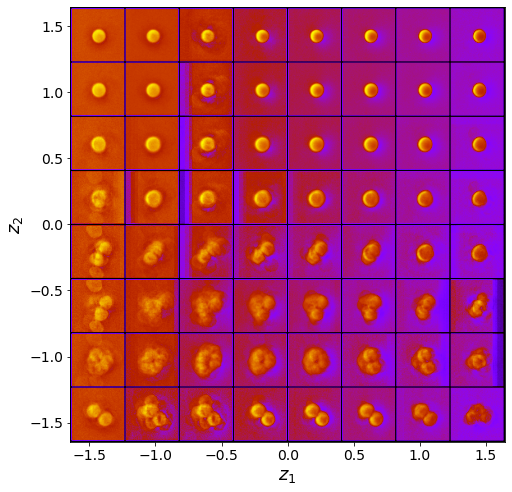

Epoch: 4951 Training loss: 968.7250
Epoch: 4952 Training loss: 969.1350
Epoch: 4953 Training loss: 969.0288
Epoch: 4954 Training loss: 969.0041
Epoch: 4955 Training loss: 968.8778
Epoch: 4956 Training loss: 968.8985
Epoch: 4957 Training loss: 968.8966
Epoch: 4958 Training loss: 968.6729
Epoch: 4959 Training loss: 968.7560
Epoch: 4960 Training loss: 968.6473
Epoch: 4961 Training loss: 968.6751
Epoch: 4962 Training loss: 968.7020
Epoch: 4963 Training loss: 969.0009
Epoch: 4964 Training loss: 968.8152
Epoch: 4965 Training loss: 968.7514
Epoch: 4966 Training loss: 968.6330
Epoch: 4967 Training loss: 968.9593
Epoch: 4968 Training loss: 968.8252
Epoch: 4969 Training loss: 969.2059
Epoch: 4970 Training loss: 969.0909
Epoch: 4971 Training loss: 969.1415
Epoch: 4972 Training loss: 968.8981
Epoch: 4973 Training loss: 968.8882
Epoch: 4974 Training loss: 968.7317
Epoch: 4975 Training loss: 968.6398
Epoch: 4976 Training loss: 968.6169
Epoch: 4977 Training loss: 968.6475
Epoch: 4978 Training loss: 9

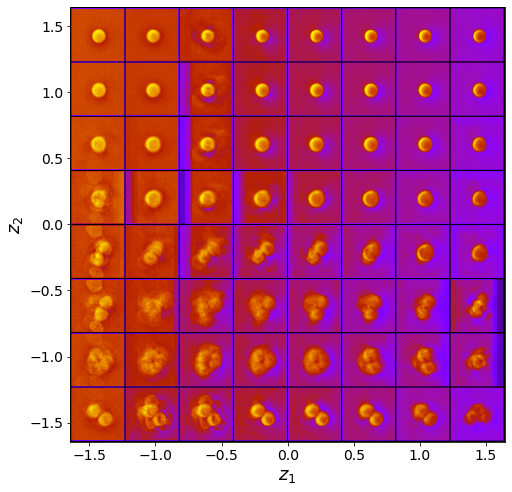

In [19]:
in_dim = (64, 64)

# Reinitialize dataloader
train_loader = pv.utils.init_dataloader(train_data, batch_size=64)

# Initialize model
vae = pv.models.trVAE(in_dim, latent_dim=2, coord=0,
                      sampler_d="gaussian")

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae, lr=1e-4)
# Train for n epochs:
for e in range(5000):
    trainer.step(train_loader)
    trainer.print_statistics()
    if (e+1) % 50 == 0:
        vae.manifold2d(8)

Visualize the learned latent manifold:

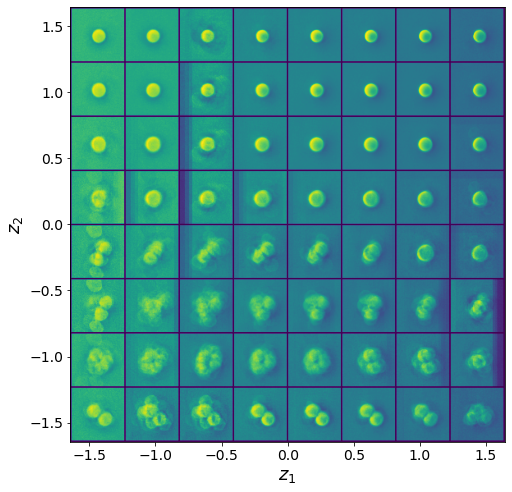

In [20]:
vae.manifold2d(d=8, cmap='viridis');

Encode all the data and view the encoded values as a scatter plot:

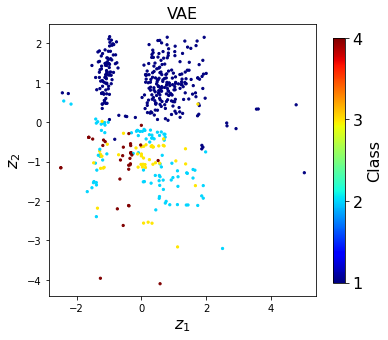

In [21]:
z_mean, z_sd = vae.encode(train_data)
labels = labels2

z_mean, z_sd = vae.encode(train_data)
fig, ax1 = plt.subplots( figsize =(6, 5))
im1 = ax1.scatter(z_mean[:,-1], z_mean[:,-2], c=labels, s=5, cmap='jet')
ax1.set_xlabel("$z_1$", fontsize=16)
ax1.set_ylabel("$z_2$", fontsize=16)
ax1.set_title('VAE', fontsize = 16)
cbar1 = fig.colorbar(im1, ax=ax1, ticks = [1, 2, 3, 4], shrink=.9)
cbar1.set_label("Class", fontsize=16)
cbar1.ax.tick_params( labelsize=16)

Now let's train VAE with rotational invariance (aka rVAE):

In [22]:
# Reinitialize dataloader
train_loader = pv.utils.init_dataloader(train_data, batch_size=20)

In [ ]:
in_dim = (64, 64)

# Reinitialize dataloader
train_loader = pv.utils.init_dataloader(train_data, batch_size=64)

# Initialize model
rvae = pv.models.trVAE(in_dim, latent_dim=2, coord=3, sampler_d="gaussian")

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(rvae, lr=1e-4)
# Train for n epochs:
for e in range(5000):
    trainer.step(train_loader)
    trainer.print_statistics()
    if (e+1) % 50 == 0:
        rvae.manifold2d(8)

Visualize the learned latent manifold:

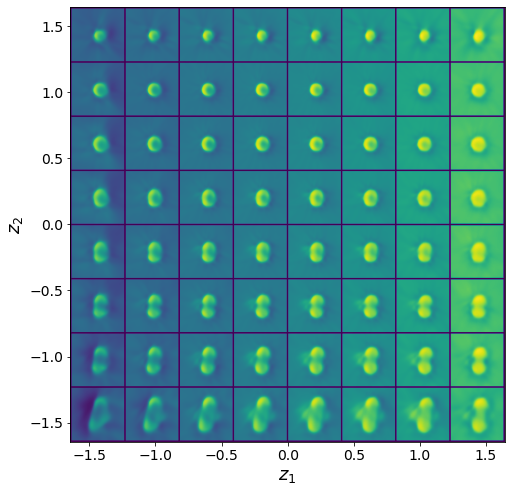

In [24]:
rvae.manifold2d(d=8, cmap='viridis');

Encode all the data and view the encoded values as a scatter plot:

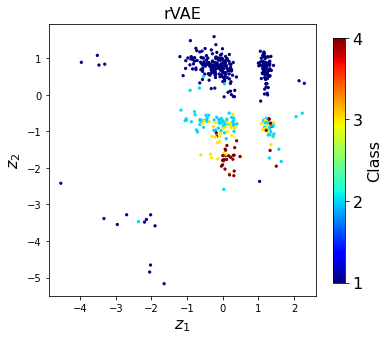

In [25]:
labels = labels2

z_mean, z_sd = rvae.encode(train_data)
fig, ax1 = plt.subplots( figsize =(6, 5))
im1 = ax1.scatter(z_mean[:,-1], z_mean[:,-2], c=labels, s=5, cmap='jet')
ax1.set_xlabel("$z_1$", fontsize=16)
ax1.set_ylabel("$z_2$", fontsize=16)
ax1.set_title('rVAE', fontsize = 16)
cbar1 = fig.colorbar(im1, ax=ax1, ticks = [1, 2, 3, 4], shrink=.9)
cbar1.set_label("Class", fontsize=16)
cbar1.ax.tick_params( labelsize=16)

# Class-conditioned rVAE 

Finally, we illustrate the class-conditioned rVAE (crVAE) applied to this data set. Note that the only two things we have to do is add labels to our data loader and specify number of classes when initializing the crVAE model - pyroVED will take care of the rest.

In [26]:
# Initialize dataloader (here we are adding labels to the training data)
train_labels = pv.utils.to_onehot(torch.tensor((labels2-1).astype(int)), 4)
print(train_data.shape, train_labels.shape)
train_loader = pv.utils.init_dataloader(train_data, train_labels, batch_size=20)
print(train_labels.shape, train_data.shape)

torch.Size([481, 64, 64]) torch.Size([481, 4])
torch.Size([481, 4]) torch.Size([481, 64, 64])


In [ ]:
in_dim = (64, 64)

#initialize model
crvae = pv.models.trVAE(in_dim, latent_dim=2, num_classes=4, sampler_d = 'gaussian', coord=1, seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(crvae, lr=1e-4)
# Train for n epochs:
for e in range(1000):
    trainer.step(train_loader, scale_factor=3)
    trainer.print_statistics()
    if (e+1) % 50 == 0:
      for i in range(4):
        crvae.manifold2d(d=12, label=i, cmap="viridis")

View the learned latent manifold for each class:

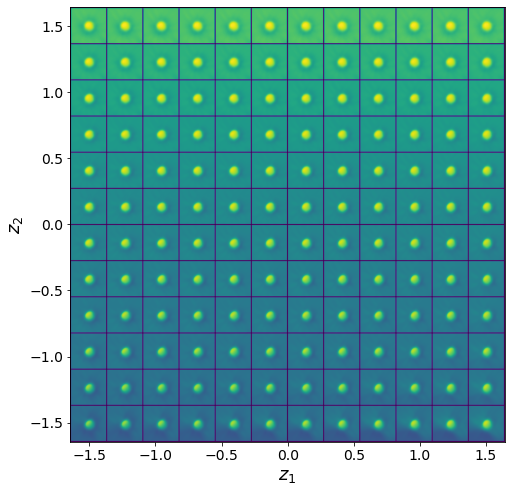

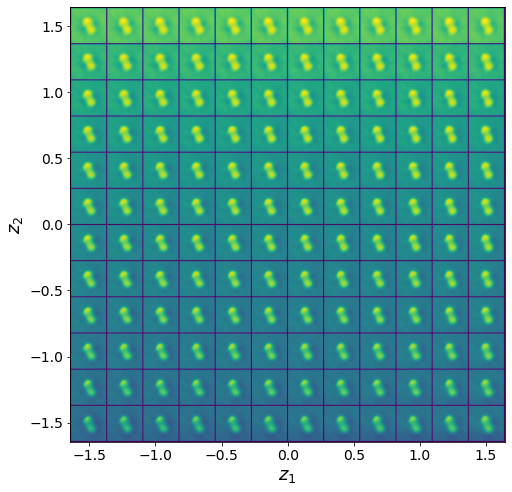

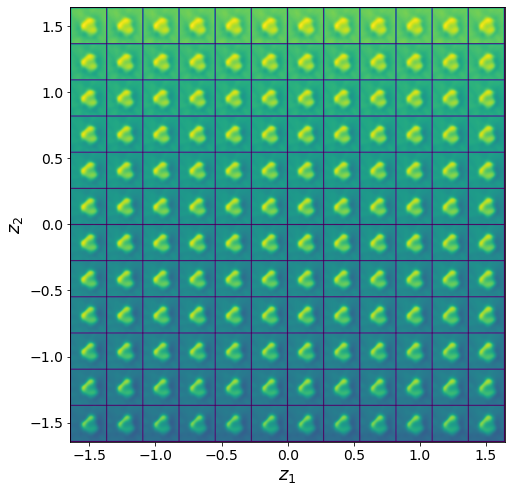

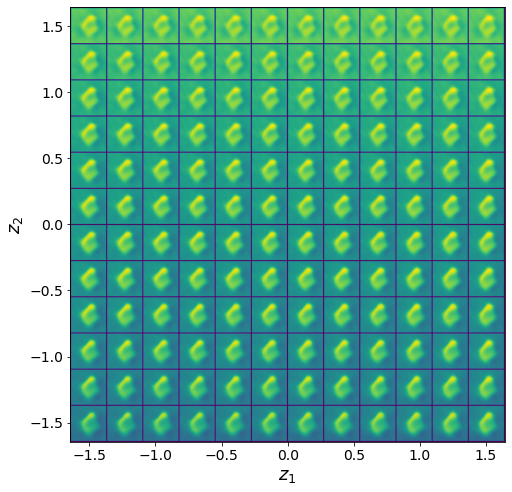

In [28]:
for i in range(4):
    crvae.manifold2d(d=12, label=i, cmap="viridis")